In [2]:
import pytorch_lightning
from monai.utils import set_determinism
from monai.transforms import (
    AsDiscrete,
    EnsureChannelFirstd,
    Compose,
    CropForegroundd,
    LoadImaged,
    Orientationd,
    RandCropByPosNegLabeld,
    ScaleIntensityRanged,
    Spacingd,
    EnsureType,
    DivisiblePadd,
    ScaleIntensityd,
    RandRotated,
    BatchInverseTransform
)
from monai.networks.nets import UNet
from monai.networks.layers import Norm
from monai.metrics import DiceMetric
from monai.losses import DiceLoss
from monai.inferers import sliding_window_inference, SimpleInferer
from monai.data import CacheDataset, Dataset, list_data_collate, decollate_batch, DataLoader
from monai.data.utils import pad_list_data_collate
from monai.config import print_config
from monai.apps import download_and_extract
import torch
import matplotlib.pyplot as plt
import tempfile
import shutil
import os
import glob
import numpy as np
from tqdm.notebook import tqdm_notebook
import torch.nn.functional as Fun
import nibabel as nib
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning.loggers import TensorBoardLogger
from monai.transforms.utils import allow_missing_keys_mode
from monai.utils import first
print_config()

MONAI version: 1.0.0
Numpy version: 1.23.1
Pytorch version: 1.12.1
MONAI flags: HAS_EXT = False, USE_COMPILED = False, USE_META_DICT = False
MONAI rev id: 170093375ce29267e45681fcec09dfa856e1d7e7
MONAI __file__: C:\Users\nehag\anaconda3\envs\research\lib\site-packages\monai\__init__.py

Optional dependencies:
Pytorch Ignite version: NOT INSTALLED or UNKNOWN VERSION.
Nibabel version: 4.0.2
scikit-image version: NOT INSTALLED or UNKNOWN VERSION.
Pillow version: 9.2.0
Tensorboard version: 2.10.1
gdown version: NOT INSTALLED or UNKNOWN VERSION.
TorchVision version: NOT INSTALLED or UNKNOWN VERSION.
tqdm version: 4.64.1
lmdb version: NOT INSTALLED or UNKNOWN VERSION.
psutil version: 5.9.0
pandas version: 1.4.4
einops version: NOT INSTALLED or UNKNOWN VERSION.
transformers version: NOT INSTALLED or UNKNOWN VERSION.
mlflow version: NOT INSTALLED or UNKNOWN VERSION.
pynrrd version: NOT INSTALLED or UNKNOWN VERSION.

For details about installing the optional dependencies, please visit:
    http

In [3]:
directory = os.environ.get("MONAI_DATA_DIRECTORY")
root_dir = tempfile.mkdtemp() if directory is None else directory
root_dir = "C:\\Users\\nehag\\train_seg_results\\"
print(root_dir)

C:\Users\nehag\train_seg_results\


In [4]:
class Net(pytorch_lightning.LightningModule):
    def __init__(self):
        super().__init__()
        self._model = UNet(
            spatial_dims=3,
            in_channels=1,
            out_channels=2,
            channels=(16, 32, 64, 128, 256),
            strides=(2, 2, 2, 2),
            num_res_units=2,
            norm=Norm.BATCH,
        )
        self.loss_function = DiceLoss(to_onehot_y=True, softmax=True)
        self.post_pred = Compose([EnsureType("tensor", device="cpu"), AsDiscrete(argmax=True, to_onehot=2)])
        self.post_label = Compose([EnsureType("tensor", device="cpu"), AsDiscrete(to_onehot=2)])
        self.dice_metric = DiceMetric(include_background=False, reduction="mean", get_not_nans=False)
        self.best_val_dice = 0
        self.best_val_epoch = 0

    def forward(self, x):
        return self._model(x)

    def prepare_data(self):
        # set up the correct data path
        imgs_list_train = glob.glob(r"C:\\Users\\nehag\\Downloads\\T1W original\\train\\*.nii.gz")
        labels_train = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\train\\*.nii.gz")

        train_files = [{"img": x, "label": y} for (x,y) in zip(imgs_list_train,labels_train)]

        imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Downloads\\T1W original\\val\\*.nii.gz")
        labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\val\\*.nii.gz")
        
        val_files = [{"img": x, "label": y} for (x,y) in zip(imgs_list_val,labels_val)]
       

        # set deterministic training for reproducibility
        set_determinism(seed=0)

        # define the data transforms
        train_transforms = Compose(
            [
                LoadImaged(keys=["img", "label"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img", "label"]),
                DivisiblePadd(["img", "label"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                RandRotated(
                    keys=["img", "label"],
                    range_x=np.pi / 4,
                    prob=0.5,
                    keep_size=True,
                    mode="nearest"
                )
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
        val_transforms = Compose(
            [
                LoadImaged(keys=["img", "label"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img", "label"]),
                DivisiblePadd(["img", "label"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                RandRotated(
                    keys=["img", "label"],
                    range_x=np.pi / 4,
                    prob=0.5,
                    keep_size=True,
                    mode="nearest"
                )
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )

        # we use cached datasets - these are 10x faster than regular datasets
        self.train_ds = Dataset(
            data=train_files, transform=train_transforms
        )
        self.val_ds = Dataset(
            data=val_files, transform=val_transforms
        )
#         self.train_ds = monai.data.Dataset(
#             data=train_files, transform=train_transforms)
#         self.val_ds = monai.data.Dataset(
#             data=val_files, transform=val_transforms)

    def train_dataloader(self):
        train_loader = DataLoader(
            self.train_ds, batch_size=1, shuffle=True,
            num_workers=2, collate_fn=pad_list_data_collate,
        )
        return train_loader

    def val_dataloader(self):
        val_loader = DataLoader(
            self.val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)
        return val_loader

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self._model.parameters(), 5e-5)
        return optimizer

    def training_step(self, batch, batch_idx):
        images, labels = batch["img"], batch["label"]
        output = self.forward(images)
        loss = self.loss_function(output, labels)
        tensorboard_logs = {"train_loss": loss.item()}
        return {"loss": loss, "log": tensorboard_logs}

    def validation_step(self, batch, batch_idx):
        images, labels = batch["img"], batch["label"]
        roi_size = (160, 160, 160)
        sw_batch_size = 2
        inferer = SimpleInferer()
        #outputs = sliding_window_inference(
            #images, roi_size, sw_batch_size, self.forward)
        outputs = inferer(inputs=images, network=self._model)
        loss = self.loss_function(outputs, labels)
        outputs = [self.post_pred(i) for i in decollate_batch(outputs)]
        labels = [self.post_label(i) for i in decollate_batch(labels)]
        self.dice_metric(y_pred=outputs, y=labels)
        return {"val_loss": loss, "val_number": len(outputs)}

    def validation_epoch_end(self, outputs):
        val_loss, num_items = 0, 0
        for output in outputs:
            val_loss += output["val_loss"].sum().item()
            num_items += output["val_number"]
        mean_val_dice = self.dice_metric.aggregate().item()
        self.dice_metric.reset()
        mean_val_loss = torch.tensor(val_loss / num_items)
        tensorboard_logs = {
            "val_dice": mean_val_dice,
            "val_loss": mean_val_loss,
        }
        if mean_val_dice > self.best_val_dice:
            self.best_val_dice = mean_val_dice
            self.best_val_epoch = self.current_epoch
        print(
            f"current epoch: {self.current_epoch} "
            f"current mean dice: {mean_val_dice:.4f}"
            f"\nbest mean dice: {self.best_val_dice:.4f} "
            f"at epoch: {self.best_val_epoch}"
        )
        return {"log": tensorboard_logs}

In [4]:
net = Net()

# set up loggers and checkpoints
log_dir = os.path.join(root_dir, "skull_stripping_logs2")
tb_logger = pytorch_lightning.loggers.TensorBoardLogger(
    save_dir=log_dir
)
#callbacks=ModelCheckpoint(dirpath=log_dir+'\\', filename="skull_stripping_{epoch:02d}_{dice_metric:.2f}",)
# initialise Lightning's trainer.
trainer = pytorch_lightning.Trainer(
    gpus=[0],
    max_epochs=15,
    logger=tb_logger,
    enable_checkpointing=True,
    num_sanity_val_steps=1,
    log_every_n_steps=16

)

# train
trainer.fit(net)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Missing logger folder: C:\Users\nehag\train_seg_results\skull_stripping_logs2\default

  | Name          | Type     | Params
-------------------------------------------
0 | _model        | UNet     | 4.8 M 
1 | loss_function | DiceLoss | 0     
-------------------------------------------
4.8 M     Trainable params
0         Non-trainable params
4.8 M     Total params
19.236    Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

C:\Users\nehag\anaconda3\envs\research\lib\site-packages\pytorch_lightning\trainer\data_loading.py:132: UserWarning: The dataloader, val_dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 24 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


current epoch: 0 current mean dice: 0.1615
best mean dice: 0.1615 at epoch: 0


C:\Users\nehag\anaconda3\envs\research\lib\site-packages\pytorch_lightning\trainer\data_loading.py:132: UserWarning: The dataloader, train_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 24 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

current epoch: 0 current mean dice: 0.7987
best mean dice: 0.7987 at epoch: 0


Validating: 0it [00:00, ?it/s]

current epoch: 1 current mean dice: 0.6681
best mean dice: 0.7987 at epoch: 0


Validating: 0it [00:00, ?it/s]

current epoch: 2 current mean dice: 0.2884
best mean dice: 0.7987 at epoch: 0


Validating: 0it [00:00, ?it/s]

current epoch: 3 current mean dice: 0.5672
best mean dice: 0.7987 at epoch: 0


Validating: 0it [00:00, ?it/s]

current epoch: 4 current mean dice: 0.8581
best mean dice: 0.8581 at epoch: 4


Validating: 0it [00:00, ?it/s]

current epoch: 5 current mean dice: 0.7505
best mean dice: 0.8581 at epoch: 4


Validating: 0it [00:00, ?it/s]

current epoch: 6 current mean dice: 0.8829
best mean dice: 0.8829 at epoch: 6


Validating: 0it [00:00, ?it/s]

current epoch: 7 current mean dice: 0.9110
best mean dice: 0.9110 at epoch: 7


Validating: 0it [00:00, ?it/s]

current epoch: 8 current mean dice: 0.9518
best mean dice: 0.9518 at epoch: 8


Validating: 0it [00:00, ?it/s]

current epoch: 9 current mean dice: 0.8873
best mean dice: 0.9518 at epoch: 8


Validating: 0it [00:00, ?it/s]

current epoch: 10 current mean dice: 0.8291
best mean dice: 0.9518 at epoch: 8


Validating: 0it [00:00, ?it/s]

current epoch: 11 current mean dice: 0.8063
best mean dice: 0.9518 at epoch: 8


Validating: 0it [00:00, ?it/s]

current epoch: 12 current mean dice: 0.8482
best mean dice: 0.9518 at epoch: 8


Validating: 0it [00:00, ?it/s]

current epoch: 13 current mean dice: 0.9291
best mean dice: 0.9518 at epoch: 8


Validating: 0it [00:00, ?it/s]

current epoch: 14 current mean dice: 0.9552
best mean dice: 0.9552 at epoch: 14


In [5]:
print(
    f"train completed, best_metric: {net.best_val_dice:.4f} "
    f"at epoch {net.best_val_epoch}")

train completed, best_metric: 0.9552 at epoch 14


In [22]:
net = Net()

# set up loggers and checkpoints
log_dir = os.path.join(root_dir, "skull_stripping_logs3")
#tb_logger = pytorch_lightning.loggers.TensorBoardLogger(
    #save_dir=log_dir
#)
#callbacks=ModelCheckpoint(dirpath=log_dir+'\\', filename="skull_stripping_{epoch:02d}_{dice_metric:.2f}",)
# initialise Lightning's trainer.
logger = TensorBoardLogger(save_dir=log_dir, version=1, name="lightning_logs_3")
#Trainer(logger=logger)
trainer = pytorch_lightning.Trainer(
    gpus=[0],
    max_epochs=20,
    logger=logger,
    enable_checkpointing=True,
    num_sanity_val_steps=1,
    log_every_n_steps=16

)

# train
trainer.fit(net)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type     | Params
-------------------------------------------
0 | _model        | UNet     | 4.8 M 
1 | loss_function | DiceLoss | 0     
-------------------------------------------
4.8 M     Trainable params
0         Non-trainable params
4.8 M     Total params
19.236    Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

current epoch: 0 current mean dice: 0.1408
best mean dice: 0.1408 at epoch: 0


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

current epoch: 0 current mean dice: 0.9083
best mean dice: 0.9083 at epoch: 0


Validating: 0it [00:00, ?it/s]

current epoch: 1 current mean dice: 0.8813
best mean dice: 0.9083 at epoch: 0


Validating: 0it [00:00, ?it/s]

current epoch: 2 current mean dice: 0.8570
best mean dice: 0.9083 at epoch: 0


Validating: 0it [00:00, ?it/s]

current epoch: 3 current mean dice: 0.8542
best mean dice: 0.9083 at epoch: 0


Validating: 0it [00:00, ?it/s]

current epoch: 4 current mean dice: 0.9302
best mean dice: 0.9302 at epoch: 4


Validating: 0it [00:00, ?it/s]

current epoch: 5 current mean dice: 0.9276
best mean dice: 0.9302 at epoch: 4


Validating: 0it [00:00, ?it/s]

current epoch: 6 current mean dice: 0.0142
best mean dice: 0.9302 at epoch: 4


Validating: 0it [00:00, ?it/s]

current epoch: 7 current mean dice: 0.9487
best mean dice: 0.9487 at epoch: 7


Validating: 0it [00:00, ?it/s]

current epoch: 8 current mean dice: 0.9617
best mean dice: 0.9617 at epoch: 8


Validating: 0it [00:00, ?it/s]

current epoch: 9 current mean dice: 0.9741
best mean dice: 0.9741 at epoch: 9


Validating: 0it [00:00, ?it/s]

current epoch: 10 current mean dice: 0.9754
best mean dice: 0.9754 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 11 current mean dice: 0.9295
best mean dice: 0.9754 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 12 current mean dice: 0.9637
best mean dice: 0.9754 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 13 current mean dice: 0.9729
best mean dice: 0.9754 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 14 current mean dice: 0.1539
best mean dice: 0.9754 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 15 current mean dice: 0.9436
best mean dice: 0.9754 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 16 current mean dice: 0.9396
best mean dice: 0.9754 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 17 current mean dice: 0.1535
best mean dice: 0.9754 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 18 current mean dice: 0.9566
best mean dice: 0.9754 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 19 current mean dice: 0.9477
best mean dice: 0.9754 at epoch: 10


In [23]:
print(
    f"train completed, best_metric: {net.best_val_dice:.4f} "
    f"at epoch {net.best_val_epoch}")

train completed, best_metric: 0.9754 at epoch 10


In [6]:
net = Net()

# set up loggers and checkpoints
log_dir = os.path.join(root_dir, "skull_stripping_logs4")
#tb_logger = pytorch_lightning.loggers.TensorBoardLogger(
    #save_dir=log_dir
#)
#callbacks=ModelCheckpoint(dirpath=log_dir+'\\', filename="skull_stripping_{epoch:02d}_{dice_metric:.2f}",)
# initialise Lightning's trainer.
logger = TensorBoardLogger(save_dir=log_dir, version=1, name="lightning_logs_4")
#Trainer(logger=logger)
trainer = pytorch_lightning.Trainer(
    gpus=[0],
    max_epochs=25,
    logger=logger,
    enable_checkpointing=True,
    num_sanity_val_steps=1,
    log_every_n_steps=16

)

# train
trainer.fit(net)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type     | Params
-------------------------------------------
0 | _model        | UNet     | 4.8 M 
1 | loss_function | DiceLoss | 0     
-------------------------------------------
4.8 M     Trainable params
0         Non-trainable params
4.8 M     Total params
19.236    Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

C:\Users\nehag\anaconda3\envs\research\lib\site-packages\pytorch_lightning\trainer\data_loading.py:132: UserWarning: The dataloader, val_dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 24 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


current epoch: 0 current mean dice: 0.1291
best mean dice: 0.1291 at epoch: 0


C:\Users\nehag\anaconda3\envs\research\lib\site-packages\pytorch_lightning\trainer\data_loading.py:132: UserWarning: The dataloader, train_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 24 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

current epoch: 0 current mean dice: 0.9337
best mean dice: 0.9337 at epoch: 0


Validating: 0it [00:00, ?it/s]

current epoch: 1 current mean dice: 0.9564
best mean dice: 0.9564 at epoch: 1


Validating: 0it [00:00, ?it/s]

current epoch: 2 current mean dice: 0.8968
best mean dice: 0.9564 at epoch: 1


Validating: 0it [00:00, ?it/s]

current epoch: 3 current mean dice: 0.9518
best mean dice: 0.9564 at epoch: 1


Validating: 0it [00:00, ?it/s]

current epoch: 4 current mean dice: 0.9604
best mean dice: 0.9604 at epoch: 4


Validating: 0it [00:00, ?it/s]

current epoch: 5 current mean dice: 0.9716
best mean dice: 0.9716 at epoch: 5


Validating: 0it [00:00, ?it/s]

current epoch: 6 current mean dice: 0.6980
best mean dice: 0.9716 at epoch: 5


Validating: 0it [00:00, ?it/s]

current epoch: 7 current mean dice: 0.9717
best mean dice: 0.9717 at epoch: 7


Validating: 0it [00:00, ?it/s]

current epoch: 8 current mean dice: 0.9759
best mean dice: 0.9759 at epoch: 8


Validating: 0it [00:00, ?it/s]

current epoch: 9 current mean dice: 0.9803
best mean dice: 0.9803 at epoch: 9


Validating: 0it [00:00, ?it/s]

current epoch: 10 current mean dice: 0.9816
best mean dice: 0.9816 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 11 current mean dice: 0.9763
best mean dice: 0.9816 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 12 current mean dice: 0.9732
best mean dice: 0.9816 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 13 current mean dice: 0.9828
best mean dice: 0.9828 at epoch: 13


Validating: 0it [00:00, ?it/s]

current epoch: 14 current mean dice: 0.9785
best mean dice: 0.9828 at epoch: 13


Validating: 0it [00:00, ?it/s]

current epoch: 15 current mean dice: 0.9828
best mean dice: 0.9828 at epoch: 15


Validating: 0it [00:00, ?it/s]

current epoch: 16 current mean dice: 0.9745
best mean dice: 0.9828 at epoch: 15


Validating: 0it [00:00, ?it/s]

current epoch: 17 current mean dice: 0.9823
best mean dice: 0.9828 at epoch: 15


Validating: 0it [00:00, ?it/s]

current epoch: 18 current mean dice: 0.9802
best mean dice: 0.9828 at epoch: 15


Validating: 0it [00:00, ?it/s]

current epoch: 19 current mean dice: 0.9668
best mean dice: 0.9828 at epoch: 15


Validating: 0it [00:00, ?it/s]

current epoch: 20 current mean dice: 0.9792
best mean dice: 0.9828 at epoch: 15


Validating: 0it [00:00, ?it/s]

current epoch: 21 current mean dice: 0.9848
best mean dice: 0.9848 at epoch: 21


Validating: 0it [00:00, ?it/s]

current epoch: 22 current mean dice: 0.9852
best mean dice: 0.9852 at epoch: 22


Validating: 0it [00:00, ?it/s]

current epoch: 23 current mean dice: 0.9865
best mean dice: 0.9865 at epoch: 23


Validating: 0it [00:00, ?it/s]

current epoch: 24 current mean dice: 0.9847
best mean dice: 0.9865 at epoch: 23


In [5]:
net = Net()

# set up loggers and checkpoints
log_dir = os.path.join(root_dir, "skull_stripping_logs5")
#tb_logger = pytorch_lightning.loggers.TensorBoardLogger(
    #save_dir=log_dir
#)
#callbacks=ModelCheckpoint(dirpath=log_dir+'\\', filename="skull_stripping_{epoch:02d}_{dice_metric:.2f}",)
# initialise Lightning's trainer.
logger = TensorBoardLogger(save_dir=log_dir, version=1, name="lightning_logs_4")
#Trainer(logger=logger)
trainer = pytorch_lightning.Trainer(
    gpus=[0],
    max_epochs=30,
    logger=logger,
    enable_checkpointing=True,
    num_sanity_val_steps=1,
    log_every_n_steps=16

)

# train
trainer.fit(net)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type     | Params
-------------------------------------------
0 | _model        | UNet     | 4.8 M 
1 | loss_function | DiceLoss | 0     
-------------------------------------------
4.8 M     Trainable params
0         Non-trainable params
4.8 M     Total params
19.236    Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

C:\Users\nehag\anaconda3\envs\research\lib\site-packages\pytorch_lightning\trainer\data_loading.py:132: UserWarning: The dataloader, val_dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 24 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


current epoch: 0 current mean dice: 0.1655
best mean dice: 0.1655 at epoch: 0


C:\Users\nehag\anaconda3\envs\research\lib\site-packages\pytorch_lightning\trainer\data_loading.py:132: UserWarning: The dataloader, train_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 24 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


Training: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

current epoch: 0 current mean dice: 0.8711
best mean dice: 0.8711 at epoch: 0


Validating: 0it [00:00, ?it/s]

current epoch: 1 current mean dice: 0.9240
best mean dice: 0.9240 at epoch: 1


Validating: 0it [00:00, ?it/s]

current epoch: 2 current mean dice: 0.9000
best mean dice: 0.9240 at epoch: 1


Validating: 0it [00:00, ?it/s]

current epoch: 3 current mean dice: 0.9618
best mean dice: 0.9618 at epoch: 3


Validating: 0it [00:00, ?it/s]

current epoch: 4 current mean dice: 0.9665
best mean dice: 0.9665 at epoch: 4


Validating: 0it [00:00, ?it/s]

current epoch: 5 current mean dice: 0.9679
best mean dice: 0.9679 at epoch: 5


Validating: 0it [00:00, ?it/s]

current epoch: 6 current mean dice: 0.9274
best mean dice: 0.9679 at epoch: 5


Validating: 0it [00:00, ?it/s]

current epoch: 7 current mean dice: 0.9650
best mean dice: 0.9679 at epoch: 5


Validating: 0it [00:00, ?it/s]

current epoch: 8 current mean dice: 0.9659
best mean dice: 0.9679 at epoch: 5


Validating: 0it [00:00, ?it/s]

current epoch: 9 current mean dice: 0.9733
best mean dice: 0.9733 at epoch: 9


Validating: 0it [00:00, ?it/s]

current epoch: 10 current mean dice: 0.9761
best mean dice: 0.9761 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 11 current mean dice: 0.9587
best mean dice: 0.9761 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 12 current mean dice: 0.9707
best mean dice: 0.9761 at epoch: 10


Validating: 0it [00:00, ?it/s]

current epoch: 13 current mean dice: 0.9790
best mean dice: 0.9790 at epoch: 13


Validating: 0it [00:00, ?it/s]

current epoch: 14 current mean dice: 0.9714
best mean dice: 0.9790 at epoch: 13


Validating: 0it [00:00, ?it/s]

current epoch: 15 current mean dice: 0.9789
best mean dice: 0.9790 at epoch: 13


Validating: 0it [00:00, ?it/s]

current epoch: 16 current mean dice: 0.9753
best mean dice: 0.9790 at epoch: 13


Validating: 0it [00:00, ?it/s]

current epoch: 17 current mean dice: 0.9687
best mean dice: 0.9790 at epoch: 13


Validating: 0it [00:00, ?it/s]

current epoch: 18 current mean dice: 0.9779
best mean dice: 0.9790 at epoch: 13


Validating: 0it [00:00, ?it/s]

current epoch: 19 current mean dice: 0.9703
best mean dice: 0.9790 at epoch: 13


Validating: 0it [00:00, ?it/s]

current epoch: 20 current mean dice: 0.9761
best mean dice: 0.9790 at epoch: 13


Validating: 0it [00:00, ?it/s]

current epoch: 21 current mean dice: 0.9825
best mean dice: 0.9825 at epoch: 21


Validating: 0it [00:00, ?it/s]

current epoch: 22 current mean dice: 0.9818
best mean dice: 0.9825 at epoch: 21


Validating: 0it [00:00, ?it/s]

current epoch: 23 current mean dice: 0.9830
best mean dice: 0.9830 at epoch: 23


Validating: 0it [00:00, ?it/s]

current epoch: 24 current mean dice: 0.9817
best mean dice: 0.9830 at epoch: 23


Validating: 0it [00:00, ?it/s]

current epoch: 25 current mean dice: 0.9834
best mean dice: 0.9834 at epoch: 25


Validating: 0it [00:00, ?it/s]

current epoch: 26 current mean dice: 0.9832
best mean dice: 0.9834 at epoch: 25


Validating: 0it [00:00, ?it/s]

current epoch: 27 current mean dice: 0.9631
best mean dice: 0.9834 at epoch: 25


Validating: 0it [00:00, ?it/s]

current epoch: 28 current mean dice: 0.9802
best mean dice: 0.9834 at epoch: 25


Validating: 0it [00:00, ?it/s]

current epoch: 29 current mean dice: 0.9815
best mean dice: 0.9834 at epoch: 25


# TESTING ON VAL SET

In [4]:
#7 NOV model
net = Net.load_from_checkpoint(r"C:\Users\nehag\train_seg_results\skull_stripping_logs3\lightning_logs_3\version_1\checkpoints\epoch=19-step=4759.ckpt")

In [6]:
imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Downloads\\T1W original\\val\\*.nii.gz")
labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\val\\*.nii.gz")
val_files = [{"img": x, "label": y} for (x,y) in zip(imgs_list_val,labels_val)]
val_transforms = Compose(
            [
                LoadImaged(keys=["img", "label"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img", "label"]),
                DivisiblePadd(["img", "label"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img", "label"],
                    minv=0.0,
                    maxv=1.0
                ),
                RandRotated(
                    keys=["img", "label"],
                    range_x=np.pi / 4,
                    prob=0.5,
                    keep_size=True,
                    mode="nearest"
                )
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=val_transforms)
val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

(1, 1, 224, 256, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0226_siemens_3_64_F.nii.gz']
CC0226_siemens_3_64_F.nii.gz


C:\Users\nehag\anaconda3\envs\research\lib\site-packages\monai\metrics\utils.py:219: UserWarning: y_pred should be a binarized tensor.
  warnings.warn(f"{name} should be a binarized tensor.")


tensor([[0.9988, 0.9844]])
0.9916077852249146
(1, 224, 256, 256)


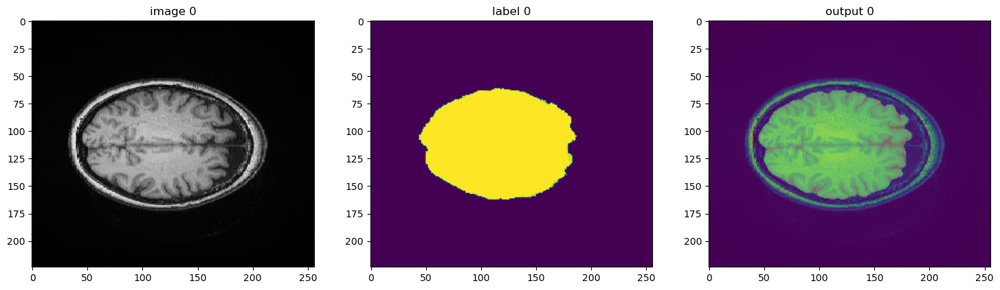

(1, 1, 224, 256, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0229_siemens_3_55_F.nii.gz']
CC0229_siemens_3_55_F.nii.gz
tensor([[0.9988, 0.9842]])
0.9915702939033508
(1, 224, 256, 256)


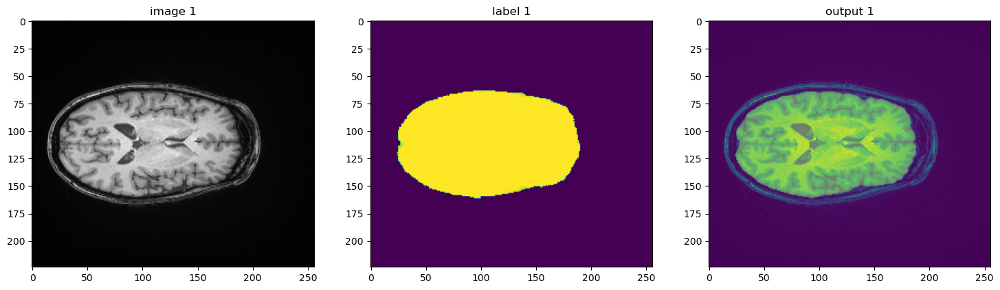

(1, 1, 224, 256, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0237_siemens_3_59_F.nii.gz']
CC0237_siemens_3_59_F.nii.gz
tensor([[0.9989, 0.9845]])
0.9916033148765564
(1, 224, 256, 256)


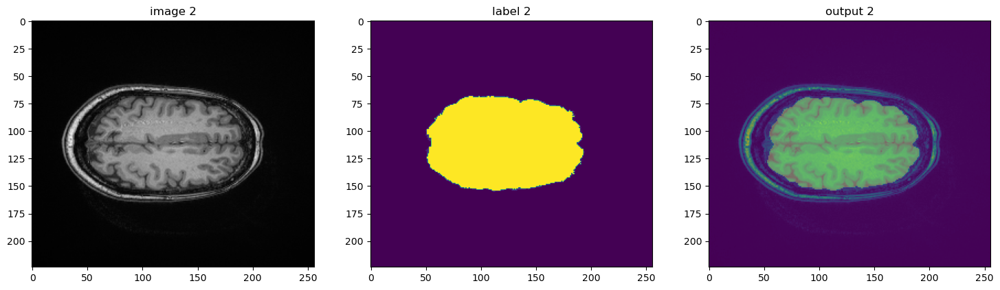

(1, 1, 256, 208, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0240_ge_15_60_F.nii.gz']
CC0240_ge_15_60_F.nii.gz
tensor([[0.9987, 0.9871]])
0.9919182658195496
(1, 256, 208, 256)


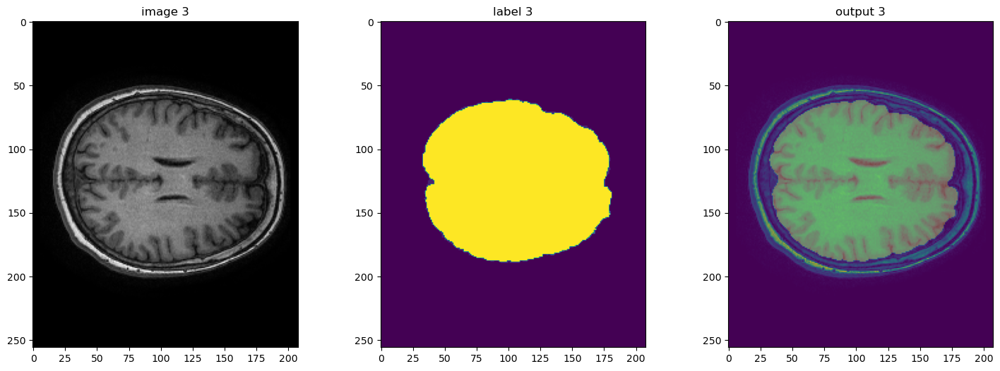

(1, 1, 256, 208, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0241_ge_15_60_F.nii.gz']
CC0241_ge_15_60_F.nii.gz
tensor([[0.9965, 0.9656]])
0.9897440075874329
(1, 256, 208, 256)


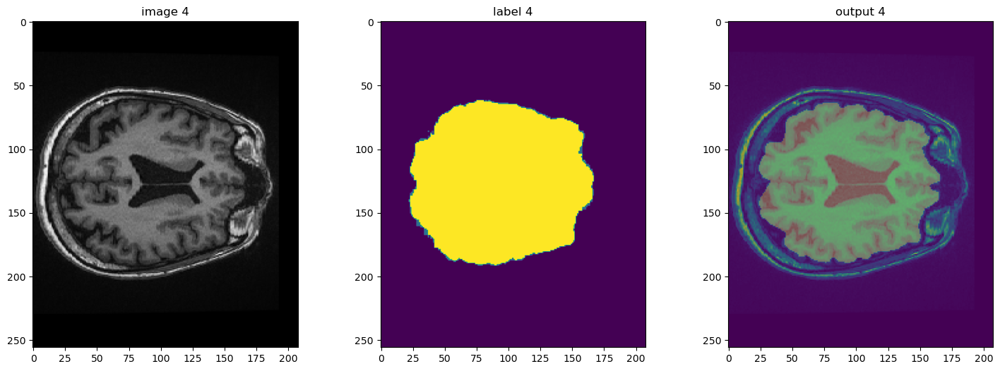

(1, 1, 256, 208, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0242_ge_15_55_F.nii.gz']
CC0242_ge_15_55_F.nii.gz
tensor([[0.9982, 0.9833]])
0.9899117946624756
(1, 256, 208, 256)


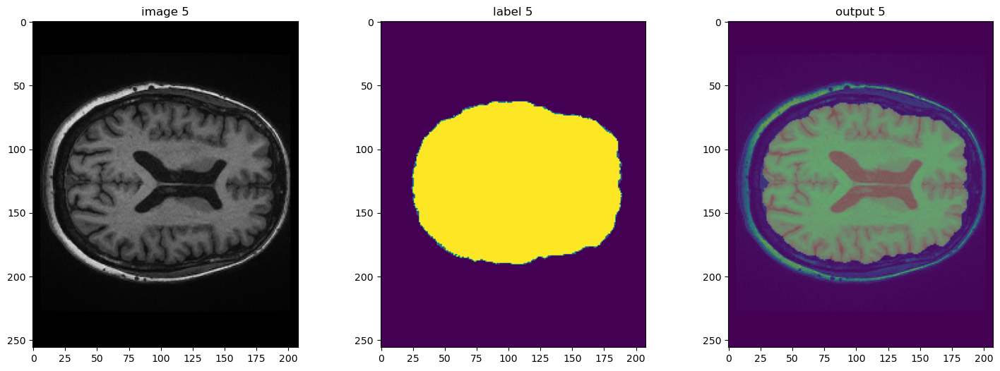

(1, 1, 256, 208, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0243_ge_15_58_F.nii.gz']
CC0243_ge_15_58_F.nii.gz
tensor([[0.9985, 0.9855]])
0.9902103543281555
(1, 256, 208, 256)


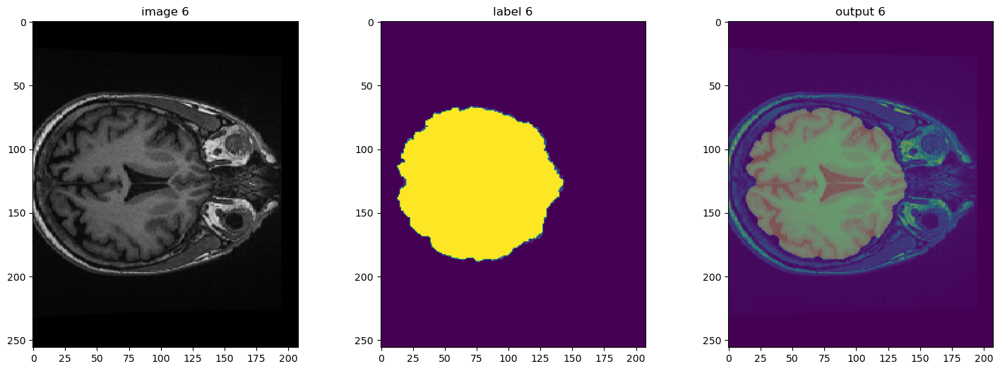

(1, 1, 256, 208, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0244_ge_15_56_F.nii.gz']
CC0244_ge_15_56_F.nii.gz
tensor([[0.9978, 0.9790]])
0.9899837970733643
(1, 256, 208, 256)


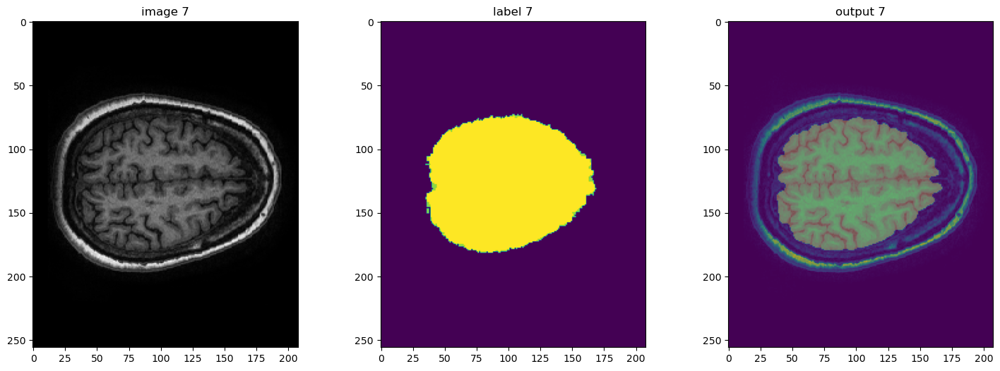

(1, 1, 256, 192, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0246_ge_15_60_F.nii.gz']
CC0246_ge_15_60_F.nii.gz
tensor([[0.9986, 0.9873]])
0.9903121590614319
(1, 256, 192, 256)


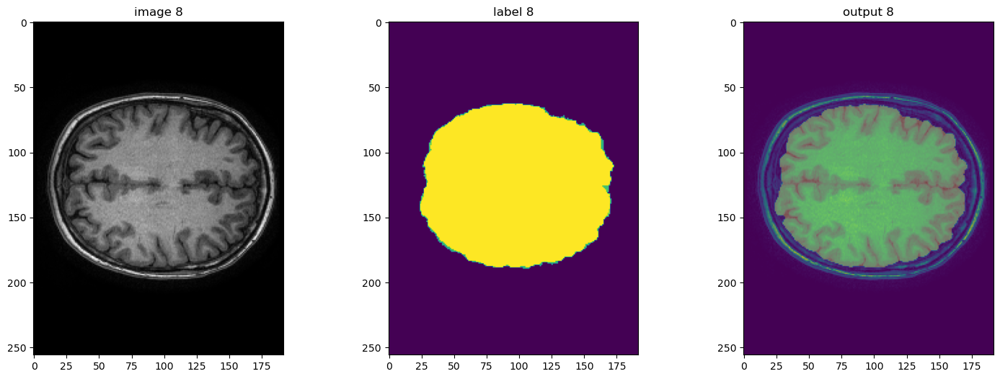

(1, 1, 256, 208, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0248_ge_15_51_M.nii.gz']
CC0248_ge_15_51_M.nii.gz
tensor([[0.9983, 0.9856]])
0.9904736280441284
(1, 256, 208, 256)


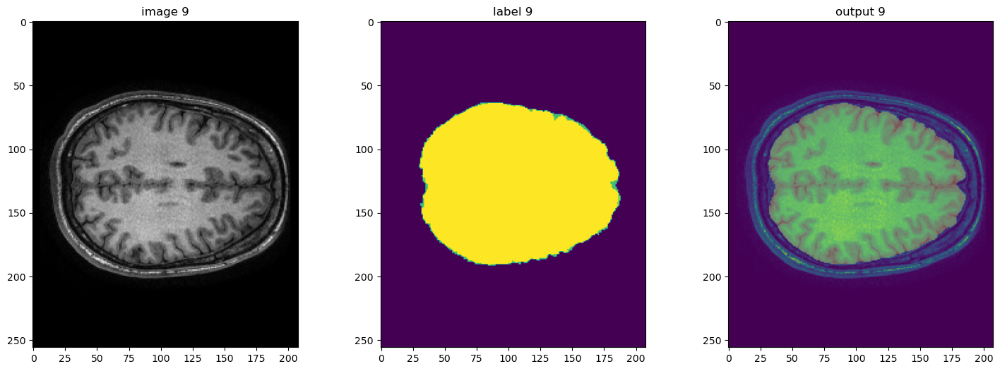

(1, 1, 256, 192, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0249_ge_15_58_F.nii.gz']
CC0249_ge_15_58_F.nii.gz
tensor([[0.9979, 0.9821]])
0.9904298186302185
(1, 256, 192, 256)


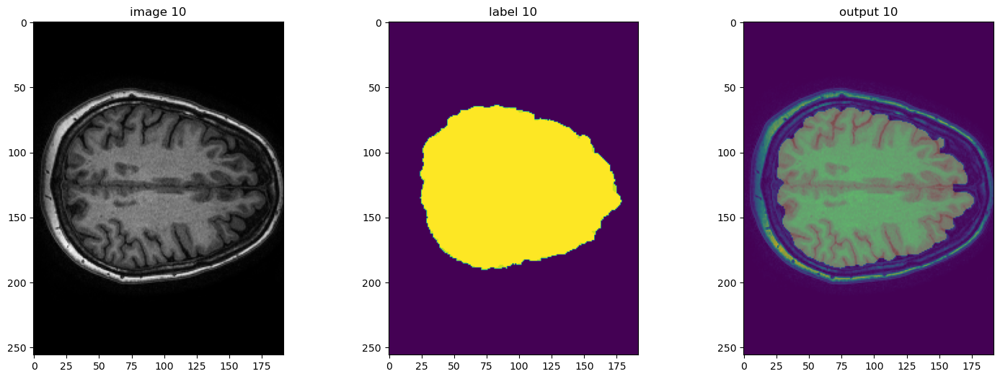

(1, 1, 256, 208, 256)
['C:\\Users\\nehag\\Downloads\\T1W original\\val\\CC0250_ge_15_60_F.nii.gz']
CC0250_ge_15_60_F.nii.gz
tensor([[0.9979, 0.9803]])
0.9903199076652527
(1, 256, 208, 256)


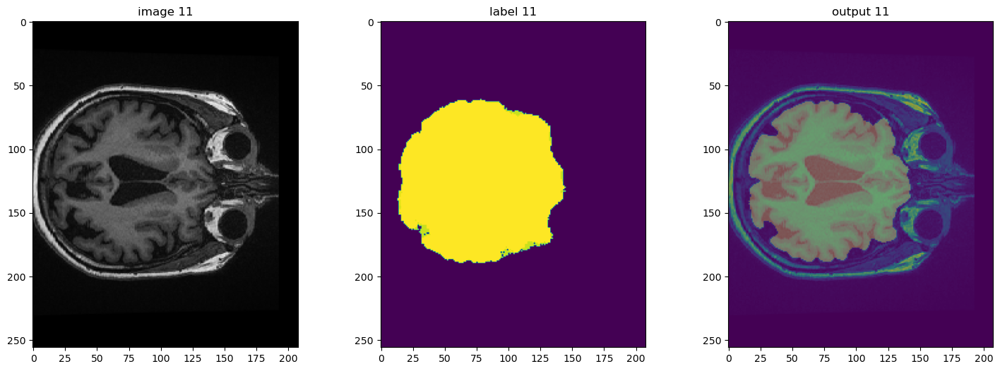

In [7]:
dice_metric = DiceMetric(include_background=True, reduction="mean", get_not_nans=False)
net.eval()
for i, val_data in enumerate(val_loader):
        #print(val_data)
        roi_size = (160, 160, 160)
        sw_batch_size = 4
        #print(roi_size)
        #print(sw_batch_size)
        print(val_data["img"].shape)
        #val_outputs = sliding_window_inference(
        #    val_data["img"], roi_size, sw_batch_size, net
        #)
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)
        print(val_data["img"].meta["filename_or_obj"])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        print(name)
        #img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        #output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        #save = nib.save(output, "C:\\Users\\nehag\\train_seg_results\\lightening_seg_results_100\\test\\"+name)
        labels = val_data["label"]
        #y = labels.as_tensor()
        y = Fun.one_hot(labels.long(), num_classes = 2)
        y = y.squeeze(1)
        y = torch.movedim(y, 4, 1)
        #print(y.shape)
        #print(val_outputs.shape)
        #outputs = [post_pred(i) for i in decollate_batch(val_outputs)]
        #labels = [post_label(i) for i in decollate_batch(labels)]
        dice_metric(y_pred=val_outputs, y=y)
        print(dice_metric(y_pred=val_outputs, y=y))
        mean_dice_val = dice_metric.aggregate().item()
        print(mean_dice_val)
        # plot the slice [:, :, 80]
        plt.figure("check", (18, 6))
        plt.subplot(1, 3, 1)
        plt.title(f"image {i}")
        plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
        plt.subplot(1, 3, 2)
        plt.title(f"label {i}")
        plt.imshow(val_data["label"][0, 0, :, :, 170])
        plt.subplot(1, 3, 3)
        plt.title(f"output {i}")
        plt.imshow(val_data["img"][0, 0, :, :, 170])
        plt.imshow(torch.argmax(
            val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)
        
        print(torch.argmax(val_outputs, dim=1).shape)
        plt.show()
        
        
        if (i>10):
            break

In [9]:
#avg validation score - whole set
imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Downloads\\T1W original\\val\\*.nii.gz")
labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\val\\*.nii.gz")
val_files = [{"img": x, "label": y} for (x,y) in zip(imgs_list_val,labels_val)]
val_transforms = Compose(
            [
                LoadImaged(keys=["img", "label"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img", "label"]),
                DivisiblePadd(["img", "label"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                RandRotated(
                    keys=["img", "label"],
                    range_x=np.pi / 4,
                    prob=0.5,
                    keep_size=True,
                    mode="nearest"
                )
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=val_transforms)
val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

net.eval()
metric = []
for i, val_data in enumerate(val_loader):
        
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)
        
        #img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        #output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        #save = nib.save(output, "C:\\Users\\nehag\\train_seg_results\\lightening_seg_results_100\\test\\"+name)
        labels = val_data["label"]
        #y = labels.as_tensor()
        y = Fun.one_hot(labels.long(), num_classes = 2)
        y = y.squeeze(1)
        y = torch.movedim(y, 4, 1)
        #print(y.shape)
        #print(val_outputs.shape)
        #outputs = [post_pred(i) for i in decollate_batch(val_outputs)]
        #labels = [post_label(i) for i in decollate_batch(labels)]
        dice_metric(y_pred=val_outputs, y=y)
        #print(dice_metric(y_pred=val_outputs, y=y))
        mean_dice_val = dice_metric.aggregate().item()
        #print(mean_dice_val)
        metric.append(mean_dice_val)
        
print('validation score avg ', np.mean(metric))

validation score avg  0.9902755372664508


In [10]:
imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Downloads\\T1W original\\test\\*.nii.gz")
labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x, "label": y} for (x,y) in zip(imgs_list_val,labels_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img", "label"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img", "label"]),
                DivisiblePadd(["img", "label"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
for i, val_data in enumerate(val_loader):
        
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)
        
        #img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        #output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        #save = nib.save(output, "C:\\Users\\nehag\\train_seg_results\\lightening_seg_results_100\\test\\"+name)
        labels = val_data["label"]
        #y = labels.as_tensor()
        y = Fun.one_hot(labels.long(), num_classes = 2)
        y = y.squeeze(1)
        y = torch.movedim(y, 4, 1)
        #print(y.shape)
        #print(val_outputs.shape)
        #outputs = [post_pred(i) for i in decollate_batch(val_outputs)]
        #labels = [post_label(i) for i in decollate_batch(labels)]
        dice_metric(y_pred=val_outputs, y=y)
        #print(dice_metric(y_pred=val_outputs, y=y))
        mean_dice_val = dice_metric.aggregate().item()
        #print(mean_dice_val)
        metric.append(mean_dice_val)
        
print('test score avg ', np.mean(metric))

test score avg  0.9874400963970259


# TESTING on other datasets

# 1. Normative

426
0 C:\Users\nehag\Data\normative_fsl\NORM100_REP11_RF_T1_3.nii.gz
(1, 176, 256, 256)


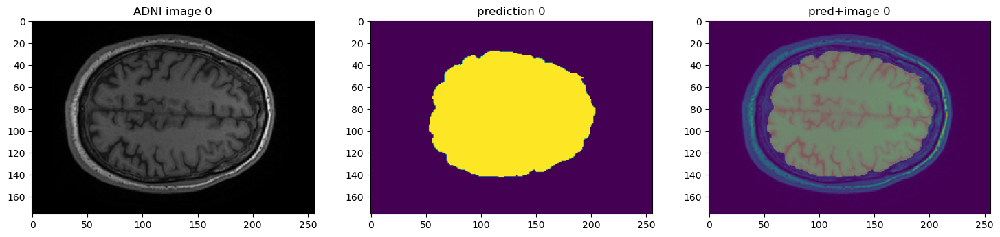

1 C:\Users\nehag\Data\normative_fsl\NORM100_REP12_RF_T1_3.nii.gz
(1, 176, 256, 256)


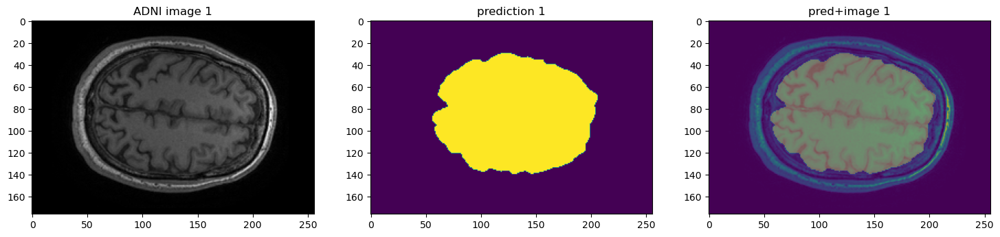

2 C:\Users\nehag\Data\normative_fsl\NORM100_REP13_RF_T1_13.nii.gz
(1, 176, 256, 256)


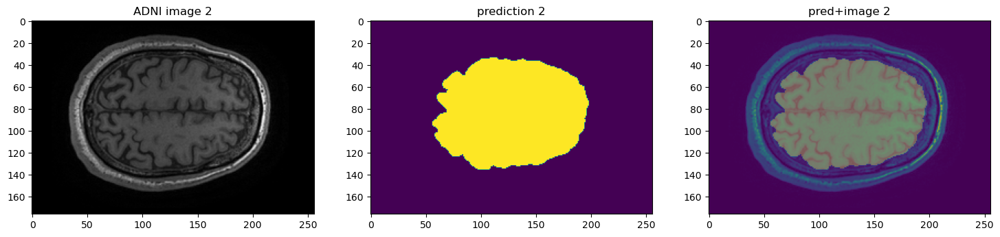

3 C:\Users\nehag\Data\normative_fsl\NORM100_REP13_RF_T1_3.nii.gz
(1, 176, 256, 256)


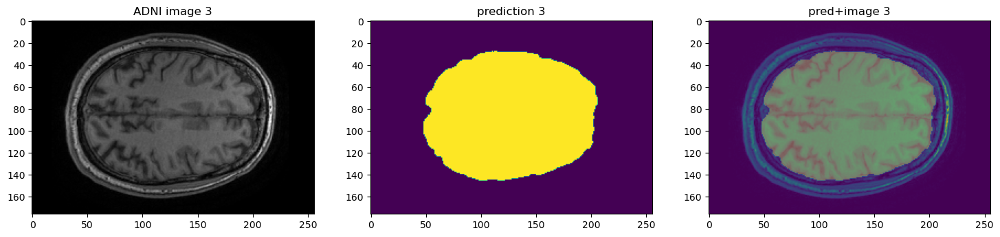

4 C:\Users\nehag\Data\normative_fsl\NORM100_REP14_RF_T1_13.nii.gz
(1, 176, 256, 256)


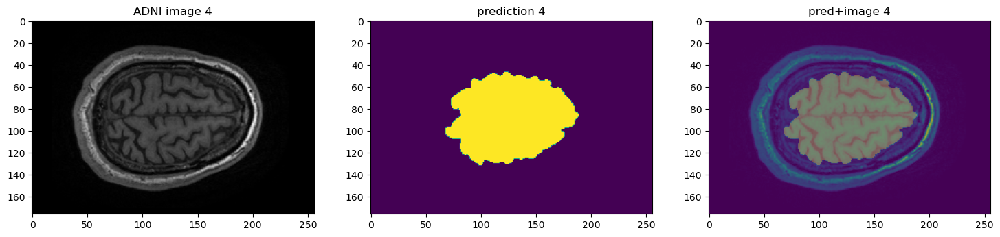

5 C:\Users\nehag\Data\normative_fsl\NORM100_REP14_RF_T1_3.nii.gz
(1, 176, 256, 256)


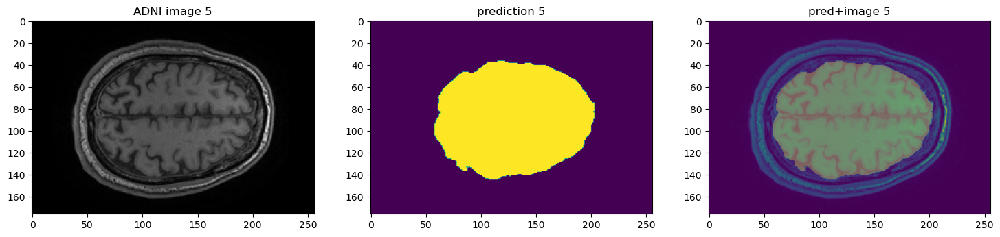

6 C:\Users\nehag\Data\normative_fsl\NORM100_REP15_RF_T1_13.nii.gz
7 C:\Users\nehag\Data\normative_fsl\NORM100_REP15_RF_T1_3.nii.gz
8 C:\Users\nehag\Data\normative_fsl\NORM100_REP2_RF_T1_4.nii.gz
9 C:\Users\nehag\Data\normative_fsl\NORM100_REP3_RF_T1_4.nii.gz
10 C:\Users\nehag\Data\normative_fsl\NORM100_REP4_RF_T1_3.nii.gz
11 C:\Users\nehag\Data\normative_fsl\NORM100_REP5_RF_T1_3.nii.gz
12 C:\Users\nehag\Data\normative_fsl\NORM100_REP6_RF_T1_5.nii.gz
13 C:\Users\nehag\Data\normative_fsl\NORM100_REP7_RF_T1_3.nii.gz
14 C:\Users\nehag\Data\normative_fsl\NORM100_REP8_RF_T1_3.nii.gz
15 C:\Users\nehag\Data\normative_fsl\NORM100_REP9_RF_T1_3.nii.gz
16 C:\Users\nehag\Data\normative_fsl\NORM100_RF_T1_7.nii.gz
17 C:\Users\nehag\Data\normative_fsl\NORM101B_LA_T1_3.nii.gz
18 C:\Users\nehag\Data\normative_fsl\NORM101_LA_T1_6.nii.gz
19 C:\Users\nehag\Data\normative_fsl\NORM101_LA_T1_8.nii.gz
20 C:\Users\nehag\Data\normative_fsl\NORM101_REP1_LA_T1_13.nii.gz
21 C:\Users\nehag\Data\normative_fsl\NORM101

137 C:\Users\nehag\Data\normative_fsl\NORM158_JT_T1_5.nii.gz
138 C:\Users\nehag\Data\normative_fsl\NORM160B_BD_T1_3.nii.gz
139 C:\Users\nehag\Data\normative_fsl\NORM160_BD_T1_5.nii.gz
140 C:\Users\nehag\Data\normative_fsl\NORM161B_EB_T1_3.nii.gz
141 C:\Users\nehag\Data\normative_fsl\NORM161_EB_T1_5.nii.gz
142 C:\Users\nehag\Data\normative_fsl\NORM162_TS_T1_6.nii.gz
143 C:\Users\nehag\Data\normative_fsl\NORM200B_DH_T1_4.nii.gz
144 C:\Users\nehag\Data\normative_fsl\NORM200_DH_T1_6.nii.gz
145 C:\Users\nehag\Data\normative_fsl\NORM201B_MR_T1_3.nii.gz
146 C:\Users\nehag\Data\normative_fsl\NORM201_MR_T1_6.nii.gz
147 C:\Users\nehag\Data\normative_fsl\NORM202_VN_T1_5.nii.gz
148 C:\Users\nehag\Data\normative_fsl\NORM202_VN_T1_6.nii.gz
149 C:\Users\nehag\Data\normative_fsl\NORM203_TB_T1_5.nii.gz
150 C:\Users\nehag\Data\normative_fsl\NORM204B_DL_T1_4.nii.gz
151 C:\Users\nehag\Data\normative_fsl\NORM204_DL_T1_13.nii.gz
152 C:\Users\nehag\Data\normative_fsl\NORM204_DL_T1_6.nii.gz
153 C:\Users\nehag

271 C:\Users\nehag\Data\normative_fsl\NORM293_JT_T1_6.nii.gz
272 C:\Users\nehag\Data\normative_fsl\NORM294_YH_T1_5.nii.gz
273 C:\Users\nehag\Data\normative_fsl\NORM295_EM_T1_5.nii.gz
274 C:\Users\nehag\Data\normative_fsl\NORM296_TO_T1_5.nii.gz
275 C:\Users\nehag\Data\normative_fsl\NORM297_CB_T1_5.nii.gz
276 C:\Users\nehag\Data\normative_fsl\NORM298_MK_T1_5.nii.gz
277 C:\Users\nehag\Data\normative_fsl\NORM299_LM_T1_5.nii.gz
278 C:\Users\nehag\Data\normative_fsl\NORM300_MS_T1_5.nii.gz
279 C:\Users\nehag\Data\normative_fsl\NORM301B_AC_T1_3.nii.gz
280 C:\Users\nehag\Data\normative_fsl\NORM301_AC_T1_6.nii.gz
281 C:\Users\nehag\Data\normative_fsl\NORM302_QB_T1_5.nii.gz
282 C:\Users\nehag\Data\normative_fsl\NORM303_KS_T1_5.nii.gz
283 C:\Users\nehag\Data\normative_fsl\NORM304B_CO_T1_4.nii.gz
284 C:\Users\nehag\Data\normative_fsl\NORM304_CO_T1_6.nii.gz
285 C:\Users\nehag\Data\normative_fsl\NORM305B_TM_T1_4.nii.gz
286 C:\Users\nehag\Data\normative_fsl\NORM305_TM_T1_5.nii.gz
287 C:\Users\nehag\Da

405 C:\Users\nehag\Data\normative_fsl\NORM380_BB_T1_6.nii.gz
406 C:\Users\nehag\Data\normative_fsl\NORM381_HJ_T1_6.nii.gz
407 C:\Users\nehag\Data\normative_fsl\NORM382B_PR_T1_3.nii.gz
408 C:\Users\nehag\Data\normative_fsl\NORM382_PR_T1_5.nii.gz
409 C:\Users\nehag\Data\normative_fsl\NORM400_CS_T1_3.nii.gz
410 C:\Users\nehag\Data\normative_fsl\NORM401_JP_T1_3.nii.gz
411 C:\Users\nehag\Data\normative_fsl\NORM402_MW_T1_3.nii.gz
412 C:\Users\nehag\Data\normative_fsl\NORM403_PR_T1_3.nii.gz
413 C:\Users\nehag\Data\normative_fsl\NORM404_VT_T1_3.nii.gz
414 C:\Users\nehag\Data\normative_fsl\NORM405_DG_T1_3.nii.gz
415 C:\Users\nehag\Data\normative_fsl\NORM405_REP1_DB_T1_13.nii.gz
416 C:\Users\nehag\Data\normative_fsl\NORM405_REP1_DB_T1_3.nii.gz
417 C:\Users\nehag\Data\normative_fsl\NORM405_REP2_DG_T1_13.nii.gz
418 C:\Users\nehag\Data\normative_fsl\NORM405_REP2_DG_T1_3.nii.gz
419 C:\Users\nehag\Data\normative_fsl\NORM405_REP3_DG_T1_13.nii.gz
420 C:\Users\nehag\Data\normative_fsl\NORM405_REP3_DG_T1

In [7]:
imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Data\\normative_fsl\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\normative\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"ADNI image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


# 2. ADNI

1161
0 C:\Users\nehag\Data\ADNI_fsl\ADNI_002_S_1280_MR_MP-RAGE_REPEAT_br_raw_20090219210925308_1_S63384_I136592.nii.gz
(1, 176, 256, 256)


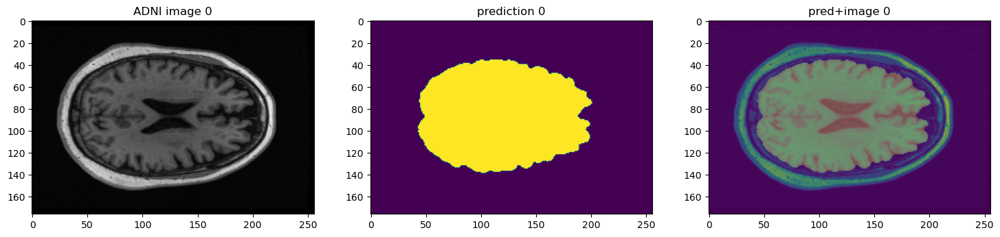

1 C:\Users\nehag\Data\ADNI_fsl\ADNI_002_S_1280_MR_MP-RAGE_REPEAT_br_raw_20090219210955345_1_S63383_I136591.nii.gz
(1, 176, 256, 256)


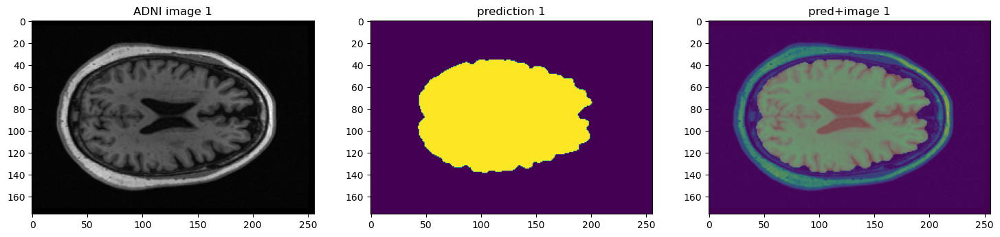

2 C:\Users\nehag\Data\ADNI_fsl\ADNI_002_S_1280_MR_MP-RAGE_REPEAT_br_raw_20100218221313139_157_S80217_I166429.nii.gz
(1, 176, 256, 256)


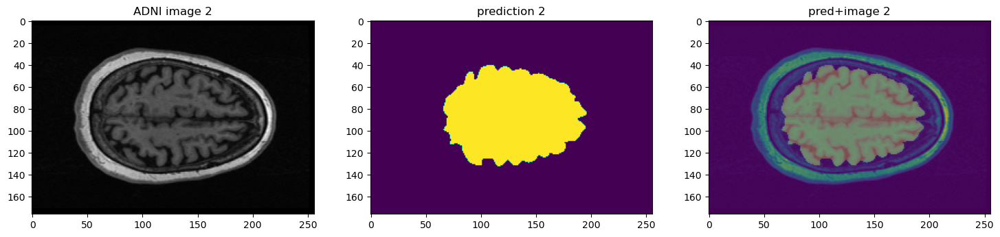

3 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0223_MR_MP-RAGE_REPEAT_br_raw_20060306140048129_166_S11982_I11646.nii.gz
(1, 176, 256, 256)


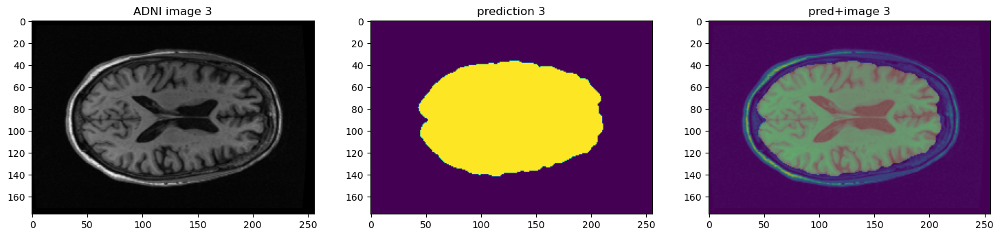

4 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0223_MR_MP-RAGE_REPEAT_br_raw_20061011144749978_1_S19963_I26115.nii.gz
(1, 176, 256, 256)


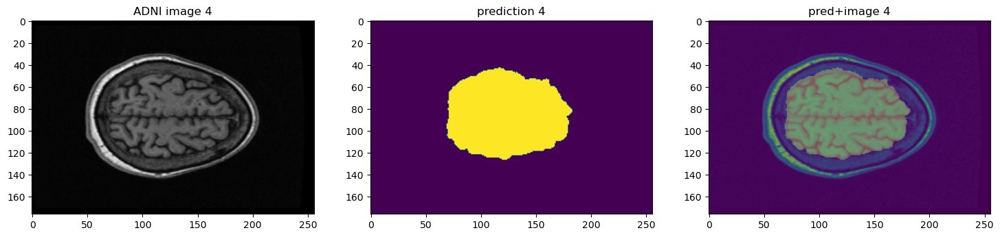

5 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0223_MR_MP-RAGE_REPEAT_br_raw_20070316142342220_1_S28245_I45003.nii.gz
(1, 176, 256, 256)


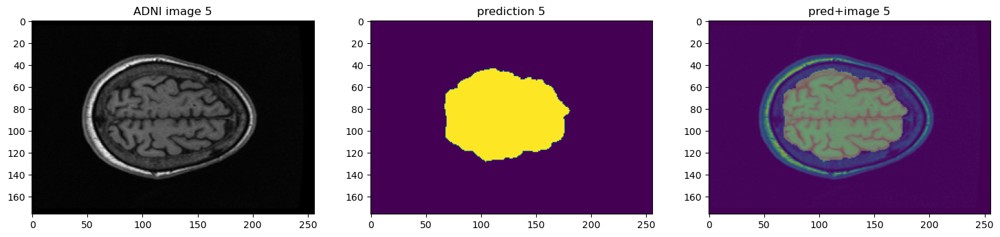

6 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0223_MR_MP-RAGE_REPEAT_br_raw_20080318154407415_3_S47239_I98932.nii.gz
7 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0223_MR_MP-RAGE_REPEAT_br_raw_20090506144118534_3_S67115_I143296.nii.gz
8 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0223_MR_MP-RAGE__br_raw_20060306135958832_92_S11981_I11645.nii.gz
9 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0223_MR_MP-RAGE__br_raw_20061011144711885_1_S19964_I26116.nii.gz
10 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0223_MR_MP-RAGE__br_raw_20070316142304315_1_S28246_I45004.nii.gz
11 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0223_MR_MP-RAGE__br_raw_20080318154334801_3_S47240_I98933.nii.gz
12 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0223_MR_MP-RAGE__br_raw_20090506144043629_3_S67114_I143295.nii.gz
13 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0553_MR_MP-RAGE-REPEAT_br_raw_20060628144609102_1_S15929_I17620.nii.gz
14 C:\Users\nehag\Data\ADNI_fsl\ADNI_005_S_0553_MR_MP-RAGE-REPEAT_br_raw_20070104153328809_1_S24692_I35239.nii.gz
15 C:

80 C:\Users\nehag\Data\ADNI_fsl\ADNI_006_S_0498_MR_MP-RAGE_REPEAT_br_raw_20070313130256968_1_S28001_I44486.nii.gz
81 C:\Users\nehag\Data\ADNI_fsl\ADNI_006_S_0498_MR_MP-RAGE_REPEAT_br_raw_20070925143832859_1_S39972_I75183.nii.gz
82 C:\Users\nehag\Data\ADNI_fsl\ADNI_006_S_0498_MR_MP-RAGE_REPEAT_br_raw_20081003112152437_1_S56951_I119099.nii.gz
83 C:\Users\nehag\Data\ADNI_fsl\ADNI_006_S_0498_MR_MP-RAGE_REPEAT_br_raw_20101207152146681_7_S96008_I207804.nii.gz
84 C:\Users\nehag\Data\ADNI_fsl\ADNI_006_S_0498_MR_MP-RAGE_REPEAT_br_raw_20111116124942272_163_S129610_I266907.nii.gz
85 C:\Users\nehag\Data\ADNI_fsl\ADNI_006_S_0498_MR_MP-RAGE_REPEAT_br_raw_20121002102558706_112_S169359_I337717.nii.gz
86 C:\Users\nehag\Data\ADNI_fsl\ADNI_006_S_0498_MR_MP-RAGE__br_raw_20060626130033734_1_S15857_I17505.nii.gz
87 C:\Users\nehag\Data\ADNI_fsl\ADNI_006_S_0498_MR_MP-RAGE__br_raw_20061005155451515_1_S19762_I25790.nii.gz
88 C:\Users\nehag\Data\ADNI_fsl\ADNI_006_S_0498_MR_MP-RAGE__br_raw_20070313130205296_1_S28

153 C:\Users\nehag\Data\ADNI_fsl\ADNI_007_S_1222_MR_MP-RAGE_REPEAT_br_raw_20070123224950852_51_S25402_I37271.nii.gz
154 C:\Users\nehag\Data\ADNI_fsl\ADNI_007_S_1222_MR_MP-RAGE_REPEAT_br_raw_20070208195957111_1_S26091_I38483.nii.gz
155 C:\Users\nehag\Data\ADNI_fsl\ADNI_007_S_1222_MR_MP-RAGE_REPEAT_br_raw_20070905180219496_1_S38919_I71870.nii.gz
156 C:\Users\nehag\Data\ADNI_fsl\ADNI_007_S_1222_MR_MP-RAGE_REPEAT_br_raw_20070905180436577_164_S38925_I71879.nii.gz
157 C:\Users\nehag\Data\ADNI_fsl\ADNI_007_S_1222_MR_MP-RAGE_REPEAT_br_raw_20070905180512302_83_S38926_I71880.nii.gz
158 C:\Users\nehag\Data\ADNI_fsl\ADNI_007_S_1222_MR_MP-RAGE_REPEAT_br_raw_20080223111935053_1_S46092_I91624.nii.gz
159 C:\Users\nehag\Data\ADNI_fsl\ADNI_007_S_1222_MR_MP-RAGE_REPEAT_br_raw_20080223113835927_1_S46099_I91634.nii.gz
160 C:\Users\nehag\Data\ADNI_fsl\ADNI_007_S_1222_MR_MP-RAGE_REPEAT_br_raw_20090219125735127_34_S63319_I136458.nii.gz
161 C:\Users\nehag\Data\ADNI_fsl\ADNI_007_S_1222_MR_MP-RAGE_REPEAT_br_raw_

226 C:\Users\nehag\Data\ADNI_fsl\ADNI_014_S_0548_MR_MP-RAGE__br_raw_20080626083705989_1_S52415_I111028.nii.gz
227 C:\Users\nehag\Data\ADNI_fsl\ADNI_014_S_0548_MR_MP-RAGE__br_raw_20090720102035247_21_S70313_I149716.nii.gz
228 C:\Users\nehag\Data\ADNI_fsl\ADNI_014_S_0548_MR_MP-RAGE__br_raw_20100730133828952_47_S89743_I188697.nii.gz
229 C:\Users\nehag\Data\ADNI_fsl\ADNI_014_S_0558_MR_MP-RAGE_REPEAT_br_raw_20060622143228672_1_S15790_I17401.nii.gz
230 C:\Users\nehag\Data\ADNI_fsl\ADNI_014_S_0558_MR_MP-RAGE_REPEAT_br_raw_20070117105212793_1_S25131_I36345.nii.gz
231 C:\Users\nehag\Data\ADNI_fsl\ADNI_014_S_0558_MR_MP-RAGE_REPEAT_br_raw_20070719110639432_1_S35310_I60876.nii.gz
232 C:\Users\nehag\Data\ADNI_fsl\ADNI_014_S_0558_MR_MP-RAGE_REPEAT_br_raw_20080709121814687_1_S53215_I112895.nii.gz
233 C:\Users\nehag\Data\ADNI_fsl\ADNI_014_S_0558_MR_MP-RAGE_REPEAT_br_raw_20090708093339331_81_S69648_I148260.nii.gz
234 C:\Users\nehag\Data\ADNI_fsl\ADNI_014_S_0558_MR_MP-RAGE_REPEAT_br_raw_2010082609364218

299 C:\Users\nehag\Data\ADNI_fsl\ADNI_024_S_0985_MR_MP-RAGE__br_raw_20081031082656947_1_S58131_I124649.nii.gz
300 C:\Users\nehag\Data\ADNI_fsl\ADNI_024_S_0985_MR_MP-RAGE__br_raw_20091201122154309_1_S76830_I159930.nii.gz
301 C:\Users\nehag\Data\ADNI_fsl\ADNI_024_S_0985_MR_MP-RAGE__br_raw_20101130143223848_37_S95426_I206944.nii.gz
302 C:\Users\nehag\Data\ADNI_fsl\ADNI_024_S_1063_MR_MP-RAGE_REPEAT_br_raw_20061031135050437_1_S21525_I28110.nii.gz
303 C:\Users\nehag\Data\ADNI_fsl\ADNI_024_S_1063_MR_MP-RAGE_REPEAT_br_raw_20070521151445108_1_S32495_I54957.nii.gz
304 C:\Users\nehag\Data\ADNI_fsl\ADNI_024_S_1063_MR_MP-RAGE_REPEAT_br_raw_20071112145947293_1_S42546_I81675.nii.gz
305 C:\Users\nehag\Data\ADNI_fsl\ADNI_024_S_1063_MR_MP-RAGE_REPEAT_br_raw_20081120134336750_1_S58977_I126424.nii.gz
306 C:\Users\nehag\Data\ADNI_fsl\ADNI_024_S_1063_MR_MP-RAGE_REPEAT_br_raw_20091207153428639_1_S77032_I160488.nii.gz
307 C:\Users\nehag\Data\ADNI_fsl\ADNI_024_S_1063_MR_MP-RAGE_REPEAT_br_raw_20110204141001908_

372 C:\Users\nehag\Data\ADNI_fsl\ADNI_029_S_0824_MR_MP-RAGE_REPEAT_br_raw_20070327171718781_4_S29019_I47250.nii.gz
373 C:\Users\nehag\Data\ADNI_fsl\ADNI_029_S_0824_MR_MP-RAGE_REPEAT_br_raw_20071029130403203_165_S39316_I73290.nii.gz
374 C:\Users\nehag\Data\ADNI_fsl\ADNI_029_S_0824_MR_MP-RAGE_REPEAT_br_raw_20080922152541755_85_S56603_I118225.nii.gz
375 C:\Users\nehag\Data\ADNI_fsl\ADNI_029_S_0824_MR_MP-RAGE_REPEAT_br_raw_20091007124355454_85_S74587_I156288.nii.gz
376 C:\Users\nehag\Data\ADNI_fsl\ADNI_029_S_0824_MR_MP-RAGE_REPEAT_br_raw_20100923101907267_14_S92474_I193386.nii.gz
377 C:\Users\nehag\Data\ADNI_fsl\ADNI_029_S_0824_MR_MP-RAGE__br_raw_20060823105631462_42_S18139_I23213.nii.gz
378 C:\Users\nehag\Data\ADNI_fsl\ADNI_029_S_0824_MR_MP-RAGE__br_raw_20070327171654265_1_S29020_I47251.nii.gz
379 C:\Users\nehag\Data\ADNI_fsl\ADNI_029_S_0824_MR_MP-RAGE__br_raw_20070914151846203_1_S39315_I73289.nii.gz
380 C:\Users\nehag\Data\ADNI_fsl\ADNI_029_S_0824_MR_MP-RAGE__br_raw_20080922152506708_4_S

445 C:\Users\nehag\Data\ADNI_fsl\ADNI_033_S_0734_MR_MP-RAGE__br_raw_20100805150611292_112_S90117_I189612.nii.gz
446 C:\Users\nehag\Data\ADNI_fsl\ADNI_033_S_0741_MR_MP-RAGE_REPEAT_br_raw_20060720105052975_1_S17007_I19259.nii.gz
447 C:\Users\nehag\Data\ADNI_fsl\ADNI_033_S_0741_MR_MP-RAGE_REPEAT_br_raw_20070216103344984_1_S26615_I40566.nii.gz
448 C:\Users\nehag\Data\ADNI_fsl\ADNI_033_S_0741_MR_MP-RAGE_REPEAT_br_raw_20070810171315992_3_S37197_I66960.nii.gz
449 C:\Users\nehag\Data\ADNI_fsl\ADNI_033_S_0741_MR_MP-RAGE_REPEAT_br_raw_20080818111720876_3_S55448_I116247.nii.gz
450 C:\Users\nehag\Data\ADNI_fsl\ADNI_033_S_0741_MR_MP-RAGE_REPEAT_br_raw_20090814161857299_3_S72443_I153191.nii.gz
451 C:\Users\nehag\Data\ADNI_fsl\ADNI_033_S_0741_MR_MP-RAGE_REPEAT_br_raw_20100805145227157_76_S90098_I189582.nii.gz
452 C:\Users\nehag\Data\ADNI_fsl\ADNI_033_S_0741_MR_MP-RAGE__br_raw_20060720104940826_1_S17006_I19258.nii.gz
453 C:\Users\nehag\Data\ADNI_fsl\ADNI_033_S_0741_MR_MP-RAGE__br_raw_20070216103228204

518 C:\Users\nehag\Data\ADNI_fsl\ADNI_037_S_0303_MR_MP-RAGE-Repeat_br_raw_20101021141614901_31_S93545_I198304.nii.gz
519 C:\Users\nehag\Data\ADNI_fsl\ADNI_037_S_0303_MR_MP-RAGE-Repeat_br_raw_20110627145348411_95_S111599_I240221.nii.gz
520 C:\Users\nehag\Data\ADNI_fsl\ADNI_037_S_0303_MR_MP-RAGE_REPEAT_br_raw_20070426094449714_1_S30693_I51121.nii.gz
521 C:\Users\nehag\Data\ADNI_fsl\ADNI_037_S_0303_MR_MP-RAGE__br_raw_20060407155824098_1_S12981_I13152.nii.gz
522 C:\Users\nehag\Data\ADNI_fsl\ADNI_037_S_0303_MR_MP-RAGE__br_raw_20061020173709096_86_S20571_I26923.nii.gz
523 C:\Users\nehag\Data\ADNI_fsl\ADNI_037_S_0303_MR_MP-RAGE__br_raw_20070426094343838_1_S30692_I51120.nii.gz
524 C:\Users\nehag\Data\ADNI_fsl\ADNI_037_S_0303_MR_MP-RAGE__br_raw_20080423104430609_86_S49142_I103575.nii.gz
525 C:\Users\nehag\Data\ADNI_fsl\ADNI_037_S_0303_MR_MP-RAGE__br_raw_20090605131753242_86_S68305_I145486.nii.gz
526 C:\Users\nehag\Data\ADNI_fsl\ADNI_037_S_0303_MR_MP-RAGE__br_raw_20101021141614432_137_S93542_I19

591 C:\Users\nehag\Data\ADNI_fsl\ADNI_052_S_1250_MR_MP-RAGE__br_raw_20070830143946671_1_S38680_I71034.nii.gz
592 C:\Users\nehag\Data\ADNI_fsl\ADNI_052_S_1250_MR_MP-RAGE__br_raw_20080124162713046_1_S44877_I88469.nii.gz
593 C:\Users\nehag\Data\ADNI_fsl\ADNI_052_S_1250_MR_MP-RAGE__br_raw_20090319142837546_131_S64820_I139452.nii.gz
594 C:\Users\nehag\Data\ADNI_fsl\ADNI_052_S_1250_MR_MP-RAGE__br_raw_20100607114324889_98_S86978_I176995.nii.gz
595 C:\Users\nehag\Data\ADNI_fsl\ADNI_052_S_1250_MR_MP-RAGE__br_raw_20110321143441596_89_S102069_I224500.nii.gz
596 C:\Users\nehag\Data\ADNI_fsl\ADNI_052_S_1250_MR_MP-RAGE__br_raw_20130311160851555_94_S184077_I362561.nii.gz
597 C:\Users\nehag\Data\ADNI_fsl\ADNI_052_S_1250_MR_MP-RAGE__br_raw_20130311160905230_50_S184081_I362567.nii.gz
598 C:\Users\nehag\Data\ADNI_fsl\ADNI_052_S_1250_MR_MP-RAGE__br_raw_20140516155501460_96_S218735_I424987.nii.gz
599 C:\Users\nehag\Data\ADNI_fsl\ADNI_052_S_1251_MR_MP-RAGE_#2_br_raw_20110401140310298_53_S102864_I225697.nii.

664 C:\Users\nehag\Data\ADNI_fsl\ADNI_094_S_1241_MR_MP-RAGE__br_raw_20140707171502275_136_S64390_I138492.nii.gz
665 C:\Users\nehag\Data\ADNI_fsl\ADNI_094_S_1267_MR_MP-RAGE_REPEAT_br_raw_20070316143802525_1_S28218_I44944.nii.gz
666 C:\Users\nehag\Data\ADNI_fsl\ADNI_094_S_1267_MR_MP-RAGE_REPEAT_br_raw_20070323092610347_7_S28797_I46458.nii.gz
667 C:\Users\nehag\Data\ADNI_fsl\ADNI_094_S_1267_MR_MP-RAGE_REPEAT_br_raw_20070928170601069_7_S40753_I76332.nii.gz
668 C:\Users\nehag\Data\ADNI_fsl\ADNI_094_S_1267_MR_MP-RAGE_REPEAT_br_raw_20080331160757550_1_S47722_I99943.nii.gz
669 C:\Users\nehag\Data\ADNI_fsl\ADNI_094_S_1267_MR_MP-RAGE_REPEAT_br_raw_20080401113549509_3_S47759_I100004.nii.gz
670 C:\Users\nehag\Data\ADNI_fsl\ADNI_094_S_1267_MR_MP-RAGE_REPEAT_br_raw_20090626142621894_1_S69242_I146815.nii.gz
671 C:\Users\nehag\Data\ADNI_fsl\ADNI_094_S_1267_MR_MP-RAGE_REPEAT_br_raw_20100319104819412_39_S81375_I168285.nii.gz
672 C:\Users\nehag\Data\ADNI_fsl\ADNI_094_S_1267_MR_MP-RAGE_REPEAT_br_raw_20100

737 C:\Users\nehag\Data\ADNI_fsl\ADNI_116_S_0382_MR_MP-RAGE-Repeat_br_raw_20130506131221436_33_S160368_I322846.nii.gz
738 C:\Users\nehag\Data\ADNI_fsl\ADNI_116_S_0382_MR_MP-RAGE-Repeat_br_raw_20130604103740290_74_S191287_I375045.nii.gz
739 C:\Users\nehag\Data\ADNI_fsl\ADNI_116_S_0382_MR_MP-RAGE-Repeat_br_raw_20150519085944689_75_S260346_I493355.nii.gz
740 C:\Users\nehag\Data\ADNI_fsl\ADNI_116_S_0382_MR_MP-RAGE__br_raw_20060516075306093_7_S14502_I15347.nii.gz
741 C:\Users\nehag\Data\ADNI_fsl\ADNI_116_S_0382_MR_MP-RAGE__br_raw_20061201085332718_1_S23233_I31215.nii.gz
742 C:\Users\nehag\Data\ADNI_fsl\ADNI_116_S_0382_MR_MP-RAGE__br_raw_20070621161701312_51_S33930_I57582.nii.gz
743 C:\Users\nehag\Data\ADNI_fsl\ADNI_116_S_0382_MR_MP-RAGE__br_raw_20080528145321687_1_S50703_I107542.nii.gz
744 C:\Users\nehag\Data\ADNI_fsl\ADNI_116_S_0382_MR_MP-RAGE__br_raw_20090615155942036_1_S68572_I145868.nii.gz
745 C:\Users\nehag\Data\ADNI_fsl\ADNI_116_S_0382_MR_MP-RAGE__br_raw_20100818142245047_171_S90790_I

810 C:\Users\nehag\Data\ADNI_fsl\ADNI_116_S_1249_MR_MP-RAGE__br_raw_20140221121809311_6_S213155_I415160.nii.gz
811 C:\Users\nehag\Data\ADNI_fsl\ADNI_116_S_1249_MR_MP-RAGE__br_raw_20160519141205569_159_S443912_I711042.nii.gz
812 C:\Users\nehag\Data\ADNI_fsl\ADNI_126_S_0405_MR_MP-RAGE-REPEAT_br_raw_20060620093443300_1_S15644_I17175.nii.gz
813 C:\Users\nehag\Data\ADNI_fsl\ADNI_126_S_0405_MR_MP-RAGE_REPEAT_#3__br_raw_20060518103107029_1_S14636_I15565.nii.gz
814 C:\Users\nehag\Data\ADNI_fsl\ADNI_126_S_0405_MR_MP-RAGE_REPEAT_br_raw_20060518103223187_1_S14635_I15564.nii.gz
815 C:\Users\nehag\Data\ADNI_fsl\ADNI_126_S_0405_MR_MP-RAGE_REPEAT_br_raw_20070105150655145_1_S24765_I35356.nii.gz
816 C:\Users\nehag\Data\ADNI_fsl\ADNI_126_S_0405_MR_MP-RAGE_REPEAT_br_raw_20070117090820986_1_S25108_I36310.nii.gz
817 C:\Users\nehag\Data\ADNI_fsl\ADNI_126_S_0405_MR_MP-RAGE__br_raw_20060620093213988_1_S15645_I17176.nii.gz
818 C:\Users\nehag\Data\ADNI_fsl\ADNI_126_S_0405_MR_MP-RAGE__br_raw_20060620093328676_1_

883 C:\Users\nehag\Data\ADNI_fsl\ADNI_127_S_0622_MR_MP-RAGE_REPEAT_br_raw_20060629200242544_1_S15985_I17711.nii.gz
884 C:\Users\nehag\Data\ADNI_fsl\ADNI_127_S_0622_MR_MP-RAGE_REPEAT_br_raw_20061213181523902_1_S23998_I33132.nii.gz
885 C:\Users\nehag\Data\ADNI_fsl\ADNI_127_S_0622_MR_MP-RAGE_REPEAT_br_raw_20061213185905999_1_S24015_I33159.nii.gz
886 C:\Users\nehag\Data\ADNI_fsl\ADNI_127_S_0622_MR_MP-RAGE_REPEAT_br_raw_20070628174928801_56_S34163_I58069.nii.gz
887 C:\Users\nehag\Data\ADNI_fsl\ADNI_127_S_0622_MR_MP-RAGE_REPEAT_br_raw_20070628181138263_32_S34178_I58089.nii.gz
888 C:\Users\nehag\Data\ADNI_fsl\ADNI_127_S_0622_MR_MP-RAGE_REPEAT_br_raw_20080626120013184_1_S52482_I111143.nii.gz
889 C:\Users\nehag\Data\ADNI_fsl\ADNI_127_S_0622_MR_MP-RAGE_REPEAT_br_raw_20080626183524557_1_S52555_I111564.nii.gz
890 C:\Users\nehag\Data\ADNI_fsl\ADNI_127_S_0622_MR_MP-RAGE_REPEAT_br_raw_20090701172934702_1_S69344_I147628.nii.gz
891 C:\Users\nehag\Data\ADNI_fsl\ADNI_127_S_0622_MR_MP-RAGE_REPEAT_br_raw_2

956 C:\Users\nehag\Data\ADNI_fsl\ADNI_131_S_0123_MR_MP-RAGE_REPEAT_br_raw_20060119142555764_1_S10959_I10042.nii.gz
957 C:\Users\nehag\Data\ADNI_fsl\ADNI_131_S_0123_MR_MP-RAGE_REPEAT_br_raw_20061102151815245_1_S21795_I28471.nii.gz
958 C:\Users\nehag\Data\ADNI_fsl\ADNI_131_S_0123_MR_MP-RAGE_REPEAT_br_raw_20070216105215112_1_S26595_I40537.nii.gz
959 C:\Users\nehag\Data\ADNI_fsl\ADNI_131_S_0123_MR_MP-RAGE_REPEAT_br_raw_20080512113152651_1_S49897_I105090.nii.gz
960 C:\Users\nehag\Data\ADNI_fsl\ADNI_131_S_0123_MR_MP-RAGE_REPEAT_br_raw_20090206085459599_1_S62736_I135421.nii.gz
961 C:\Users\nehag\Data\ADNI_fsl\ADNI_131_S_0123_MR_MP-RAGE_REPEAT_br_raw_20100205134723703_1_S79800_I165859.nii.gz
962 C:\Users\nehag\Data\ADNI_fsl\ADNI_131_S_0123_MR_MP-RAGE_REPEAT_br_raw_20110405133059125_115_S103121_I226129.nii.gz
963 C:\Users\nehag\Data\ADNI_fsl\ADNI_131_S_0123_MR_MP-RAGE__br_raw_20060119142441928_1_S10960_I10043.nii.gz
964 C:\Users\nehag\Data\ADNI_fsl\ADNI_131_S_0123_MR_MP-RAGE__br_raw_20061102151

1029 C:\Users\nehag\Data\ADNI_fsl\ADNI_133_S_0433_MR_MP-RAGE__br_raw_20070510130913007_1_S32028_I54067.nii.gz
1030 C:\Users\nehag\Data\ADNI_fsl\ADNI_133_S_0433_MR_MP-RAGE__br_raw_20080512153905437_3_S49945_I105175.nii.gz
1031 C:\Users\nehag\Data\ADNI_fsl\ADNI_133_S_0433_MR_MP-RAGE__br_raw_20090526151920500_3_S67669_I144521.nii.gz
1032 C:\Users\nehag\Data\ADNI_fsl\ADNI_133_S_0488_MR_MP-RAGE_REPEAT_br_raw_20060510110523081_1_S14149_I14837.nii.gz
1033 C:\Users\nehag\Data\ADNI_fsl\ADNI_133_S_0488_MR_MP-RAGE_REPEAT_br_raw_20061219153225169_1_S24272_I33752.nii.gz
1034 C:\Users\nehag\Data\ADNI_fsl\ADNI_133_S_0488_MR_MP-RAGE_REPEAT_br_raw_20070713110452804_165_S34917_I59844.nii.gz
1035 C:\Users\nehag\Data\ADNI_fsl\ADNI_133_S_0488_MR_MP-RAGE_REPEAT_br_raw_20080604112444640_3_S51010_I108386.nii.gz
1036 C:\Users\nehag\Data\ADNI_fsl\ADNI_133_S_0488_MR_MP-RAGE_REPEAT_br_raw_20090608155558265_3_S68338_I145530.nii.gz
1037 C:\Users\nehag\Data\ADNI_fsl\ADNI_133_S_0488_MR_MP-RAGE__br_raw_200605101103238

1101 C:\Users\nehag\Data\ADNI_fsl\ADNI_136_S_0196_MR_MP-RAGE_REPEAT_br_raw_20080429174417159_1_S49468_I104263.nii.gz
1102 C:\Users\nehag\Data\ADNI_fsl\ADNI_136_S_0196_MR_MP-RAGE_REPEAT_br_raw_20090428174334388_1_S66747_I142726.nii.gz
1103 C:\Users\nehag\Data\ADNI_fsl\ADNI_136_S_0196_MR_MP-RAGE__br_raw_20060417161155043_1_S13253_I13550.nii.gz
1104 C:\Users\nehag\Data\ADNI_fsl\ADNI_136_S_0196_MR_MP-RAGE__br_raw_20061024113615439_1_S20811_I27222.nii.gz
1105 C:\Users\nehag\Data\ADNI_fsl\ADNI_136_S_0196_MR_MP-RAGE__br_raw_20070507184720106_1_S31861_I53717.nii.gz
1106 C:\Users\nehag\Data\ADNI_fsl\ADNI_136_S_0196_MR_MP-RAGE__br_raw_20080429174312976_1_S49467_I104262.nii.gz
1107 C:\Users\nehag\Data\ADNI_fsl\ADNI_136_S_0196_MR_MP-RAGE__br_raw_20090428174227572_1_S66746_I142725.nii.gz
1108 C:\Users\nehag\Data\ADNI_fsl\ADNI_137_S_0283_MR_MP-RAGE_REPEAT_br_raw_20060316093345833_180_S12220_I12030.nii.gz
1109 C:\Users\nehag\Data\ADNI_fsl\ADNI_137_S_0283_MR_MP-RAGE_REPEAT_br_raw_20061030120243439_1_S

In [5]:
#14 NOV model - 25 e[pochs 1e-4]
net = Net.load_from_checkpoint(r"C:\Users\nehag\train_seg_results\skull_stripping_logs4\lightning_logs_4\version_1\checkpoints\epoch=24-step=5949.ckpt")

imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Data\\ADNI_fsl\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\ADNI\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"ADNI image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


# 3. BrainDev IXI

581
0 C:\Users\nehag\Data\braindev_ixi_fsl\IXI002-Guys-0828-T1.nii.gz
(1, 160, 256, 256)


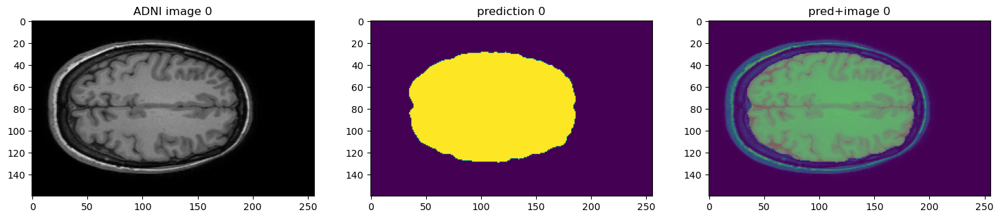

1 C:\Users\nehag\Data\braindev_ixi_fsl\IXI012-HH-1211-T1.nii.gz
(1, 160, 256, 256)


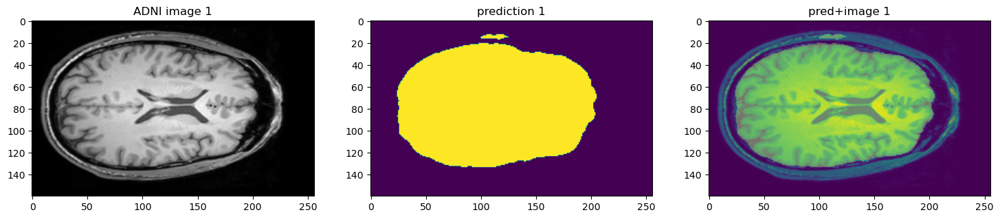

2 C:\Users\nehag\Data\braindev_ixi_fsl\IXI013-HH-1212-T1.nii.gz
(1, 160, 256, 256)


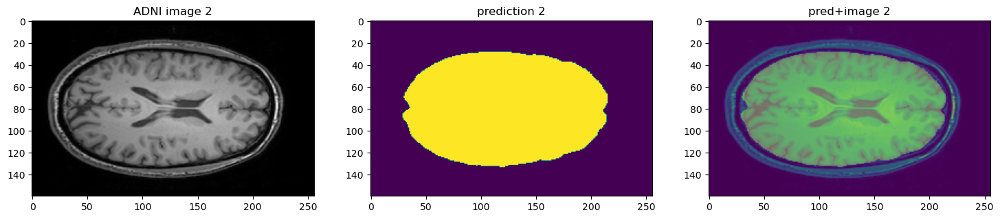

3 C:\Users\nehag\Data\braindev_ixi_fsl\IXI014-HH-1236-T1.nii.gz
(1, 160, 256, 256)


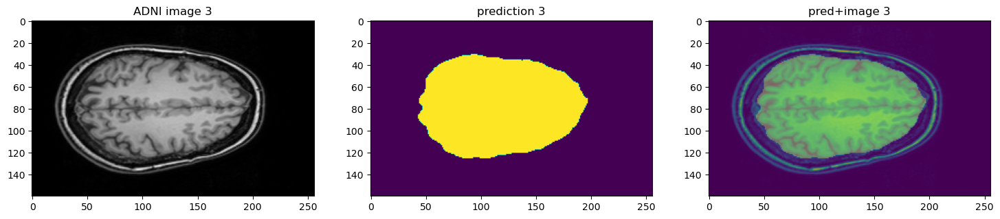

4 C:\Users\nehag\Data\braindev_ixi_fsl\IXI015-HH-1258-T1.nii.gz
(1, 160, 256, 256)


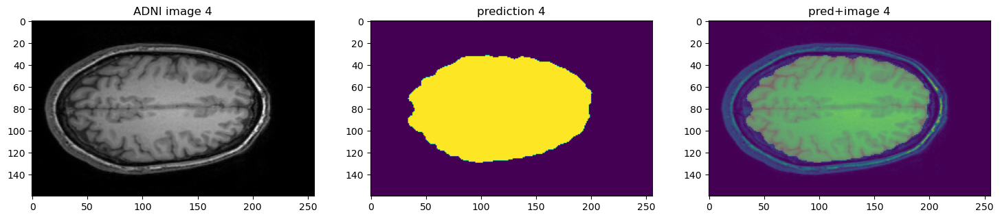

5 C:\Users\nehag\Data\braindev_ixi_fsl\IXI016-Guys-0697-T1.nii.gz
(1, 160, 256, 256)


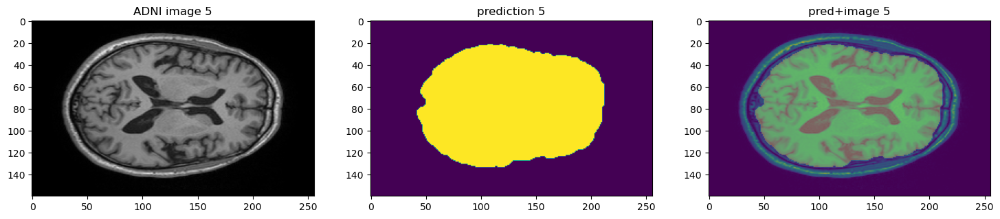

6 C:\Users\nehag\Data\braindev_ixi_fsl\IXI017-Guys-0698-T1.nii.gz
7 C:\Users\nehag\Data\braindev_ixi_fsl\IXI019-Guys-0702-T1.nii.gz
8 C:\Users\nehag\Data\braindev_ixi_fsl\IXI020-Guys-0700-T1.nii.gz
9 C:\Users\nehag\Data\braindev_ixi_fsl\IXI021-Guys-0703-T1.nii.gz
10 C:\Users\nehag\Data\braindev_ixi_fsl\IXI022-Guys-0701-T1.nii.gz
11 C:\Users\nehag\Data\braindev_ixi_fsl\IXI023-Guys-0699-T1.nii.gz
12 C:\Users\nehag\Data\braindev_ixi_fsl\IXI024-Guys-0705-T1.nii.gz
13 C:\Users\nehag\Data\braindev_ixi_fsl\IXI025-Guys-0852-T1.nii.gz
14 C:\Users\nehag\Data\braindev_ixi_fsl\IXI026-Guys-0696-T1.nii.gz
15 C:\Users\nehag\Data\braindev_ixi_fsl\IXI027-Guys-0710-T1.nii.gz
16 C:\Users\nehag\Data\braindev_ixi_fsl\IXI028-Guys-1038-T1.nii.gz
17 C:\Users\nehag\Data\braindev_ixi_fsl\IXI029-Guys-0829-T1.nii.gz
18 C:\Users\nehag\Data\braindev_ixi_fsl\IXI030-Guys-0708-T1.nii.gz
19 C:\Users\nehag\Data\braindev_ixi_fsl\IXI031-Guys-0797-T1.nii.gz
20 C:\Users\nehag\Data\braindev_ixi_fsl\IXI033-HH-1259-T1.nii.gz
2

129 C:\Users\nehag\Data\braindev_ixi_fsl\IXI148-HH-1453-T1.nii.gz
130 C:\Users\nehag\Data\braindev_ixi_fsl\IXI150-HH-1550-T1.nii.gz
131 C:\Users\nehag\Data\braindev_ixi_fsl\IXI151-Guys-0793-T1.nii.gz
132 C:\Users\nehag\Data\braindev_ixi_fsl\IXI153-Guys-0782-T1.nii.gz
133 C:\Users\nehag\Data\braindev_ixi_fsl\IXI154-Guys-0821-T1.nii.gz
134 C:\Users\nehag\Data\braindev_ixi_fsl\IXI156-Guys-0837-T1.nii.gz
135 C:\Users\nehag\Data\braindev_ixi_fsl\IXI157-Guys-0816-T1.nii.gz
136 C:\Users\nehag\Data\braindev_ixi_fsl\IXI158-Guys-0783-T1.nii.gz
137 C:\Users\nehag\Data\braindev_ixi_fsl\IXI159-HH-1549-T1.nii.gz
138 C:\Users\nehag\Data\braindev_ixi_fsl\IXI160-HH-1637-T1.nii.gz
139 C:\Users\nehag\Data\braindev_ixi_fsl\IXI161-HH-2533-T1.nii.gz
140 C:\Users\nehag\Data\braindev_ixi_fsl\IXI162-HH-1548-T1.nii.gz
141 C:\Users\nehag\Data\braindev_ixi_fsl\IXI163-HH-1621-T1.nii.gz
142 C:\Users\nehag\Data\braindev_ixi_fsl\IXI164-Guys-0844-T1.nii.gz
143 C:\Users\nehag\Data\braindev_ixi_fsl\IXI165-HH-1589-T1.nii

252 C:\Users\nehag\Data\braindev_ixi_fsl\IXI288-Guys-0879-T1.nii.gz
253 C:\Users\nehag\Data\braindev_ixi_fsl\IXI289-Guys-0864-T1.nii.gz
254 C:\Users\nehag\Data\braindev_ixi_fsl\IXI290-IOP-0874-T1.nii.gz
255 C:\Users\nehag\Data\braindev_ixi_fsl\IXI291-IOP-0882-T1.nii.gz
256 C:\Users\nehag\Data\braindev_ixi_fsl\IXI292-IOP-0877-T1.nii.gz
257 C:\Users\nehag\Data\braindev_ixi_fsl\IXI293-IOP-0876-T1.nii.gz
258 C:\Users\nehag\Data\braindev_ixi_fsl\IXI294-IOP-0868-T1.nii.gz
259 C:\Users\nehag\Data\braindev_ixi_fsl\IXI295-HH-1814-T1.nii.gz
260 C:\Users\nehag\Data\braindev_ixi_fsl\IXI296-HH-1970-T1.nii.gz
261 C:\Users\nehag\Data\braindev_ixi_fsl\IXI297-Guys-0886-T1.nii.gz
262 C:\Users\nehag\Data\braindev_ixi_fsl\IXI298-Guys-0861-T1.nii.gz
263 C:\Users\nehag\Data\braindev_ixi_fsl\IXI299-Guys-0893-T1.nii.gz
264 C:\Users\nehag\Data\braindev_ixi_fsl\IXI300-Guys-0880-T1.nii.gz
265 C:\Users\nehag\Data\braindev_ixi_fsl\IXI302-HH-1883-T1.nii.gz
266 C:\Users\nehag\Data\braindev_ixi_fsl\IXI303-IOP-0968-T1

374 C:\Users\nehag\Data\braindev_ixi_fsl\IXI420-Guys-1028-T1.nii.gz
375 C:\Users\nehag\Data\braindev_ixi_fsl\IXI422-Guys-1071-T1.nii.gz
376 C:\Users\nehag\Data\braindev_ixi_fsl\IXI423-IOP-0974-T1.nii.gz
377 C:\Users\nehag\Data\braindev_ixi_fsl\IXI424-IOP-0991-T1.nii.gz
378 C:\Users\nehag\Data\braindev_ixi_fsl\IXI425-IOP-0988-T1.nii.gz
379 C:\Users\nehag\Data\braindev_ixi_fsl\IXI426-IOP-1011-T1.nii.gz
380 C:\Users\nehag\Data\braindev_ixi_fsl\IXI427-IOP-1012-T1.nii.gz
381 C:\Users\nehag\Data\braindev_ixi_fsl\IXI428-Guys-0996-T1.nii.gz
382 C:\Users\nehag\Data\braindev_ixi_fsl\IXI429-Guys-0997-T1.nii.gz
383 C:\Users\nehag\Data\braindev_ixi_fsl\IXI430-IOP-0990-T1.nii.gz
384 C:\Users\nehag\Data\braindev_ixi_fsl\IXI431-Guys-0986-T1.nii.gz
385 C:\Users\nehag\Data\braindev_ixi_fsl\IXI432-Guys-0987-T1.nii.gz
386 C:\Users\nehag\Data\braindev_ixi_fsl\IXI433-IOP-0989-T1.nii.gz
387 C:\Users\nehag\Data\braindev_ixi_fsl\IXI434-IOP-1010-T1.nii.gz
388 C:\Users\nehag\Data\braindev_ixi_fsl\IXI435-IOP-1040

496 C:\Users\nehag\Data\braindev_ixi_fsl\IXI554-Guys-1068-T1.nii.gz
497 C:\Users\nehag\Data\braindev_ixi_fsl\IXI555-Guys-1074-T1.nii.gz
498 C:\Users\nehag\Data\braindev_ixi_fsl\IXI556-HH-2452-T1.nii.gz
499 C:\Users\nehag\Data\braindev_ixi_fsl\IXI558-Guys-1079-T1.nii.gz
500 C:\Users\nehag\Data\braindev_ixi_fsl\IXI559-HH-2394-T1.nii.gz
501 C:\Users\nehag\Data\braindev_ixi_fsl\IXI560-Guys-1070-T1.nii.gz
502 C:\Users\nehag\Data\braindev_ixi_fsl\IXI561-IOP-1152-T1.nii.gz
503 C:\Users\nehag\Data\braindev_ixi_fsl\IXI562-Guys-1131-T1.nii.gz
504 C:\Users\nehag\Data\braindev_ixi_fsl\IXI563-IOP-1153-T1.nii.gz
505 C:\Users\nehag\Data\braindev_ixi_fsl\IXI565-HH-2534-T1.nii.gz
506 C:\Users\nehag\Data\braindev_ixi_fsl\IXI566-HH-2535-T1.nii.gz
507 C:\Users\nehag\Data\braindev_ixi_fsl\IXI567-HH-2536-T1.nii.gz
508 C:\Users\nehag\Data\braindev_ixi_fsl\IXI568-HH-2607-T1.nii.gz
509 C:\Users\nehag\Data\braindev_ixi_fsl\IXI569-Guys-1101-T1.nii.gz
510 C:\Users\nehag\Data\braindev_ixi_fsl\IXI571-IOP-1154-T1.ni

In [4]:
#14 NOV model - 25 e[pochs 1e-4]
net = Net.load_from_checkpoint(r"C:\Users\nehag\train_seg_results\skull_stripping_logs4\lightning_logs_4\version_1\checkpoints\epoch=24-step=5949.ckpt")

imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Data\\braindev_ixi_fsl\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\braindev\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"ADNI image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


# 4. CAMCAN

653
0 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110033_T1w.nii.gz
(1, 192, 256, 256)


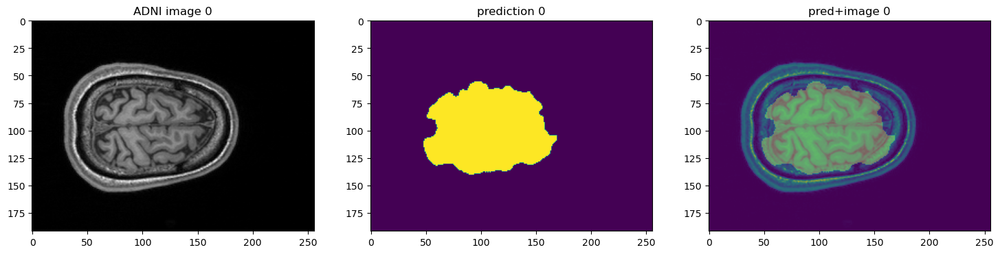

1 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110037_T1w.nii.gz
(1, 192, 256, 256)


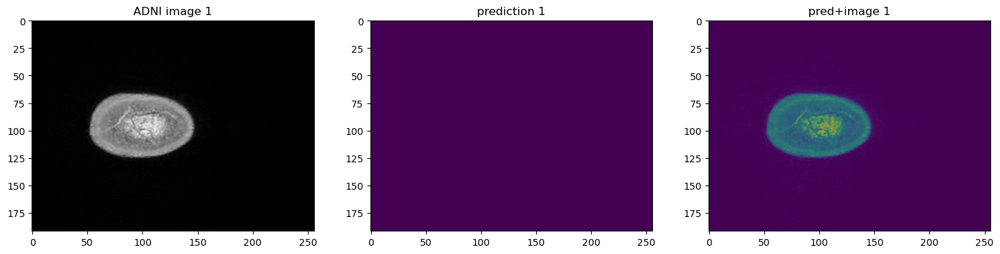

2 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110045_T1w.nii.gz
(1, 192, 256, 256)


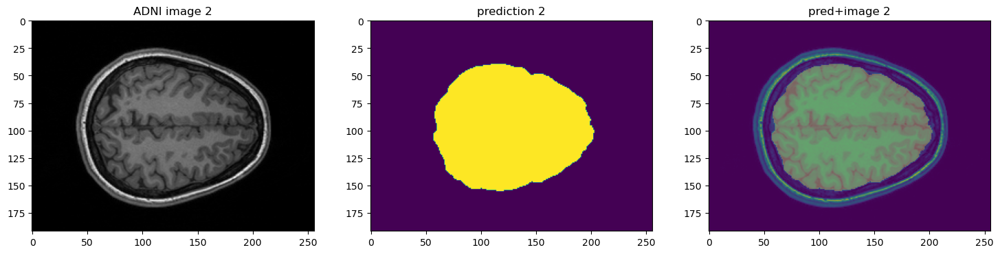

3 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110056_T1w.nii.gz
(1, 192, 256, 256)


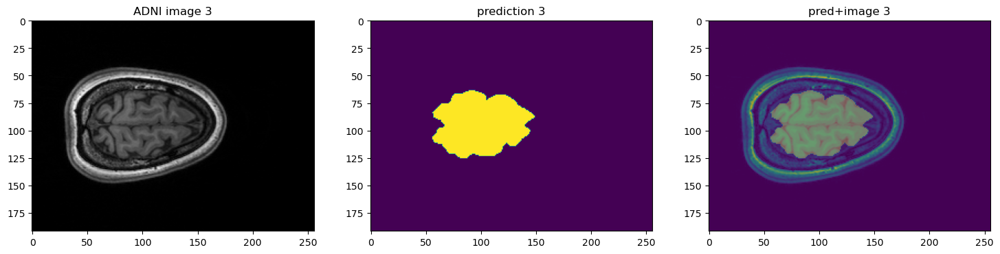

4 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110062_T1w.nii.gz
(1, 192, 256, 256)


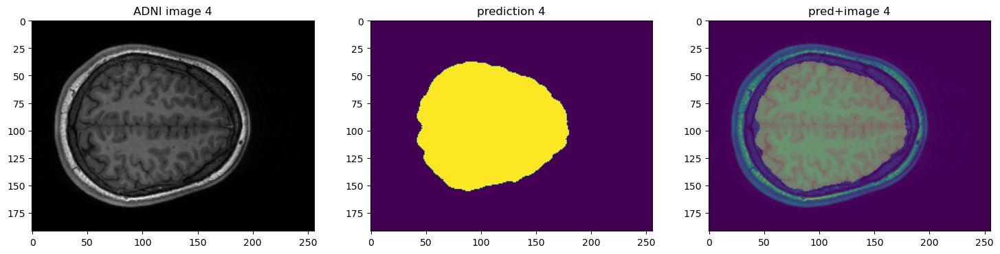

5 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110069_T1w.nii.gz
(1, 192, 256, 256)


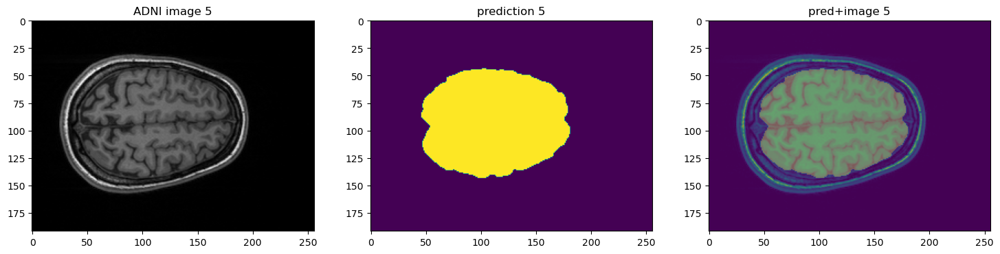

6 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110087_T1w.nii.gz
7 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110098_T1w.nii.gz
8 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110101_T1w.nii.gz
9 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110126_T1w.nii.gz
10 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110174_T1w.nii.gz
11 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110182_T1w.nii.gz
12 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110187_T1w.nii.gz
13 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110319_T1w.nii.gz
14 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110411_T1w.nii.gz
15 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC110606_T1w.nii.gz
16 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC112141_T1w.nii.gz
17 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC120008_T1w.nii.gz
18 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC120049_T1w.nii.gz
19 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC120061_T1w.nii.gz
20 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC120065_T1w.nii.gz
21 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC120120_T1w.nii.gz
22 C:\Users\

138 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC221775_T1w.nii.gz
139 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC221828_T1w.nii.gz
140 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC221886_T1w.nii.gz
141 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC221935_T1w.nii.gz
142 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC221954_T1w.nii.gz
143 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC221977_T1w.nii.gz
144 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC221980_T1w.nii.gz
145 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC222120_T1w.nii.gz
146 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC222125_T1w.nii.gz
147 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC222185_T1w.nii.gz
148 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC222258_T1w.nii.gz
149 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC222264_T1w.nii.gz
150 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC222304_T1w.nii.gz
151 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC222326_T1w.nii.gz
152 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC222367_T1w.nii.gz
153 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC222496_T1w

269 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410032_T1w.nii.gz
270 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410040_T1w.nii.gz
271 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410084_T1w.nii.gz
272 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410086_T1w.nii.gz
273 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410091_T1w.nii.gz
274 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410094_T1w.nii.gz
275 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410097_T1w.nii.gz
276 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410101_T1w.nii.gz
277 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410113_T1w.nii.gz
278 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410119_T1w.nii.gz
279 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410121_T1w.nii.gz
280 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410129_T1w.nii.gz
281 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410169_T1w.nii.gz
282 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410173_T1w.nii.gz
283 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410177_T1w.nii.gz
284 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC410179_T1w

400 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC510486_T1w.nii.gz
401 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC510534_T1w.nii.gz
402 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC510548_T1w.nii.gz
403 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC510551_T1w.nii.gz
404 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC510568_T1w.nii.gz
405 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC510609_T1w.nii.gz
406 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC510629_T1w.nii.gz
407 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC510639_T1w.nii.gz
408 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC510648_T1w.nii.gz
409 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC512003_T1w.nii.gz
410 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC520002_T1w.nii.gz
411 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC520011_T1w.nii.gz
412 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC520013_T1w.nii.gz
413 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC520042_T1w.nii.gz
414 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC520053_T1w.nii.gz
415 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC520055_T1w

531 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620451_T1w.nii.gz
532 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620454_T1w.nii.gz
533 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620466_T1w.nii.gz
534 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620479_T1w.nii.gz
535 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620490_T1w.nii.gz
536 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620496_T1w.nii.gz
537 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620499_T1w.nii.gz
538 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620515_T1w.nii.gz
539 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620518_T1w.nii.gz
540 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620526_T1w.nii.gz
541 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620549_T1w.nii.gz
542 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620557_T1w.nii.gz
543 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620560_T1w.nii.gz
544 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620567_T1w.nii.gz
545 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620572_T1w.nii.gz
546 C:\Users\nehag\Data\camcan_nii_fsl\sub-CC620592_T1w

In [6]:
#14 NOV model - 25 e[pochs 1e-4]
net = Net.load_from_checkpoint(r"C:\Users\nehag\train_seg_results\skull_stripping_logs4\lightning_logs_4\version_1\checkpoints\epoch=24-step=5949.ckpt")

imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Data\\camcan_nii_fsl\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\camcan\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"ADNI image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


# 5. BRAINMIND

47
0 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC001.nii.gz
(1, 176, 256, 256)


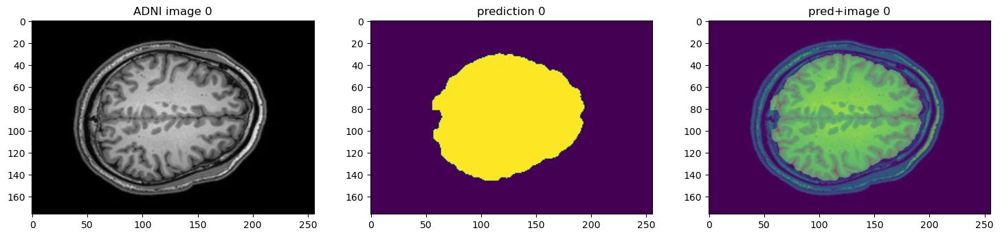

1 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC002.nii.gz
(1, 176, 256, 256)


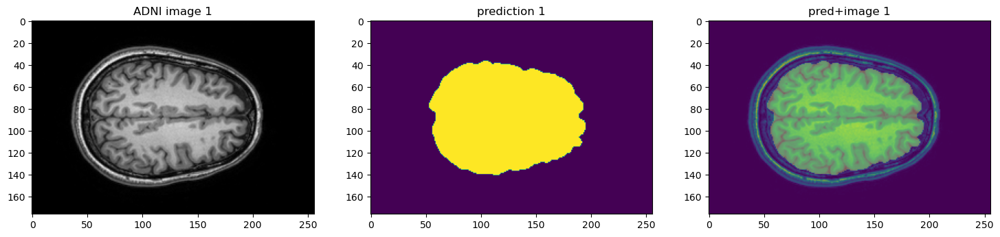

2 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC003.nii.gz
(1, 176, 256, 256)


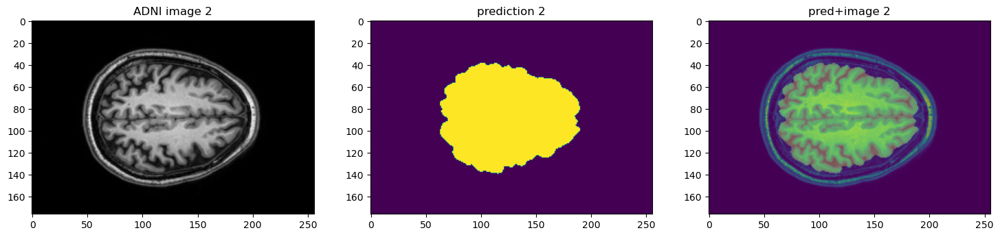

3 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC004.nii.gz
(1, 176, 256, 256)


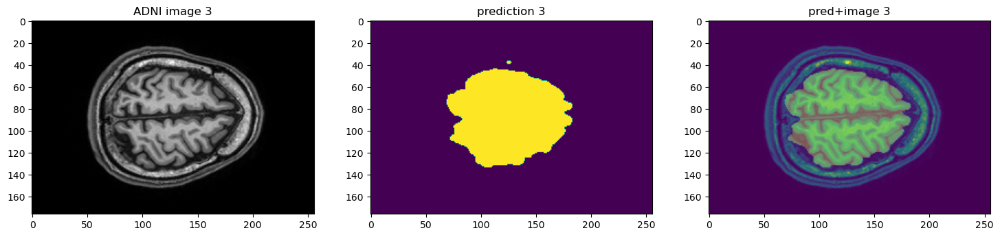

4 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC005.nii.gz
(1, 176, 256, 256)


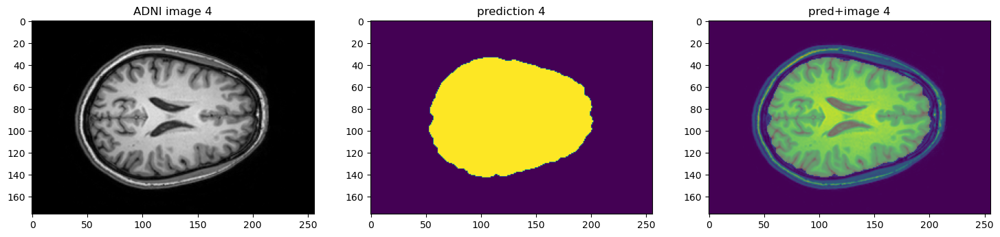

5 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC006.nii.gz
(1, 176, 256, 256)


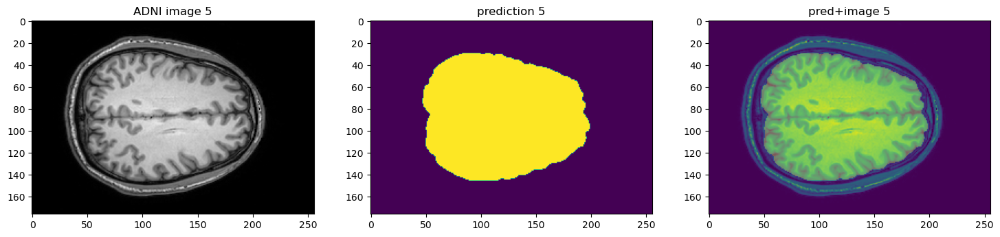

6 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC007.nii.gz
7 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC008.nii.gz
8 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC009.nii.gz
9 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC010.nii.gz
10 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC011.nii.gz
11 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC012.nii.gz
12 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC013.nii.gz
13 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC014.nii.gz
14 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC015.nii.gz
15 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC016.nii.gz
16 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC017.nii.gz
17 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC018.nii.gz
18 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC019.nii.gz
19 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC020.nii.gz
20 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC021.nii.gz
21 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC022.nii.gz
22 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC023.nii.gz
23 C:\Users\nehag\Data\brainmind_nii_fsl\B_HC024.nii

In [7]:
#14 NOV model - 25 e[pochs 1e-4]
net = Net.load_from_checkpoint(r"C:\Users\nehag\train_seg_results\skull_stripping_logs4\lightning_logs_4\version_1\checkpoints\epoch=24-step=5949.ckpt")

imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Data\\brainmind_nii_fsl\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\brainminds\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"ADNI image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


# 6. PARKINSONS

36
0 C:\Users\nehag\Data\parkinsons_fsl\sub-control032014_T1w.nii.gz
(1, 176, 224, 208)


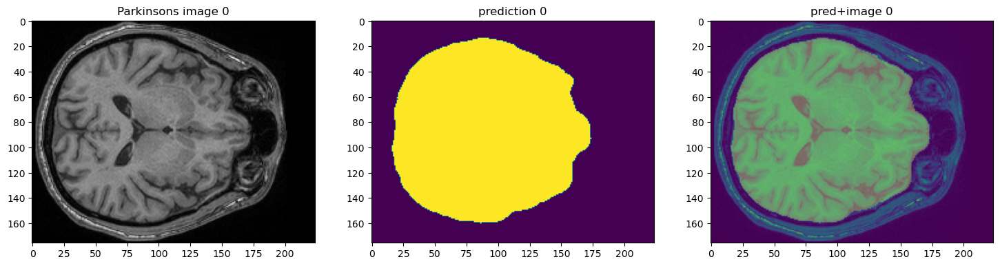

1 C:\Users\nehag\Data\parkinsons_fsl\sub-control032015_T1w.nii.gz
(1, 176, 240, 208)


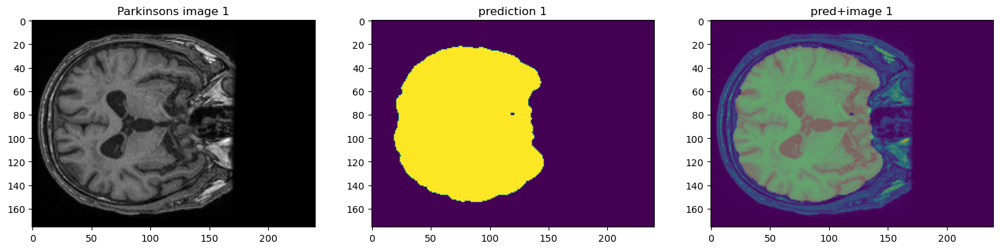

2 C:\Users\nehag\Data\parkinsons_fsl\sub-control032016_T1w.nii.gz
(1, 176, 224, 208)


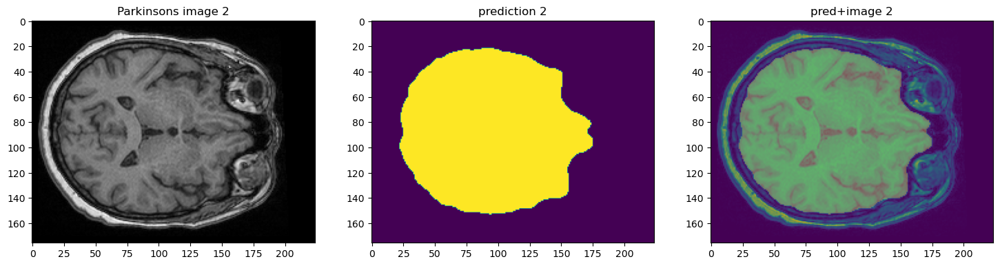

3 C:\Users\nehag\Data\parkinsons_fsl\sub-control032017_T1w.nii.gz
(1, 176, 208, 208)


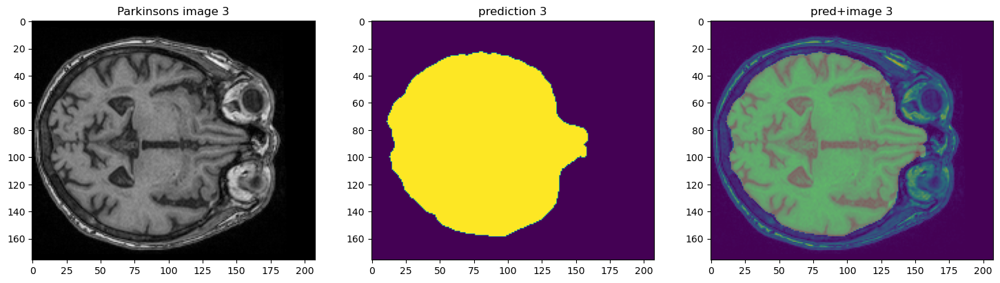

4 C:\Users\nehag\Data\parkinsons_fsl\sub-control032018_T1w.nii.gz
(1, 160, 208, 208)


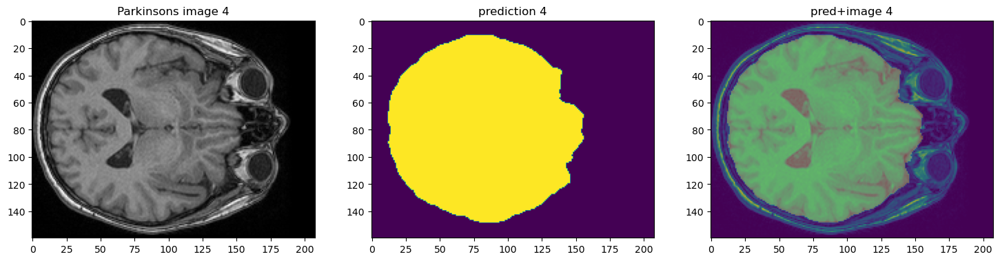

5 C:\Users\nehag\Data\parkinsons_fsl\sub-control032019_T1w.nii.gz
(1, 176, 208, 160)


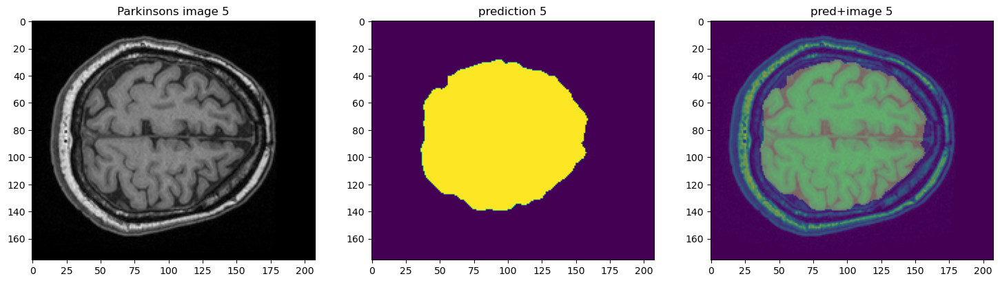

6 C:\Users\nehag\Data\parkinsons_fsl\sub-control032020_T1w.nii.gz
7 C:\Users\nehag\Data\parkinsons_fsl\sub-control032021_T1w.nii.gz
8 C:\Users\nehag\Data\parkinsons_fsl\sub-control032022_T1w.nii.gz
9 C:\Users\nehag\Data\parkinsons_fsl\sub-control032023_T1w.nii.gz
10 C:\Users\nehag\Data\parkinsons_fsl\sub-control032024_T1w.nii.gz
11 C:\Users\nehag\Data\parkinsons_fsl\sub-control032025_T1w.nii.gz
12 C:\Users\nehag\Data\parkinsons_fsl\sub-control032026_T1w.nii.gz
13 C:\Users\nehag\Data\parkinsons_fsl\sub-control032027_T1w.nii.gz
14 C:\Users\nehag\Data\parkinsons_fsl\sub-control032028_T1w.nii.gz
15 C:\Users\nehag\Data\parkinsons_fsl\sub-control032029_T1w.nii.gz
16 C:\Users\nehag\Data\parkinsons_fsl\sub-control032057_T1w.nii.gz
17 C:\Users\nehag\Data\parkinsons_fsl\sub-control032058_T1w.nii.gz
18 C:\Users\nehag\Data\parkinsons_fsl\sub-control032059_T1w.nii.gz
19 C:\Users\nehag\Data\parkinsons_fsl\sub-control032060_T1w.nii.gz
20 C:\Users\nehag\Data\parkinsons_fsl\sub-control032061_T1w.nii.gz

In [9]:
#14 NOV model - 25 e[pochs 1e-4]
net = Net.load_from_checkpoint(r"C:\Users\nehag\train_seg_results\skull_stripping_logs4\lightning_logs_4\version_1\checkpoints\epoch=24-step=5949.ckpt")

imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Data\\parkinsons_fsl\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\parkinsons\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"Parkinsons image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 120], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 120])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 120])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 120], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


# 7. CC359

359
0 C:\Users\nehag\Data\CC359_nii_fsl\CC0001_philips_15_55_M.nii.gz
(1, 176, 256, 256)


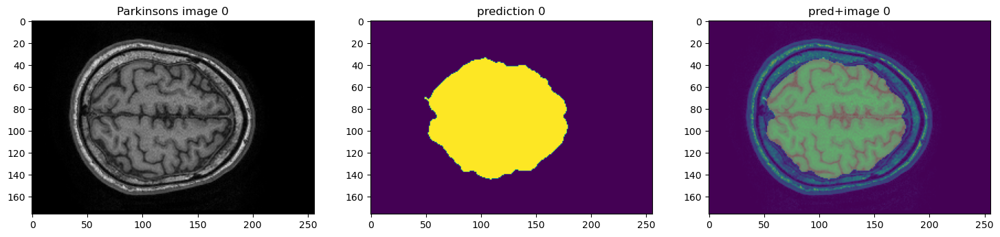

1 C:\Users\nehag\Data\CC359_nii_fsl\CC0002_philips_15_56_M.nii.gz
(1, 160, 288, 288)


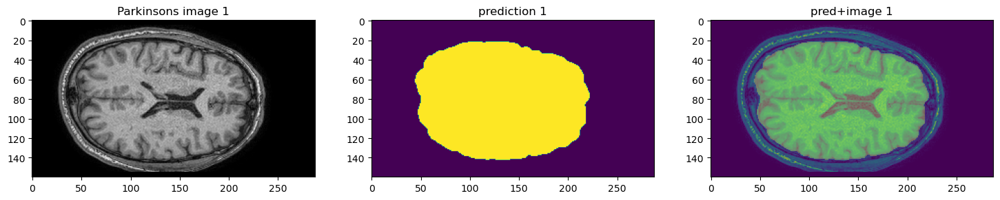

2 C:\Users\nehag\Data\CC359_nii_fsl\CC0003_philips_15_63_F.nii.gz
(1, 160, 288, 288)


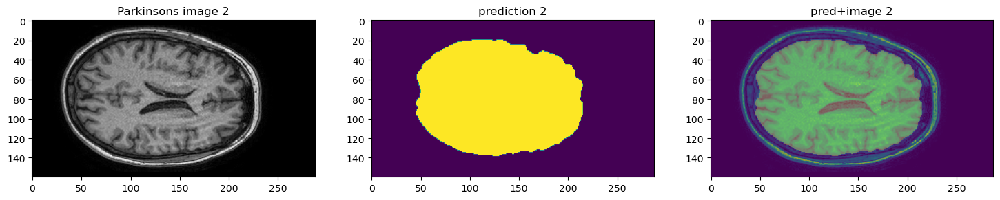

3 C:\Users\nehag\Data\CC359_nii_fsl\CC0004_philips_15_67_M.nii.gz
(1, 176, 288, 288)


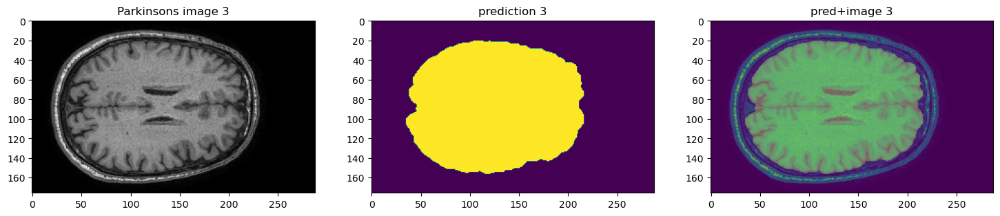

4 C:\Users\nehag\Data\CC359_nii_fsl\CC0005_philips_15_62_M.nii.gz
(1, 160, 288, 288)


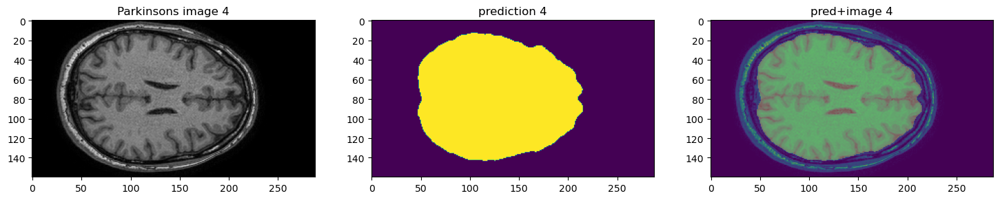

5 C:\Users\nehag\Data\CC359_nii_fsl\CC0006_philips_15_63_F.nii.gz
(1, 160, 288, 288)


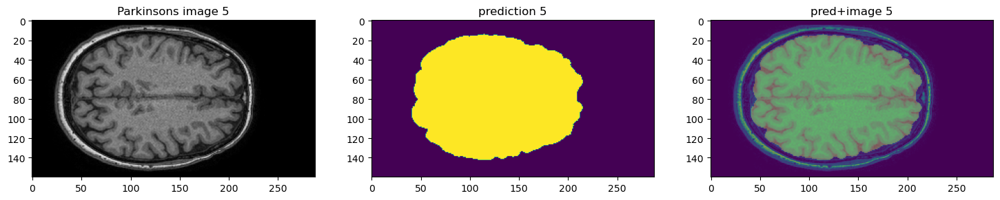

6 C:\Users\nehag\Data\CC359_nii_fsl\CC0007_philips_15_62_M.nii.gz
7 C:\Users\nehag\Data\CC359_nii_fsl\CC0008_philips_15_60_F.nii.gz
8 C:\Users\nehag\Data\CC359_nii_fsl\CC0009_philips_15_69_M.nii.gz
9 C:\Users\nehag\Data\CC359_nii_fsl\CC0010_philips_15_69_F.nii.gz
10 C:\Users\nehag\Data\CC359_nii_fsl\CC0011_philips_15_49_F.nii.gz
11 C:\Users\nehag\Data\CC359_nii_fsl\CC0012_philips_15_43_M.nii.gz
12 C:\Users\nehag\Data\CC359_nii_fsl\CC0013_philips_15_66_M.nii.gz
13 C:\Users\nehag\Data\CC359_nii_fsl\CC0014_philips_15_62_F.nii.gz
14 C:\Users\nehag\Data\CC359_nii_fsl\CC0015_philips_15_44_M.nii.gz
15 C:\Users\nehag\Data\CC359_nii_fsl\CC0016_philips_15_55_M.nii.gz
16 C:\Users\nehag\Data\CC359_nii_fsl\CC0017_philips_15_50_F.nii.gz
17 C:\Users\nehag\Data\CC359_nii_fsl\CC0018_philips_15_41_F.nii.gz
18 C:\Users\nehag\Data\CC359_nii_fsl\CC0019_philips_15_57_F.nii.gz
19 C:\Users\nehag\Data\CC359_nii_fsl\CC0020_philips_15_65_F.nii.gz
20 C:\Users\nehag\Data\CC359_nii_fsl\CC0021_philips_15_48_F.nii.gz

129 C:\Users\nehag\Data\CC359_nii_fsl\CC0130_siemens_15_57_F.nii.gz
130 C:\Users\nehag\Data\CC359_nii_fsl\CC0131_siemens_15_41_M.nii.gz
131 C:\Users\nehag\Data\CC359_nii_fsl\CC0132_siemens_15_71_F.nii.gz
132 C:\Users\nehag\Data\CC359_nii_fsl\CC0133_siemens_15_64_F.nii.gz
133 C:\Users\nehag\Data\CC359_nii_fsl\CC0134_siemens_15_54_F.nii.gz
134 C:\Users\nehag\Data\CC359_nii_fsl\CC0135_siemens_15_52_M.nii.gz
135 C:\Users\nehag\Data\CC359_nii_fsl\CC0136_siemens_15_64_F.nii.gz
136 C:\Users\nehag\Data\CC359_nii_fsl\CC0137_siemens_15_65_F.nii.gz
137 C:\Users\nehag\Data\CC359_nii_fsl\CC0138_siemens_15_56_F.nii.gz
138 C:\Users\nehag\Data\CC359_nii_fsl\CC0139_siemens_15_56_M.nii.gz
139 C:\Users\nehag\Data\CC359_nii_fsl\CC0140_siemens_15_57_M.nii.gz
140 C:\Users\nehag\Data\CC359_nii_fsl\CC0141_siemens_15_53_F.nii.gz
141 C:\Users\nehag\Data\CC359_nii_fsl\CC0142_siemens_15_59_M.nii.gz
142 C:\Users\nehag\Data\CC359_nii_fsl\CC0143_siemens_15_55_F.nii.gz
143 C:\Users\nehag\Data\CC359_nii_fsl\CC0144_sie

252 C:\Users\nehag\Data\CC359_nii_fsl\CC0253_ge_15_58_M.nii.gz
253 C:\Users\nehag\Data\CC359_nii_fsl\CC0254_ge_15_57_F.nii.gz
254 C:\Users\nehag\Data\CC359_nii_fsl\CC0255_ge_15_57_F.nii.gz
255 C:\Users\nehag\Data\CC359_nii_fsl\CC0256_ge_15_42_M.nii.gz
256 C:\Users\nehag\Data\CC359_nii_fsl\CC0257_ge_15_57_F.nii.gz
257 C:\Users\nehag\Data\CC359_nii_fsl\CC0258_ge_15_55_F.nii.gz
258 C:\Users\nehag\Data\CC359_nii_fsl\CC0259_ge_15_56_F.nii.gz
259 C:\Users\nehag\Data\CC359_nii_fsl\CC0260_ge_15_51_M.nii.gz
260 C:\Users\nehag\Data\CC359_nii_fsl\CC0261_ge_15_59_F.nii.gz
261 C:\Users\nehag\Data\CC359_nii_fsl\CC0262_ge_15_54_M.nii.gz
262 C:\Users\nehag\Data\CC359_nii_fsl\CC0263_ge_15_51_M.nii.gz
263 C:\Users\nehag\Data\CC359_nii_fsl\CC0264_ge_15_59_F.nii.gz
264 C:\Users\nehag\Data\CC359_nii_fsl\CC0265_ge_15_56_F.nii.gz
265 C:\Users\nehag\Data\CC359_nii_fsl\CC0266_ge_15_57_M.nii.gz
266 C:\Users\nehag\Data\CC359_nii_fsl\CC0267_ge_15_60_F.nii.gz
267 C:\Users\nehag\Data\CC359_nii_fsl\CC0268_ge_15_57_F

In [10]:
#14 NOV model - 25 e[pochs 1e-4]
net = Net.load_from_checkpoint(r"C:\Users\nehag\train_seg_results\skull_stripping_logs4\lightning_logs_4\version_1\checkpoints\epoch=24-step=5949.ckpt")

imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Data\\CC359_nii_fsl\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\CC359\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"Parkinsons image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


# 8. OASIS

436
0 C:\Users\nehag\Data\oasis_fsl\OAS1_0001_MR1_mpr_n4_anon_sbj_111.nii.gz
(1, 160, 256, 256)


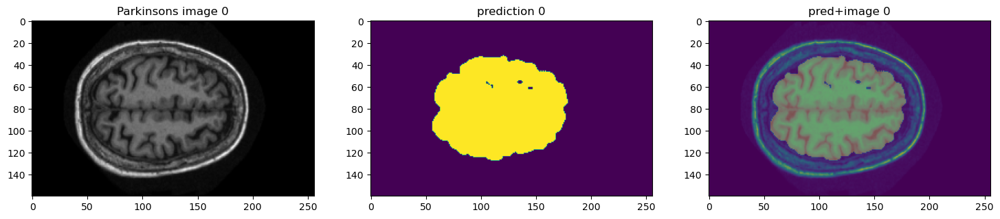

1 C:\Users\nehag\Data\oasis_fsl\OAS1_0002_MR1_mpr_n4_anon_sbj_111.nii.gz
(1, 160, 256, 256)


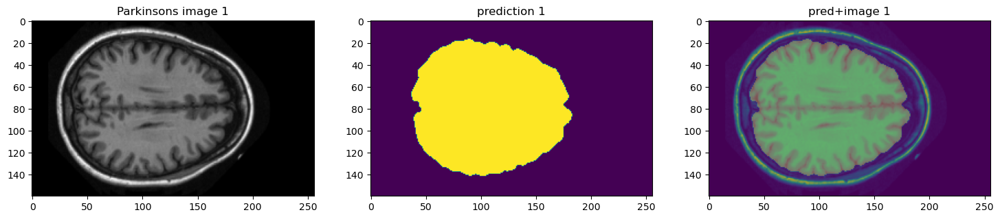

2 C:\Users\nehag\Data\oasis_fsl\OAS1_0003_MR1_mpr_n4_anon_sbj_111.nii.gz
(1, 160, 256, 256)


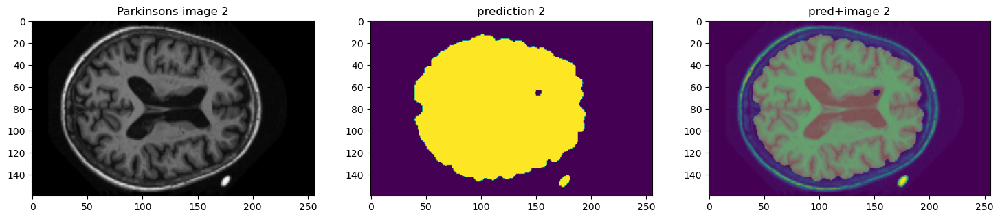

3 C:\Users\nehag\Data\oasis_fsl\OAS1_0004_MR1_mpr_n4_anon_sbj_111.nii.gz
(1, 160, 256, 256)


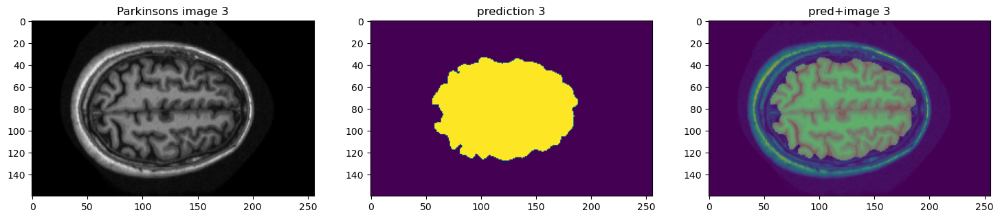

4 C:\Users\nehag\Data\oasis_fsl\OAS1_0005_MR1_mpr_n4_anon_sbj_111.nii.gz
(1, 160, 256, 256)


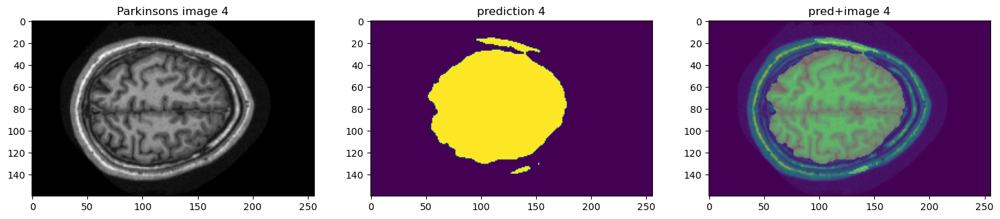

5 C:\Users\nehag\Data\oasis_fsl\OAS1_0006_MR1_mpr_n4_anon_sbj_111.nii.gz
(1, 160, 256, 256)


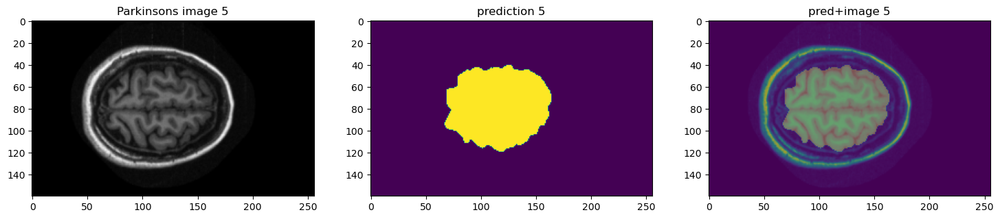

6 C:\Users\nehag\Data\oasis_fsl\OAS1_0007_MR1_mpr_n3_anon_sbj_111.nii.gz
7 C:\Users\nehag\Data\oasis_fsl\OAS1_0009_MR1_mpr_n4_anon_sbj_111.nii.gz
8 C:\Users\nehag\Data\oasis_fsl\OAS1_0010_MR1_mpr_n4_anon_sbj_111.nii.gz
9 C:\Users\nehag\Data\oasis_fsl\OAS1_0011_MR1_mpr_n4_anon_sbj_111.nii.gz
10 C:\Users\nehag\Data\oasis_fsl\OAS1_0012_MR1_mpr_n4_anon_sbj_111.nii.gz
11 C:\Users\nehag\Data\oasis_fsl\OAS1_0013_MR1_mpr_n4_anon_sbj_111.nii.gz
12 C:\Users\nehag\Data\oasis_fsl\OAS1_0014_MR1_mpr_n4_anon_sbj_111.nii.gz
13 C:\Users\nehag\Data\oasis_fsl\OAS1_0015_MR1_mpr_n3_anon_sbj_111.nii.gz
14 C:\Users\nehag\Data\oasis_fsl\OAS1_0016_MR1_mpr_n3_anon_sbj_111.nii.gz
15 C:\Users\nehag\Data\oasis_fsl\OAS1_0017_MR1_mpr_n4_anon_sbj_111.nii.gz
16 C:\Users\nehag\Data\oasis_fsl\OAS1_0018_MR1_mpr_n4_anon_sbj_111.nii.gz
17 C:\Users\nehag\Data\oasis_fsl\OAS1_0019_MR1_mpr_n4_anon_sbj_111.nii.gz
18 C:\Users\nehag\Data\oasis_fsl\OAS1_0020_MR1_mpr_n3_anon_sbj_111.nii.gz
19 C:\Users\nehag\Data\oasis_fsl\OAS1_0021

117 C:\Users\nehag\Data\oasis_fsl\OAS1_0120_MR1_mpr_n4_anon_sbj_111.nii.gz
118 C:\Users\nehag\Data\oasis_fsl\OAS1_0121_MR1_mpr_n4_anon_sbj_111.nii.gz
119 C:\Users\nehag\Data\oasis_fsl\OAS1_0122_MR1_mpr_n4_anon_sbj_111.nii.gz
120 C:\Users\nehag\Data\oasis_fsl\OAS1_0123_MR1_mpr_n4_anon_sbj_111.nii.gz
121 C:\Users\nehag\Data\oasis_fsl\OAS1_0124_MR1_mpr_n4_anon_sbj_111.nii.gz
122 C:\Users\nehag\Data\oasis_fsl\OAS1_0125_MR1_mpr_n4_anon_sbj_111.nii.gz
123 C:\Users\nehag\Data\oasis_fsl\OAS1_0126_MR1_mpr_n3_anon_sbj_111.nii.gz
124 C:\Users\nehag\Data\oasis_fsl\OAS1_0127_MR1_mpr_n3_anon_sbj_111.nii.gz
125 C:\Users\nehag\Data\oasis_fsl\OAS1_0129_MR1_mpr_n4_fdcanon_sbj_111.4dfp.nii.gz
126 C:\Users\nehag\Data\oasis_fsl\OAS1_0130_MR1_mpr_n4_anon_sbj_111.nii.gz
127 C:\Users\nehag\Data\oasis_fsl\OAS1_0131_MR1_mpr_n4_anon_sbj_111.nii.gz
128 C:\Users\nehag\Data\oasis_fsl\OAS1_0132_MR1_mpr_n4_anon_sbj_111.nii.gz
129 C:\Users\nehag\Data\oasis_fsl\OAS1_0133_MR1_mpr_n4_anon_sbj_111.nii.gz
130 C:\Users\neha

227 C:\Users\nehag\Data\oasis_fsl\OAS1_0236_MR1_mpr_n4_anon_sbj_111.nii.gz
228 C:\Users\nehag\Data\oasis_fsl\OAS1_0236_MR2_mpr_n4_anon_sbj_111.nii.gz
229 C:\Users\nehag\Data\oasis_fsl\OAS1_0237_MR1_mpr_n4_anon_sbj_111.nii.gz
230 C:\Users\nehag\Data\oasis_fsl\OAS1_0238_MR1_mpr_n4_anon_sbj_111.nii.gz
231 C:\Users\nehag\Data\oasis_fsl\OAS1_0239_MR1_mpr_n4_anon_sbj_111.nii.gz
232 C:\Users\nehag\Data\oasis_fsl\OAS1_0239_MR2_mpr_n4_anon_sbj_111.nii.gz
233 C:\Users\nehag\Data\oasis_fsl\OAS1_0240_MR1_mpr_n3_anon_sbj_111.nii.gz
234 C:\Users\nehag\Data\oasis_fsl\OAS1_0241_MR1_mpr_n4_anon_sbj_111.nii.gz
235 C:\Users\nehag\Data\oasis_fsl\OAS1_0243_MR1_mpr_n4_anon_sbj_111.nii.gz
236 C:\Users\nehag\Data\oasis_fsl\OAS1_0244_MR1_mpr_n4_anon_sbj_111.nii.gz
237 C:\Users\nehag\Data\oasis_fsl\OAS1_0246_MR1_mpr_n4_anon_sbj_111.nii.gz
238 C:\Users\nehag\Data\oasis_fsl\OAS1_0247_MR1_mpr_n4_anon_sbj_111.nii.gz
239 C:\Users\nehag\Data\oasis_fsl\OAS1_0249_MR1_mpr_n4_anon_sbj_111.nii.gz
240 C:\Users\nehag\Data\o

337 C:\Users\nehag\Data\oasis_fsl\OAS1_0354_MR1_mpr_n4_anon_sbj_111.nii.gz
338 C:\Users\nehag\Data\oasis_fsl\OAS1_0355_MR1_mpr_n4_anon_sbj_111.nii.gz
339 C:\Users\nehag\Data\oasis_fsl\OAS1_0356_MR1_mpr_n4_anon_sbj_111.nii.gz
340 C:\Users\nehag\Data\oasis_fsl\OAS1_0357_MR1_mpr_n4_anon_sbj_111.nii.gz
341 C:\Users\nehag\Data\oasis_fsl\OAS1_0358_MR1_mpr_n4_anon_sbj_111.nii.gz
342 C:\Users\nehag\Data\oasis_fsl\OAS1_0359_MR1_mpr_n4_anon_sbj_111.nii.gz
343 C:\Users\nehag\Data\oasis_fsl\OAS1_0361_MR1_mpr_n4_anon_sbj_111.nii.gz
344 C:\Users\nehag\Data\oasis_fsl\OAS1_0362_MR1_mpr_n4_anon_sbj_111.nii.gz
345 C:\Users\nehag\Data\oasis_fsl\OAS1_0363_MR1_mpr_n4_anon_sbj_111.nii.gz
346 C:\Users\nehag\Data\oasis_fsl\OAS1_0365_MR1_mpr_n4_anon_sbj_111.nii.gz
347 C:\Users\nehag\Data\oasis_fsl\OAS1_0366_MR1_mpr_n4_anon_sbj_111.nii.gz
348 C:\Users\nehag\Data\oasis_fsl\OAS1_0367_MR1_mpr_n4_anon_sbj_111.nii.gz
349 C:\Users\nehag\Data\oasis_fsl\OAS1_0368_MR1_mpr_n4_anon_sbj_111.nii.gz
350 C:\Users\nehag\Data\o

In [11]:
#14 NOV model - 25 e[pochs 1e-4]
net = Net.load_from_checkpoint(r"C:\Users\nehag\train_seg_results\skull_stripping_logs4\lightning_logs_4\version_1\checkpoints\epoch=24-step=5949.ckpt")

imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Data\\oasis_fsl\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\oasis\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"Parkinsons image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


# 9. SALD

494
0 C:\Users\nehag\Data\sald_fsl\sub-031274_T1w.nii.gz
(1, 176, 256, 256)


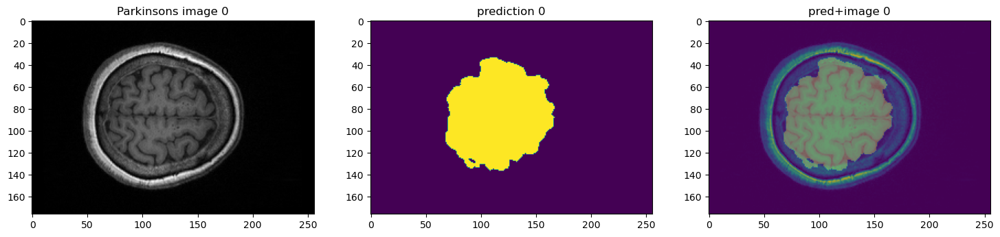

1 C:\Users\nehag\Data\sald_fsl\sub-031275_T1w.nii.gz
(1, 176, 256, 256)


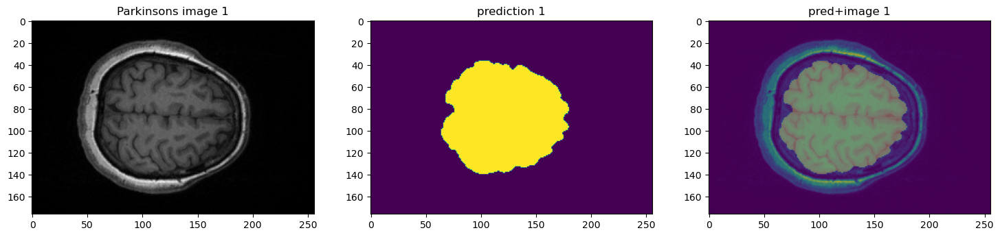

2 C:\Users\nehag\Data\sald_fsl\sub-031276_T1w.nii.gz
(1, 176, 256, 256)


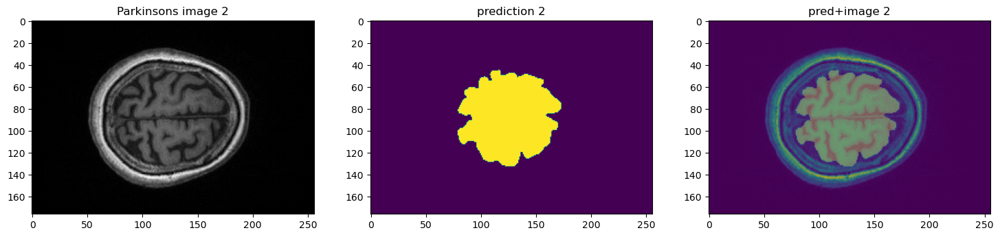

3 C:\Users\nehag\Data\sald_fsl\sub-031277_T1w.nii.gz
(1, 176, 256, 256)


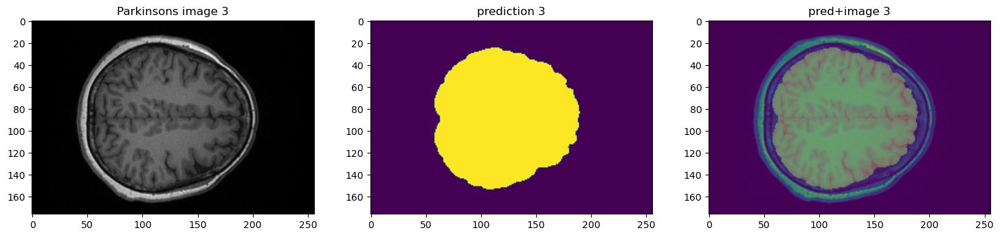

4 C:\Users\nehag\Data\sald_fsl\sub-031278_T1w.nii.gz
(1, 176, 256, 256)


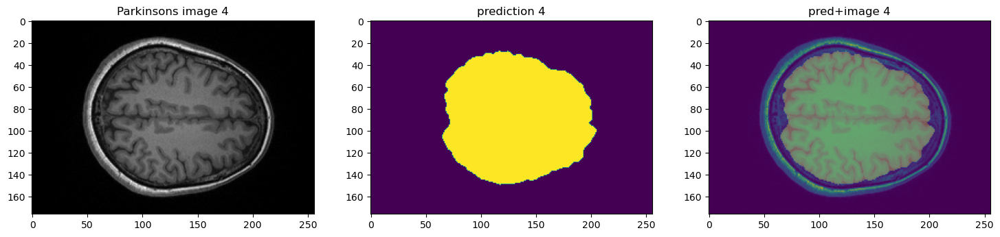

5 C:\Users\nehag\Data\sald_fsl\sub-031279_T1w.nii.gz
(1, 176, 256, 256)


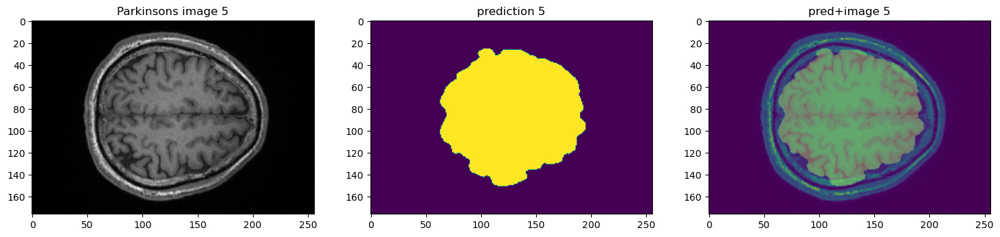

6 C:\Users\nehag\Data\sald_fsl\sub-031280_T1w.nii.gz
7 C:\Users\nehag\Data\sald_fsl\sub-031281_T1w.nii.gz
8 C:\Users\nehag\Data\sald_fsl\sub-031282_T1w.nii.gz
9 C:\Users\nehag\Data\sald_fsl\sub-031283_T1w.nii.gz
10 C:\Users\nehag\Data\sald_fsl\sub-031284_T1w.nii.gz
11 C:\Users\nehag\Data\sald_fsl\sub-031285_T1w.nii.gz
12 C:\Users\nehag\Data\sald_fsl\sub-031286_T1w.nii.gz
13 C:\Users\nehag\Data\sald_fsl\sub-031287_T1w.nii.gz
14 C:\Users\nehag\Data\sald_fsl\sub-031288_T1w.nii.gz
15 C:\Users\nehag\Data\sald_fsl\sub-031289_T1w.nii.gz
16 C:\Users\nehag\Data\sald_fsl\sub-031290_T1w.nii.gz
17 C:\Users\nehag\Data\sald_fsl\sub-031291_T1w.nii.gz
18 C:\Users\nehag\Data\sald_fsl\sub-031292_T1w.nii.gz
19 C:\Users\nehag\Data\sald_fsl\sub-031293_T1w.nii.gz
20 C:\Users\nehag\Data\sald_fsl\sub-031294_T1w.nii.gz
21 C:\Users\nehag\Data\sald_fsl\sub-031295_T1w.nii.gz
22 C:\Users\nehag\Data\sald_fsl\sub-031296_T1w.nii.gz
23 C:\Users\nehag\Data\sald_fsl\sub-031297_T1w.nii.gz
24 C:\Users\nehag\Data\sald_fsl\

157 C:\Users\nehag\Data\sald_fsl\sub-031431_T1w.nii.gz
158 C:\Users\nehag\Data\sald_fsl\sub-031432_T1w.nii.gz
159 C:\Users\nehag\Data\sald_fsl\sub-031433_T1w.nii.gz
160 C:\Users\nehag\Data\sald_fsl\sub-031434_T1w.nii.gz
161 C:\Users\nehag\Data\sald_fsl\sub-031435_T1w.nii.gz
162 C:\Users\nehag\Data\sald_fsl\sub-031436_T1w.nii.gz
163 C:\Users\nehag\Data\sald_fsl\sub-031437_T1w.nii.gz
164 C:\Users\nehag\Data\sald_fsl\sub-031438_T1w.nii.gz
165 C:\Users\nehag\Data\sald_fsl\sub-031439_T1w.nii.gz
166 C:\Users\nehag\Data\sald_fsl\sub-031440_T1w.nii.gz
167 C:\Users\nehag\Data\sald_fsl\sub-031441_T1w.nii.gz
168 C:\Users\nehag\Data\sald_fsl\sub-031442_T1w.nii.gz
169 C:\Users\nehag\Data\sald_fsl\sub-031443_T1w.nii.gz
170 C:\Users\nehag\Data\sald_fsl\sub-031444_T1w.nii.gz
171 C:\Users\nehag\Data\sald_fsl\sub-031445_T1w.nii.gz
172 C:\Users\nehag\Data\sald_fsl\sub-031446_T1w.nii.gz
173 C:\Users\nehag\Data\sald_fsl\sub-031447_T1w.nii.gz
174 C:\Users\nehag\Data\sald_fsl\sub-031448_T1w.nii.gz
175 C:\Use

306 C:\Users\nehag\Data\sald_fsl\sub-031580_T1w.nii.gz
307 C:\Users\nehag\Data\sald_fsl\sub-031581_T1w.nii.gz
308 C:\Users\nehag\Data\sald_fsl\sub-031582_T1w.nii.gz
309 C:\Users\nehag\Data\sald_fsl\sub-031583_T1w.nii.gz
310 C:\Users\nehag\Data\sald_fsl\sub-031584_T1w.nii.gz
311 C:\Users\nehag\Data\sald_fsl\sub-031585_T1w.nii.gz
312 C:\Users\nehag\Data\sald_fsl\sub-031586_T1w.nii.gz
313 C:\Users\nehag\Data\sald_fsl\sub-031587_T1w.nii.gz
314 C:\Users\nehag\Data\sald_fsl\sub-031588_T1w.nii.gz
315 C:\Users\nehag\Data\sald_fsl\sub-031589_T1w.nii.gz
316 C:\Users\nehag\Data\sald_fsl\sub-031590_T1w.nii.gz
317 C:\Users\nehag\Data\sald_fsl\sub-031591_T1w.nii.gz
318 C:\Users\nehag\Data\sald_fsl\sub-031592_T1w.nii.gz
319 C:\Users\nehag\Data\sald_fsl\sub-031593_T1w.nii.gz
320 C:\Users\nehag\Data\sald_fsl\sub-031594_T1w.nii.gz
321 C:\Users\nehag\Data\sald_fsl\sub-031595_T1w.nii.gz
322 C:\Users\nehag\Data\sald_fsl\sub-031596_T1w.nii.gz
323 C:\Users\nehag\Data\sald_fsl\sub-031597_T1w.nii.gz
324 C:\Use

455 C:\Users\nehag\Data\sald_fsl\sub-031729_T1w.nii.gz
456 C:\Users\nehag\Data\sald_fsl\sub-031730_T1w.nii.gz
457 C:\Users\nehag\Data\sald_fsl\sub-031731_T1w.nii.gz
458 C:\Users\nehag\Data\sald_fsl\sub-031732_T1w.nii.gz
459 C:\Users\nehag\Data\sald_fsl\sub-031733_T1w.nii.gz
460 C:\Users\nehag\Data\sald_fsl\sub-031734_T1w.nii.gz
461 C:\Users\nehag\Data\sald_fsl\sub-031735_T1w.nii.gz
462 C:\Users\nehag\Data\sald_fsl\sub-031736_T1w.nii.gz
463 C:\Users\nehag\Data\sald_fsl\sub-031737_T1w.nii.gz
464 C:\Users\nehag\Data\sald_fsl\sub-031738_T1w.nii.gz
465 C:\Users\nehag\Data\sald_fsl\sub-031739_T1w.nii.gz
466 C:\Users\nehag\Data\sald_fsl\sub-031740_T1w.nii.gz
467 C:\Users\nehag\Data\sald_fsl\sub-031741_T1w.nii.gz
468 C:\Users\nehag\Data\sald_fsl\sub-031742_T1w.nii.gz
469 C:\Users\nehag\Data\sald_fsl\sub-031743_T1w.nii.gz
470 C:\Users\nehag\Data\sald_fsl\sub-031744_T1w.nii.gz
471 C:\Users\nehag\Data\sald_fsl\sub-031745_T1w.nii.gz
472 C:\Users\nehag\Data\sald_fsl\sub-031746_T1w.nii.gz
473 C:\Use

In [12]:
#14 NOV model - 25 e[pochs 1e-4]
net = Net.load_from_checkpoint(r"C:\Users\nehag\train_seg_results\skull_stripping_logs4\lightning_logs_4\version_1\checkpoints\epoch=24-step=5949.ckpt")

imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Data\\sald_fsl\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\sald\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"Parkinsons image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


# extra rough work

426
0 C:\Users\nehag\Data\normative\NORM100_REP11_RF_T1_3.nii
(1, 256, 256, 176)


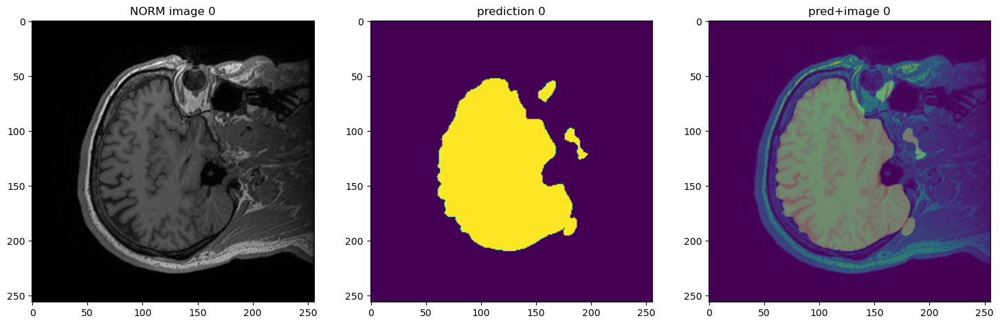

1 C:\Users\nehag\Data\normative\NORM100_REP12_RF_T1_3.nii
(1, 256, 256, 176)


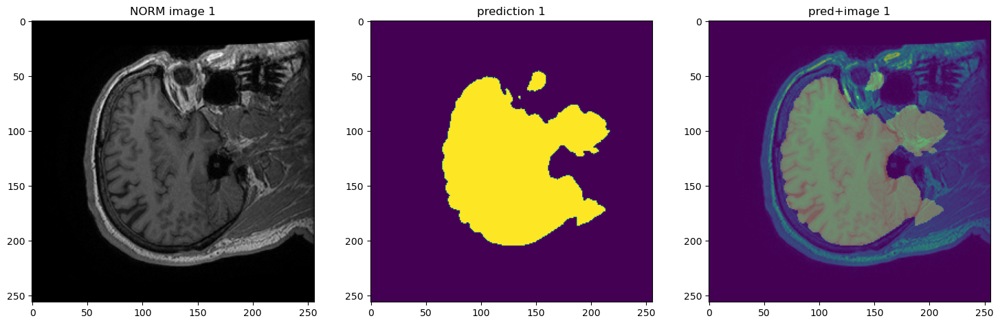

2 C:\Users\nehag\Data\normative\NORM100_REP13_RF_T1_13.nii
(1, 256, 256, 176)


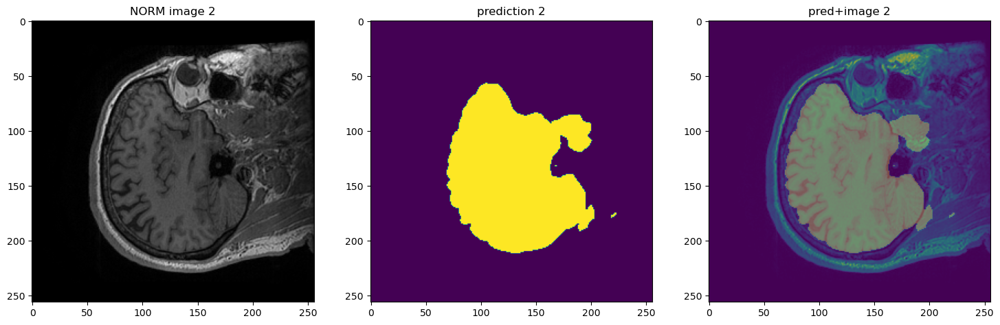

3 C:\Users\nehag\Data\normative\NORM100_REP13_RF_T1_3.nii
(1, 256, 256, 176)


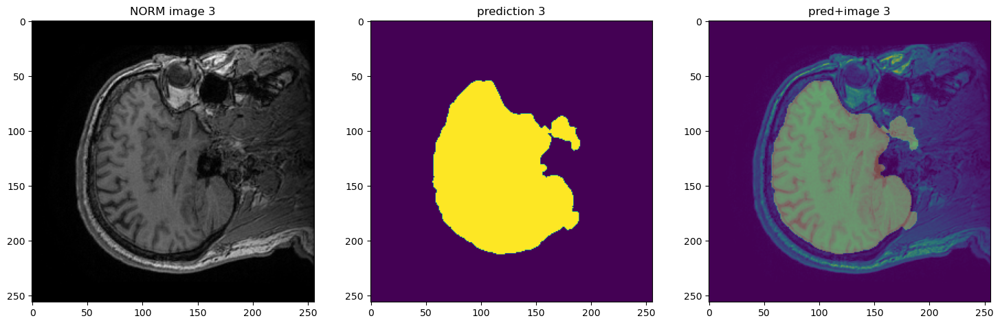

4 C:\Users\nehag\Data\normative\NORM100_REP14_RF_T1_13.nii
(1, 256, 256, 176)


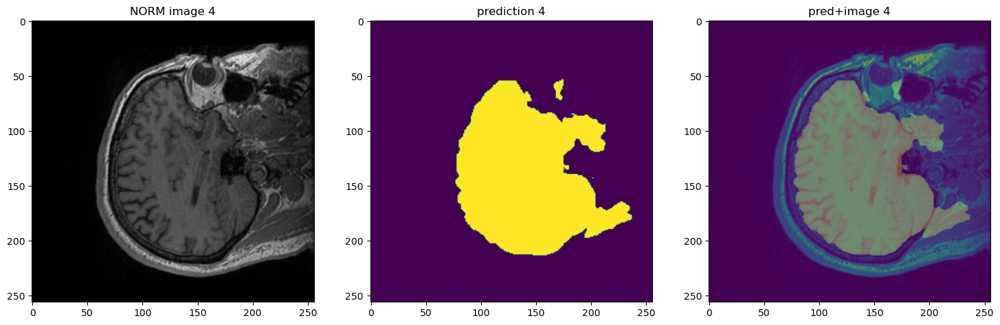

5 C:\Users\nehag\Data\normative\NORM100_REP14_RF_T1_3.nii
(1, 256, 256, 176)


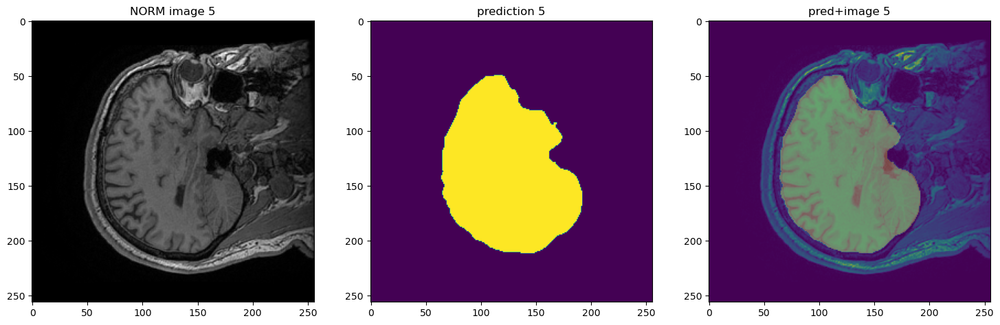

6 C:\Users\nehag\Data\normative\NORM100_REP15_RF_T1_13.nii
7 C:\Users\nehag\Data\normative\NORM100_REP15_RF_T1_3.nii
8 C:\Users\nehag\Data\normative\NORM100_REP2_RF_T1_4.nii
9 C:\Users\nehag\Data\normative\NORM100_REP3_RF_T1_4.nii
10 C:\Users\nehag\Data\normative\NORM100_REP4_RF_T1_3.nii
11 C:\Users\nehag\Data\normative\NORM100_REP5_RF_T1_3.nii
12 C:\Users\nehag\Data\normative\NORM100_REP6_RF_T1_5.nii
13 C:\Users\nehag\Data\normative\NORM100_REP7_RF_T1_3.nii
14 C:\Users\nehag\Data\normative\NORM100_REP8_RF_T1_3.nii
15 C:\Users\nehag\Data\normative\NORM100_REP9_RF_T1_3.nii
16 C:\Users\nehag\Data\normative\NORM100_RF_T1_7.nii
17 C:\Users\nehag\Data\normative\NORM101B_LA_T1_3.nii
18 C:\Users\nehag\Data\normative\NORM101_LA_T1_6.nii
19 C:\Users\nehag\Data\normative\NORM101_LA_T1_8.nii
20 C:\Users\nehag\Data\normative\NORM101_REP1_LA_T1_13.nii
21 C:\Users\nehag\Data\normative\NORM101_REP1_LA_T1_3.nii
22 C:\Users\nehag\Data\normative\NORM101_REP2_LA_T1_13.nii
23 C:\Users\nehag\Data\normative

In [ ]:
#14 NOV model - 25 e[pochs 1e-4]
net = Net.load_from_checkpoint(r"C:\Users\nehag\train_seg_results\skull_stripping_logs4\lightning_logs_4\version_1\checkpoints\epoch=24-step=5949.ckpt")
imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Data\\normative\\*.nii")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        #output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        #save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\normative1\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"NORM image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 120], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 120])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 120])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 120], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


C:\Users\nehag\Data\camcan_nii\sub-CC110033_T1w.nii
(1, 256, 256, 192)


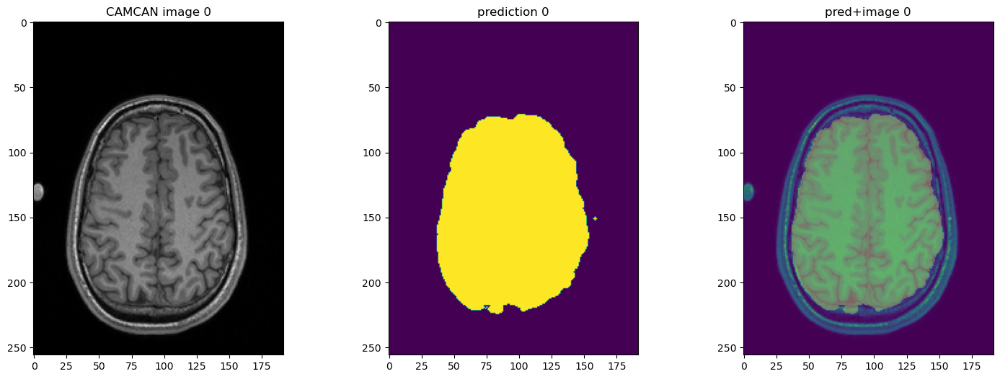

C:\Users\nehag\Data\camcan_nii\sub-CC110037_T1w.nii
(1, 256, 256, 192)


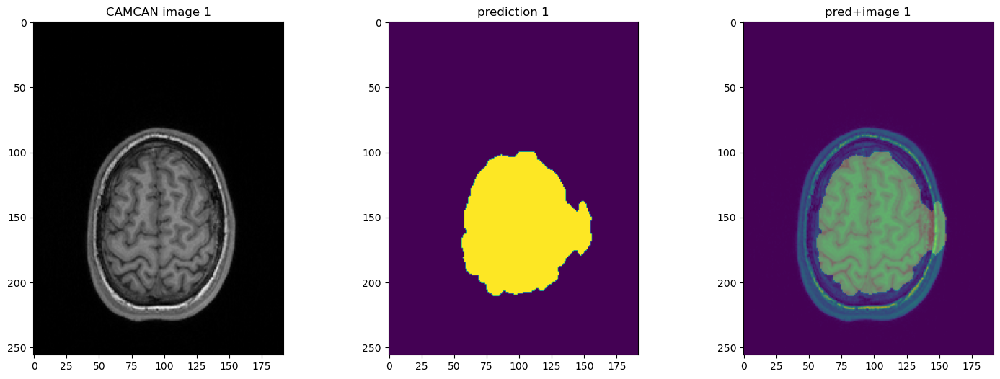

C:\Users\nehag\Data\camcan_nii\sub-CC110045_T1w.nii
(1, 256, 256, 192)


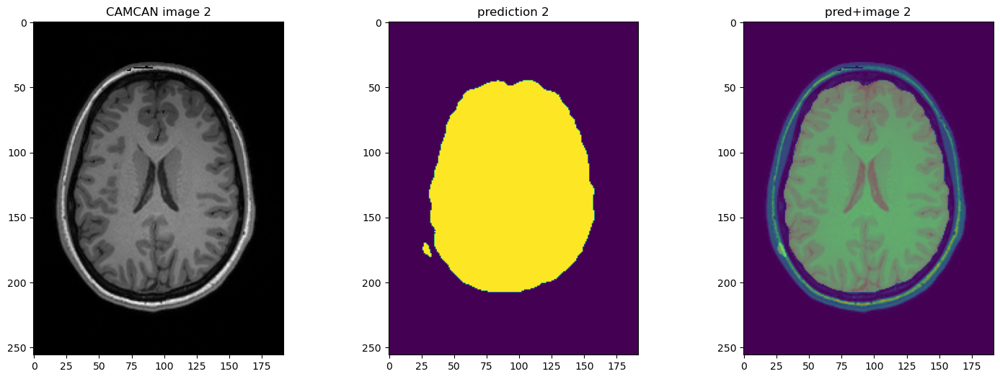

C:\Users\nehag\Data\camcan_nii\sub-CC110056_T1w.nii
(1, 256, 256, 192)


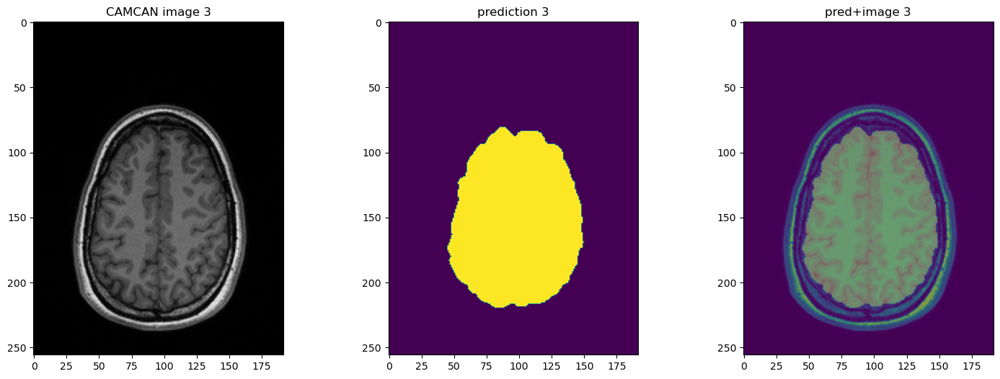

C:\Users\nehag\Data\camcan_nii\sub-CC110062_T1w.nii
(1, 256, 256, 192)


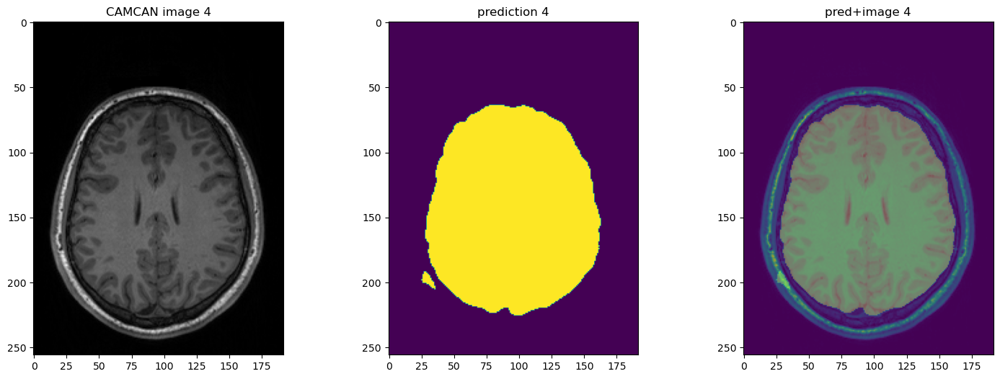

C:\Users\nehag\Data\camcan_nii\sub-CC110069_T1w.nii
(1, 256, 256, 192)


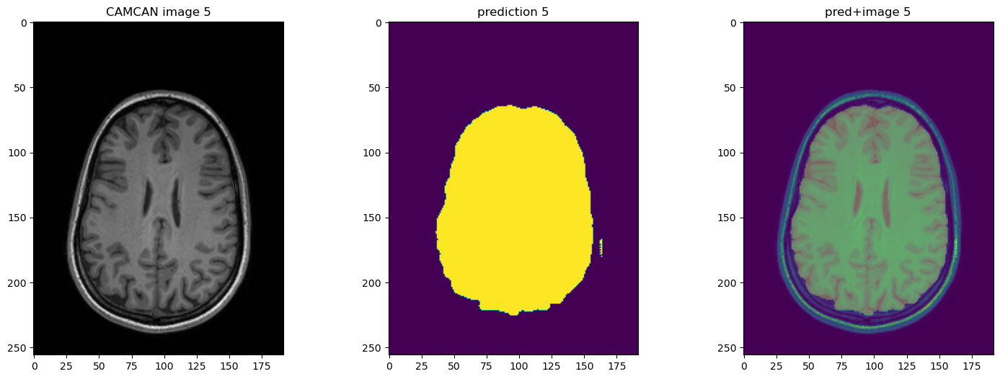

C:\Users\nehag\Data\camcan_nii\sub-CC110087_T1w.nii
(1, 256, 256, 192)


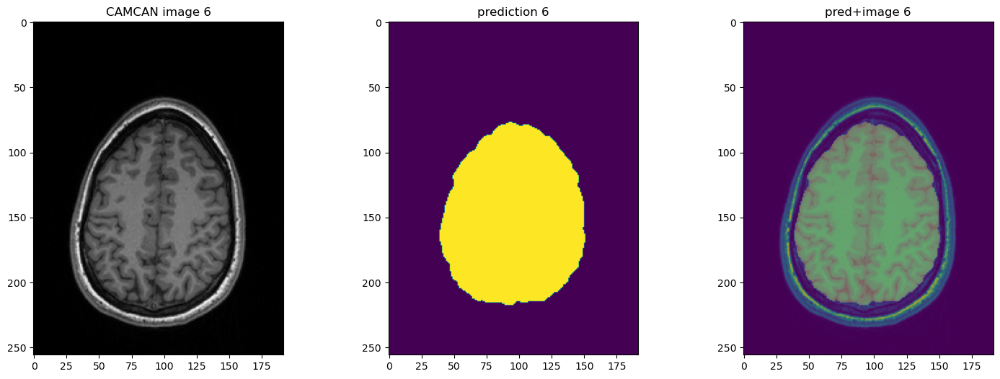

C:\Users\nehag\Data\camcan_nii\sub-CC110098_T1w.nii
(1, 256, 256, 192)


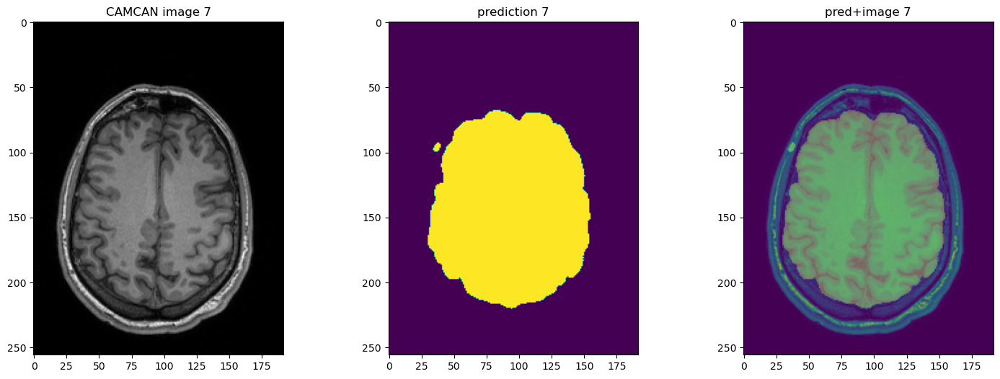

In [29]:
imgs_list_val = glob.glob(r"C:\Users\nehag\Data\camcan_nii\\*.nii")
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
for i, val_data in enumerate(val_loader):
        
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)
        
        #img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        print(val_data["img"].meta["filename_or_obj"][0])
        #output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        #save = nib.save(output, "C:\\Users\\nehag\\train_seg_results\\lightening_seg_results_100\\test\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        plt.figure("check", (18, 6))
        plt.subplot(1, 3, 1)
        plt.title(f"CAMCAN image {i}")
        plt.imshow(val_data["img"][0, 0, :, 150, :], cmap="gray")
        plt.subplot(1, 3, 2)
        plt.title(f"prediction {i}")
        plt.imshow(torch.argmax(
            val_outputs, dim=1).detach().cpu()[0, :, 150, :])
        plt.subplot(1, 3, 3)
        plt.title(f"pred+image {i}")
        plt.imshow(val_data["img"][0, 0, :, 150, :])
        plt.imshow(torch.argmax(
            val_outputs, dim=1).detach().cpu()[0, :, 150, :], alpha = 0.3)
        
        print(torch.argmax(val_outputs, dim=1).shape)
        plt.show()
        
        if i>6:
            break


##

1
0 C:\Users\nehag\NORM100_REP2_RF_T1_4.nii
(1, 256, 256, 208)


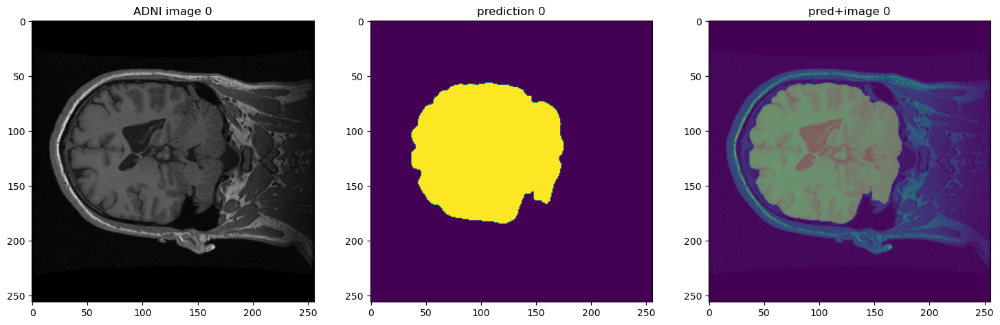

In [5]:
imgs_list_val = glob.glob(r"C:\\Users\\nehag\\*.nii")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        #output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        #save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\normative1\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"ADNI image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 120], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 120])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 120])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 120], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


1
0 C:\Users\nehag\NORM100_REP2_RF_T1_4_fsl.nii.gz
(1, 256, 208, 256)


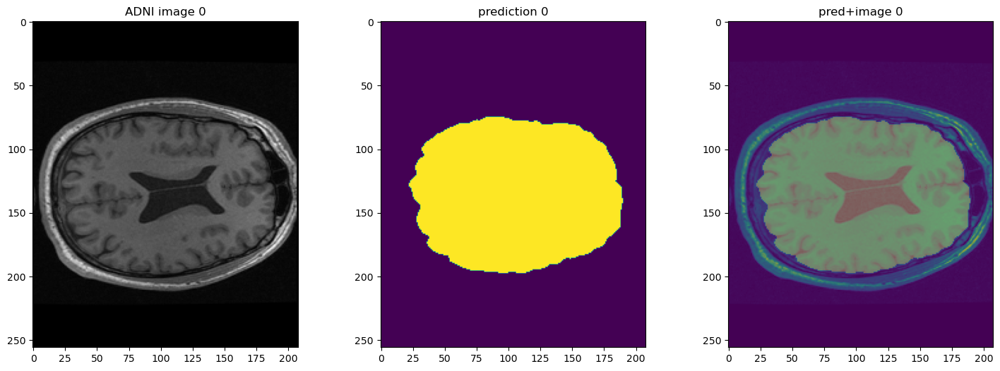

In [10]:
imgs_list_val = glob.glob(r"C:\\Users\\nehag\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        #output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        #save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\normative1\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<6:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"ADNI image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


12
0 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP11_RF_T1_3.nii
(1, 176, 256, 256)


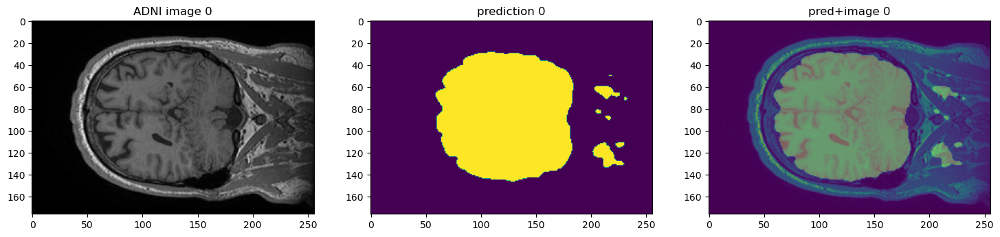

1 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP12_RF_T1_3.nii
(1, 176, 256, 256)


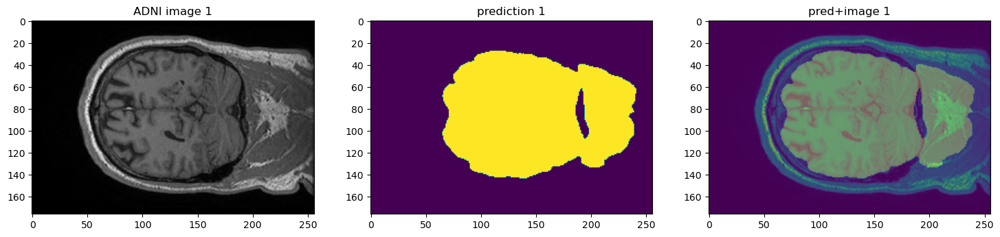

2 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP13_RF_T1_13.nii
(1, 176, 256, 256)


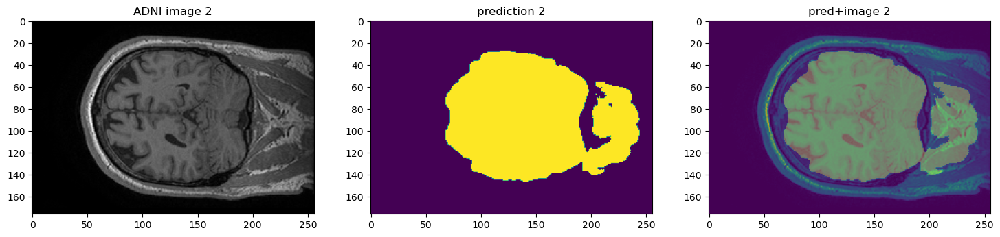

3 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP13_RF_T1_3.nii
(1, 176, 256, 256)


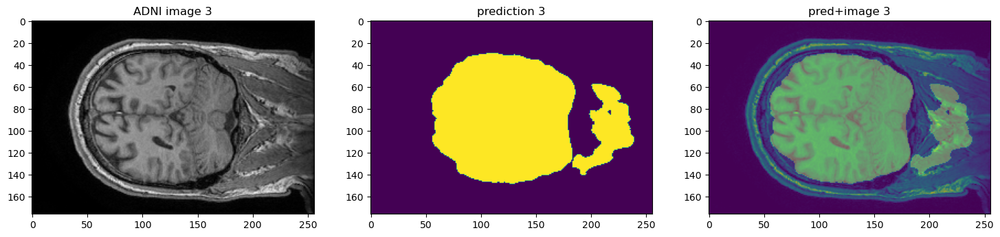

4 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP14_RF_T1_13.nii
(1, 176, 256, 256)


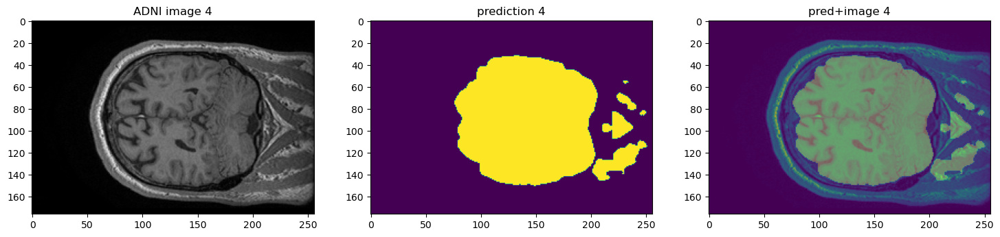

5 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP14_RF_T1_3.nii
(1, 176, 256, 256)


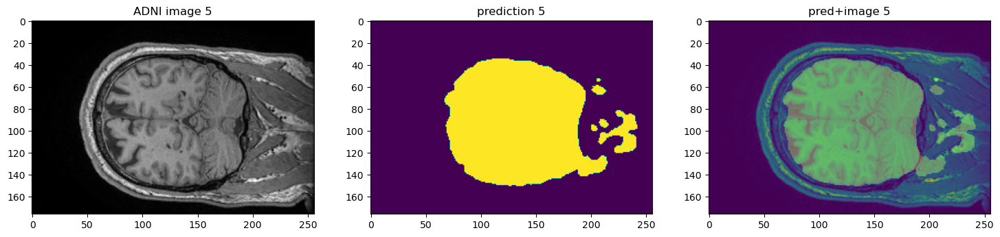

6 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP15_RF_T1_13.nii
(1, 176, 256, 256)


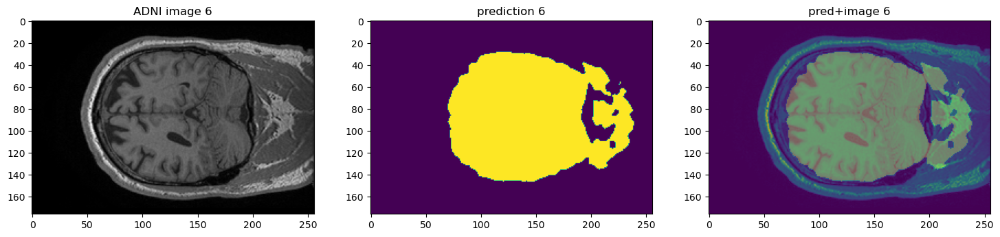

7 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP15_RF_T1_3.nii
(1, 176, 256, 256)


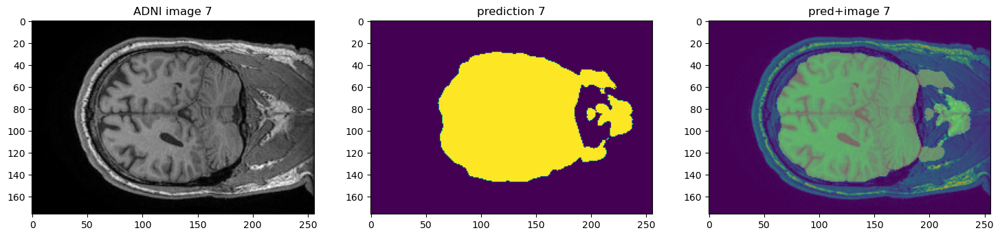

8 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP2_RF_T1_4.nii
(1, 208, 256, 256)


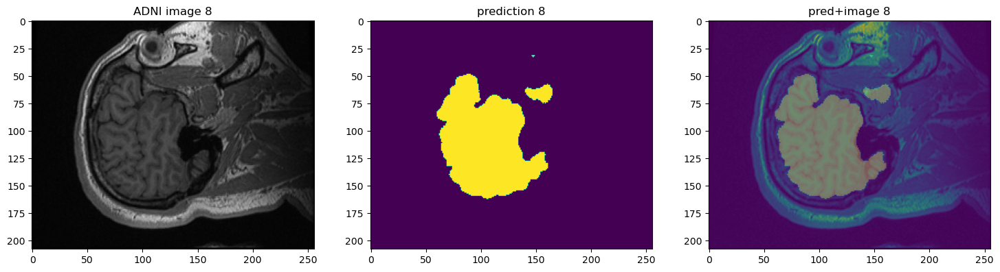

9 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP3_RF_T1_4.nii
(1, 208, 256, 256)


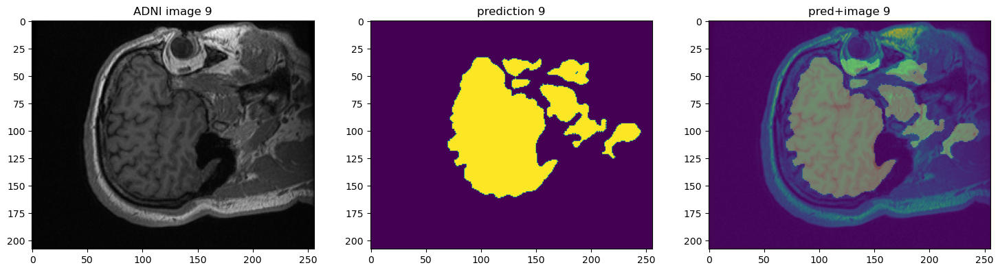

10 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP4_RF_T1_3.nii
(1, 192, 256, 256)


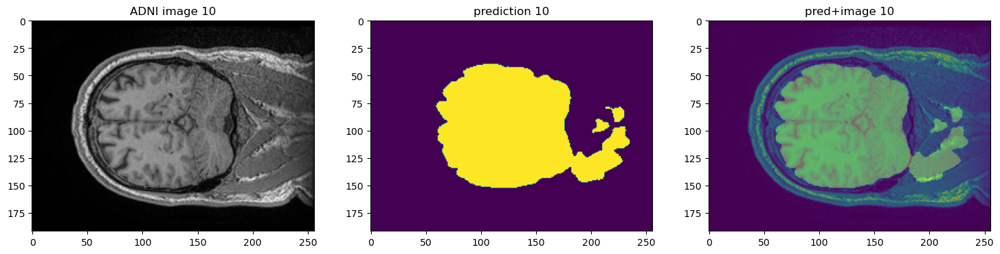

11 C:\Users\nehag\OneDrive\Desktop\normative_transposed\NORM100_REP5_RF_T1_3.nii
(1, 192, 256, 256)


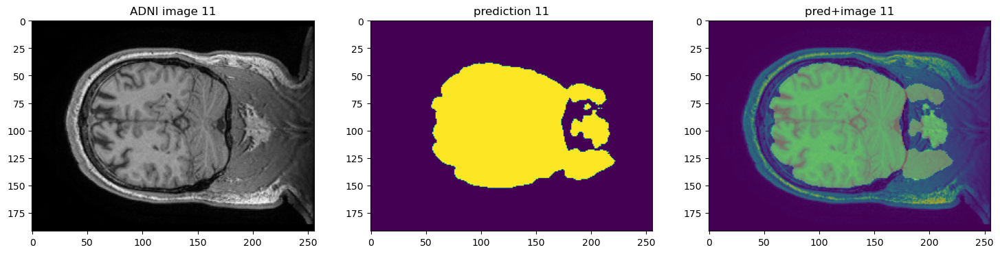

In [13]:
imgs_list_val = glob.glob(r"C:\\Users\\nehag\\OneDrive\\Desktop\\normative_transposed\\*.nii")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        #output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        #save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\normative1\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<15:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"ADNI image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


12
0 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP11_RF_T1_3.nii.gz
(1, 256, 176, 256)


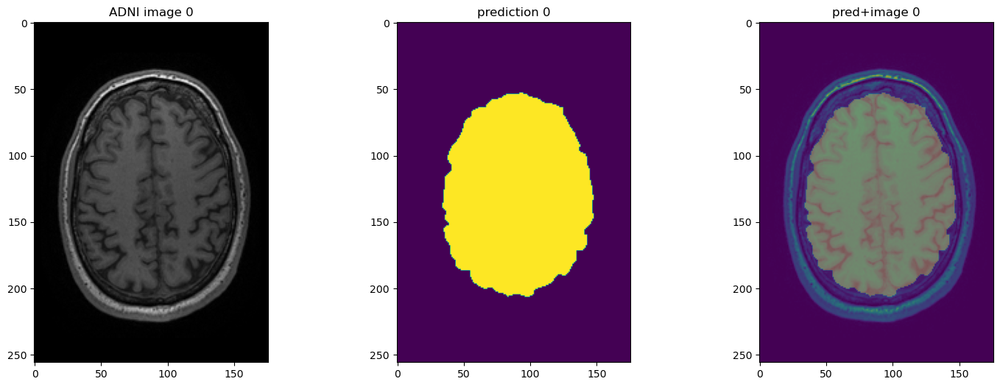

1 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP12_RF_T1_3.nii.gz
(1, 256, 176, 256)


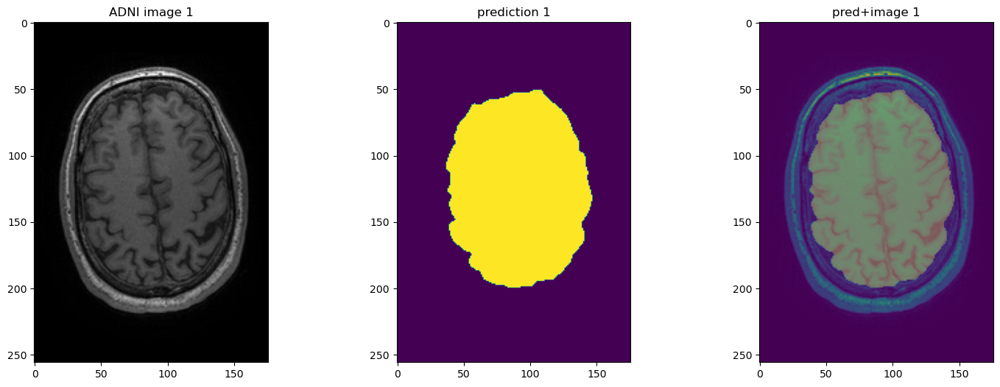

2 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP13_RF_T1_13.nii.gz
(1, 256, 176, 256)


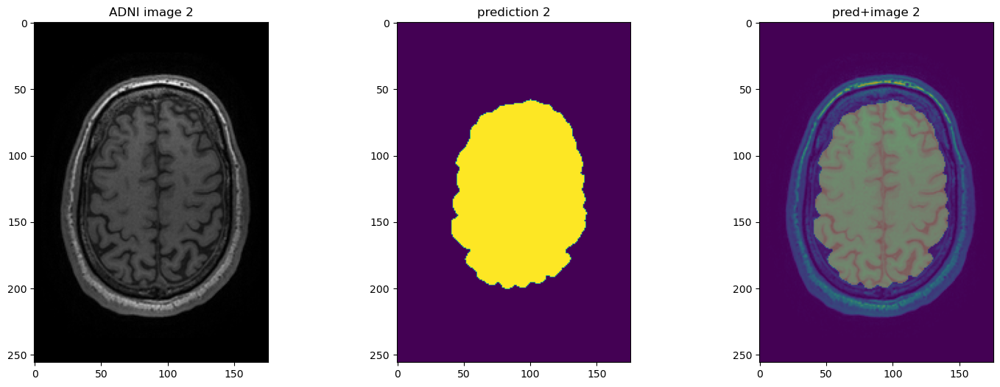

3 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP13_RF_T1_3.nii.gz
(1, 256, 176, 256)


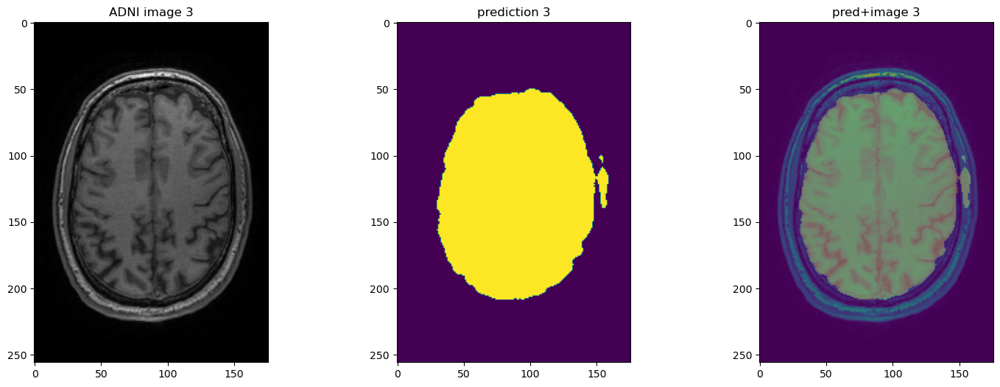

4 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP14_RF_T1_13.nii.gz
(1, 256, 176, 256)


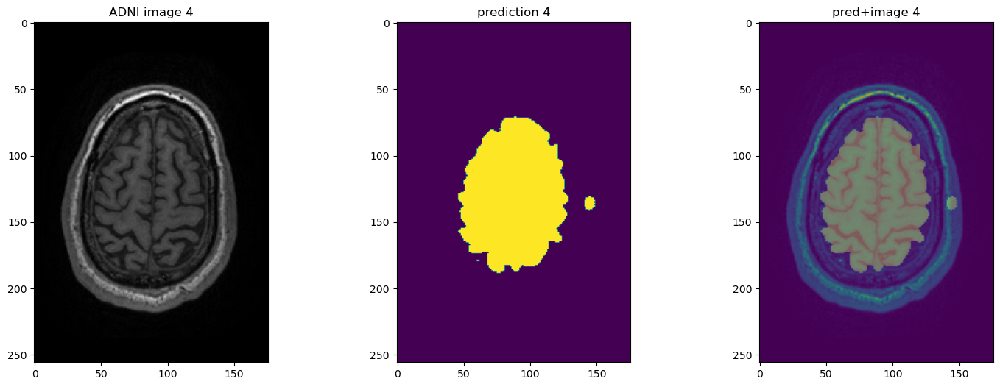

5 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP14_RF_T1_3.nii.gz
(1, 256, 176, 256)


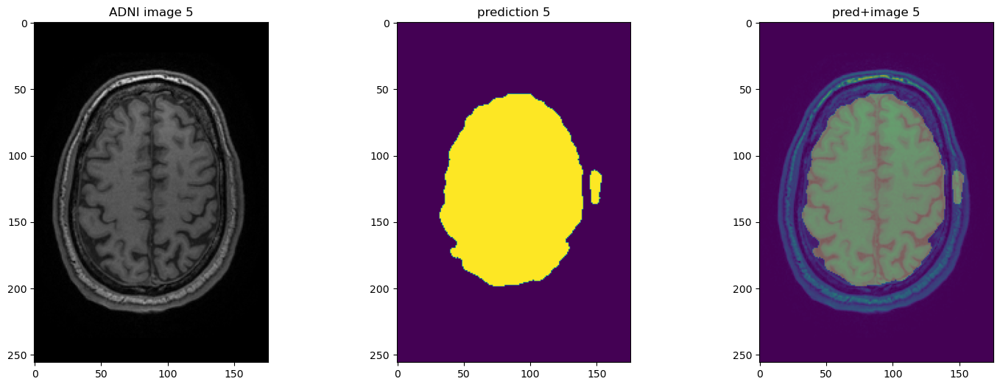

6 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP15_RF_T1_13.nii.gz
(1, 256, 176, 256)


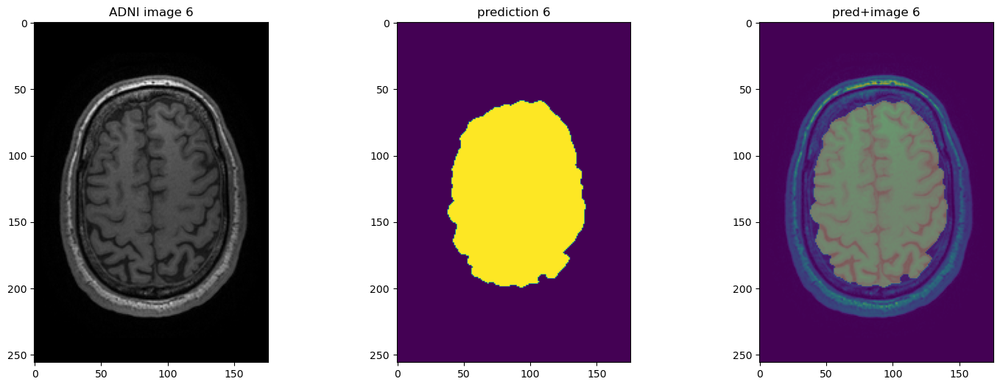

7 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP15_RF_T1_3.nii.gz
(1, 256, 176, 256)


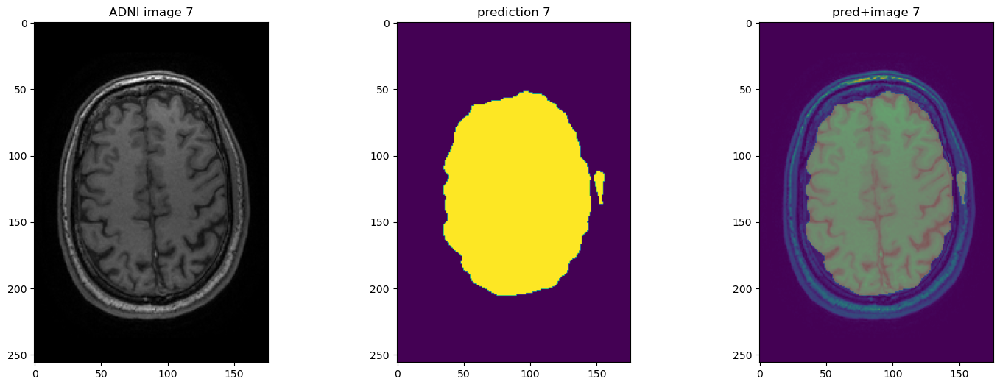

8 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP2_RF_T1_4.nii.gz
(1, 208, 256, 256)


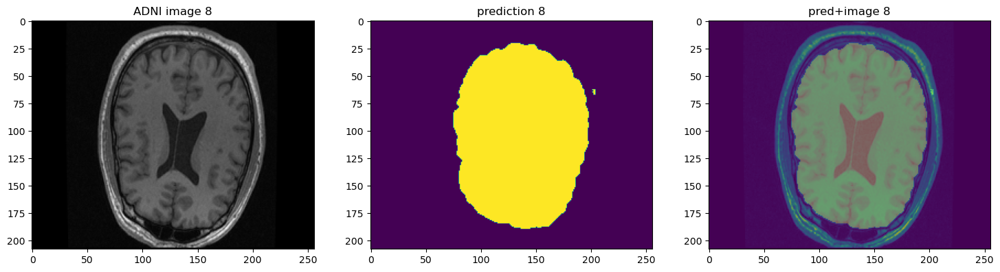

9 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP3_RF_T1_4.nii.gz
(1, 208, 256, 256)


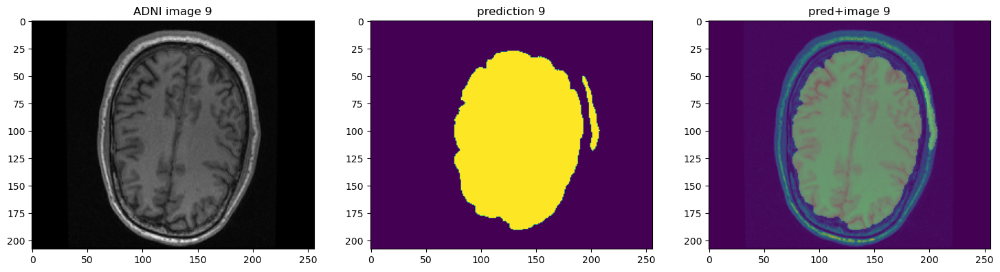

10 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP4_RF_T1_3.nii.gz
(1, 256, 192, 256)


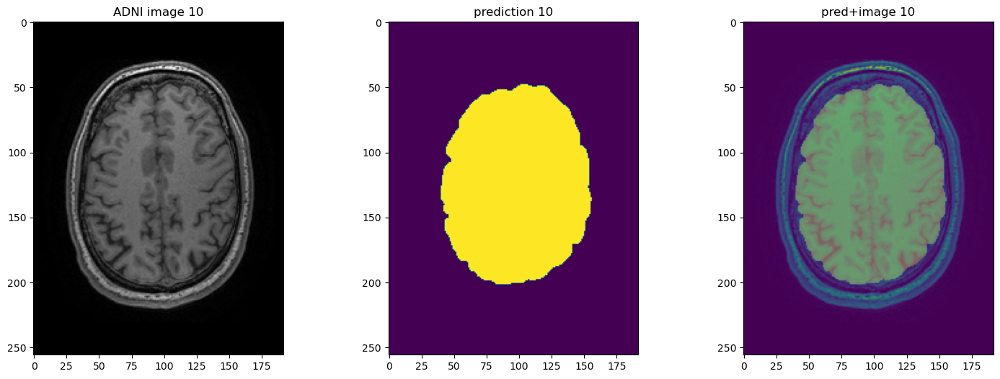

11 C:\Users\nehag\OneDrive\Desktop\normative_transposed_fsl\NORM100_REP5_RF_T1_3.nii.gz
(1, 256, 192, 256)


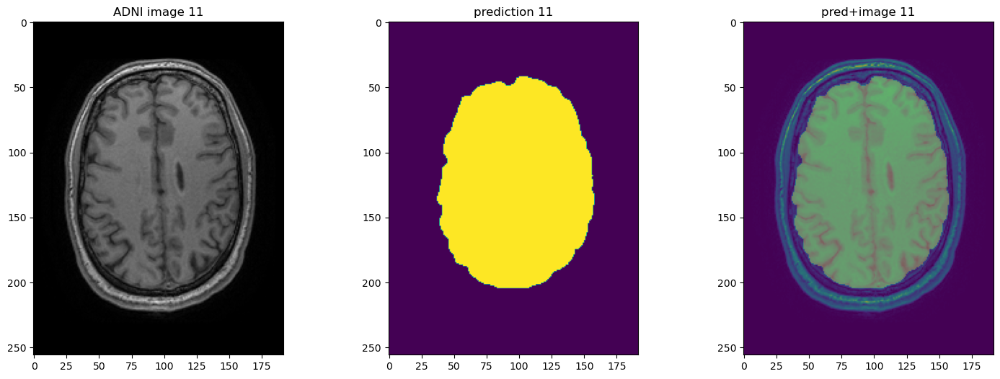

In [14]:
imgs_list_val = glob.glob(r"C:\\Users\\nehag\\OneDrive\\Desktop\\normative_transposed_fsl\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)

#avg validation score - whole set
net.eval()
metric = []
#present = glob.glob(r"C:\Users\nehag\JNotebooks\skull_stripping\binary_masks_pred\normative\*.nii")
#print(len(present))
#for i in range(len(present)):
    #present[i]=present[i].split('\\')[-1]

for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        #output = nib.Nifti1Image(torch.argmax(val_outputs, dim=1).as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        #save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\normative1\\"+name)
        #labels = val_data["label"]
        #y = labels.as_tensor()
        if i<15:
            plt.figure("check", (18, 6))
            plt.subplot(1, 3, 1)
            plt.title(f"ADNI image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170], cmap="gray")
            plt.subplot(1, 3, 2)
            plt.title(f"prediction {i}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170])
            plt.subplot(1, 3, 3)
            plt.title(f"pred+image {i}")
            plt.imshow(val_data["img"][0, 0, :, :, 170])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 170], alpha = 0.3)

            print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

        


# CC359 RESHAPED SEG MASKS

359
0 C:\Users\nehag\Data\CC359_nii_fsl\CC0001_philips_15_55_M.nii.gz


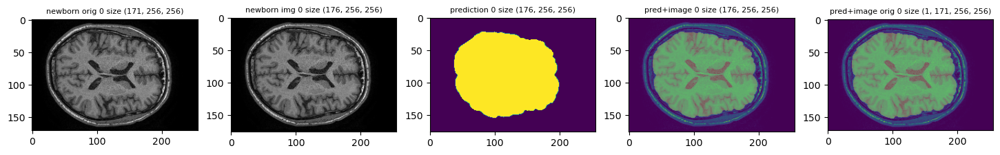

1 C:\Users\nehag\Data\CC359_nii_fsl\CC0002_philips_15_56_M.nii.gz


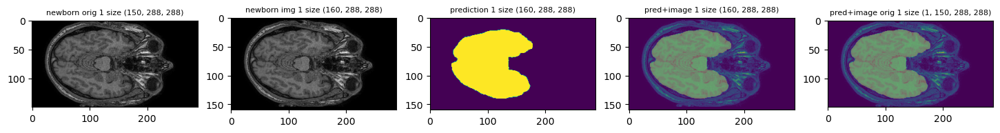

2 C:\Users\nehag\Data\CC359_nii_fsl\CC0003_philips_15_63_F.nii.gz


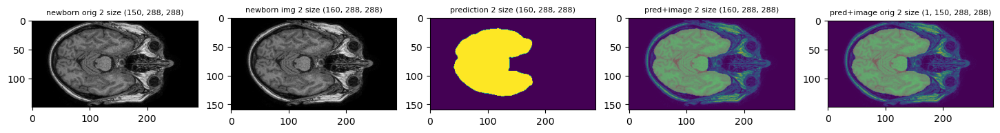

3 C:\Users\nehag\Data\CC359_nii_fsl\CC0004_philips_15_67_M.nii.gz


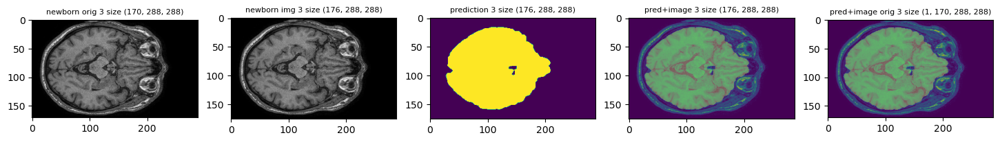

4 C:\Users\nehag\Data\CC359_nii_fsl\CC0005_philips_15_62_M.nii.gz


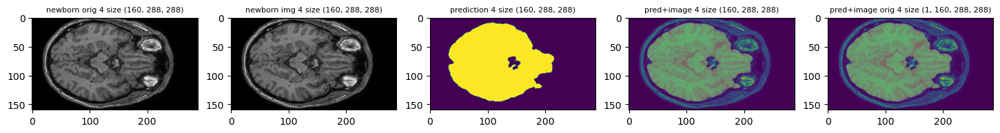

5 C:\Users\nehag\Data\CC359_nii_fsl\CC0006_philips_15_63_F.nii.gz


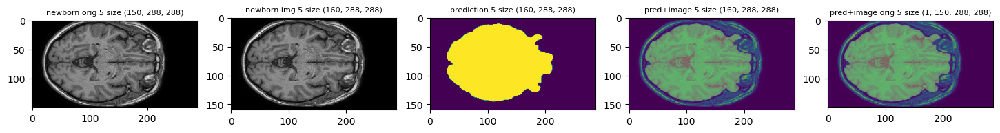

6 C:\Users\nehag\Data\CC359_nii_fsl\CC0007_philips_15_62_M.nii.gz


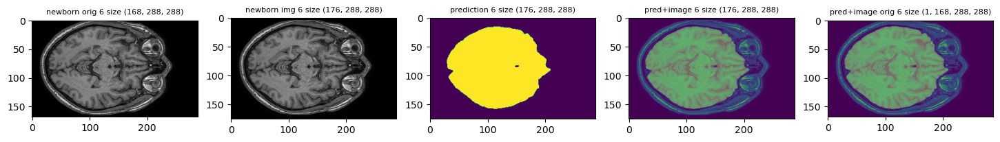

7 C:\Users\nehag\Data\CC359_nii_fsl\CC0008_philips_15_60_F.nii.gz


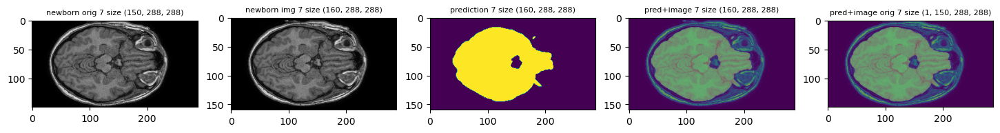

8 C:\Users\nehag\Data\CC359_nii_fsl\CC0009_philips_15_69_M.nii.gz


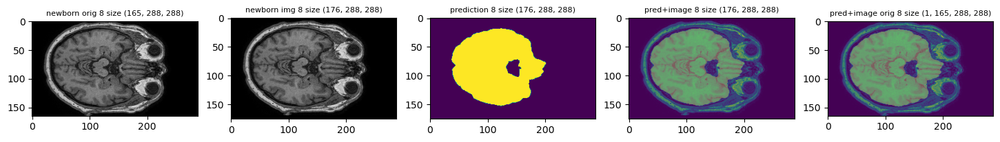

9 C:\Users\nehag\Data\CC359_nii_fsl\CC0010_philips_15_69_F.nii.gz


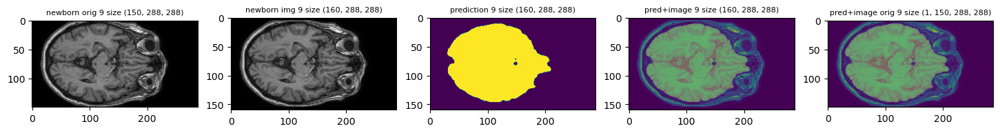

10 C:\Users\nehag\Data\CC359_nii_fsl\CC0011_philips_15_49_F.nii.gz


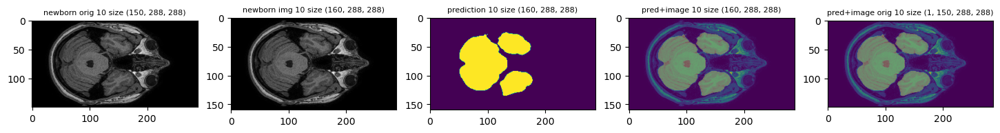

11 C:\Users\nehag\Data\CC359_nii_fsl\CC0012_philips_15_43_M.nii.gz


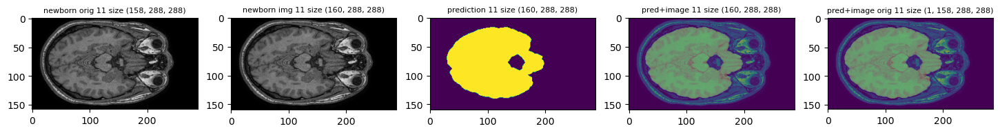

12 C:\Users\nehag\Data\CC359_nii_fsl\CC0013_philips_15_66_M.nii.gz


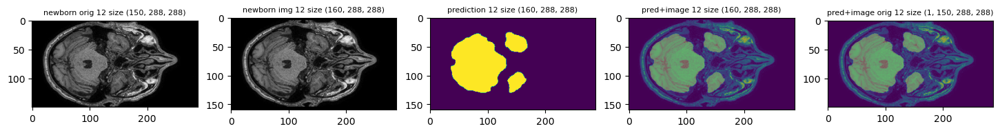

13 C:\Users\nehag\Data\CC359_nii_fsl\CC0014_philips_15_62_F.nii.gz


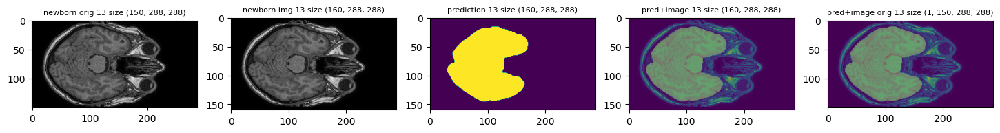

14 C:\Users\nehag\Data\CC359_nii_fsl\CC0015_philips_15_44_M.nii.gz


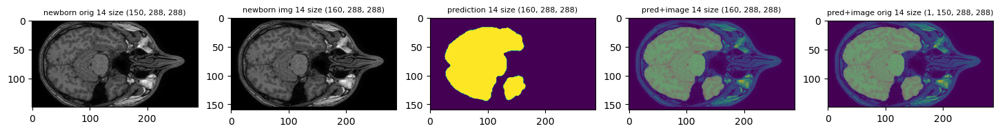

15 C:\Users\nehag\Data\CC359_nii_fsl\CC0016_philips_15_55_M.nii.gz
16 C:\Users\nehag\Data\CC359_nii_fsl\CC0017_philips_15_50_F.nii.gz
17 C:\Users\nehag\Data\CC359_nii_fsl\CC0018_philips_15_41_F.nii.gz
18 C:\Users\nehag\Data\CC359_nii_fsl\CC0019_philips_15_57_F.nii.gz
19 C:\Users\nehag\Data\CC359_nii_fsl\CC0020_philips_15_65_F.nii.gz
20 C:\Users\nehag\Data\CC359_nii_fsl\CC0021_philips_15_48_F.nii.gz
21 C:\Users\nehag\Data\CC359_nii_fsl\CC0022_philips_15_43_M.nii.gz
22 C:\Users\nehag\Data\CC359_nii_fsl\CC0023_philips_15_43_M.nii.gz
23 C:\Users\nehag\Data\CC359_nii_fsl\CC0024_philips_15_65_F.nii.gz
24 C:\Users\nehag\Data\CC359_nii_fsl\CC0025_philips_15_51_M.nii.gz
25 C:\Users\nehag\Data\CC359_nii_fsl\CC0026_philips_15_65_M.nii.gz
26 C:\Users\nehag\Data\CC359_nii_fsl\CC0027_philips_15_41_M.nii.gz
27 C:\Users\nehag\Data\CC359_nii_fsl\CC0028_philips_15_63_F.nii.gz
28 C:\Users\nehag\Data\CC359_nii_fsl\CC0029_philips_15_51_M.nii.gz
29 C:\Users\nehag\Data\CC359_nii_fsl\CC0030_philips_15_42_F.ni

138 C:\Users\nehag\Data\CC359_nii_fsl\CC0139_siemens_15_56_M.nii.gz
139 C:\Users\nehag\Data\CC359_nii_fsl\CC0140_siemens_15_57_M.nii.gz
140 C:\Users\nehag\Data\CC359_nii_fsl\CC0141_siemens_15_53_F.nii.gz
141 C:\Users\nehag\Data\CC359_nii_fsl\CC0142_siemens_15_59_M.nii.gz
142 C:\Users\nehag\Data\CC359_nii_fsl\CC0143_siemens_15_55_F.nii.gz
143 C:\Users\nehag\Data\CC359_nii_fsl\CC0144_siemens_15_43_M.nii.gz
144 C:\Users\nehag\Data\CC359_nii_fsl\CC0145_siemens_15_62_F.nii.gz
145 C:\Users\nehag\Data\CC359_nii_fsl\CC0146_siemens_15_38_M.nii.gz
146 C:\Users\nehag\Data\CC359_nii_fsl\CC0147_siemens_15_58_F.nii.gz
147 C:\Users\nehag\Data\CC359_nii_fsl\CC0148_siemens_15_58_F.nii.gz
148 C:\Users\nehag\Data\CC359_nii_fsl\CC0149_siemens_15_53_M.nii.gz
149 C:\Users\nehag\Data\CC359_nii_fsl\CC0150_siemens_15_47_M.nii.gz
150 C:\Users\nehag\Data\CC359_nii_fsl\CC0151_siemens_15_71_M.nii.gz
151 C:\Users\nehag\Data\CC359_nii_fsl\CC0152_siemens_15_51_M.nii.gz
152 C:\Users\nehag\Data\CC359_nii_fsl\CC0153_sie

261 C:\Users\nehag\Data\CC359_nii_fsl\CC0262_ge_15_54_M.nii.gz
262 C:\Users\nehag\Data\CC359_nii_fsl\CC0263_ge_15_51_M.nii.gz
263 C:\Users\nehag\Data\CC359_nii_fsl\CC0264_ge_15_59_F.nii.gz
264 C:\Users\nehag\Data\CC359_nii_fsl\CC0265_ge_15_56_F.nii.gz
265 C:\Users\nehag\Data\CC359_nii_fsl\CC0266_ge_15_57_M.nii.gz
266 C:\Users\nehag\Data\CC359_nii_fsl\CC0267_ge_15_60_F.nii.gz
267 C:\Users\nehag\Data\CC359_nii_fsl\CC0268_ge_15_57_F.nii.gz
268 C:\Users\nehag\Data\CC359_nii_fsl\CC0269_ge_15_59_M.nii.gz
269 C:\Users\nehag\Data\CC359_nii_fsl\CC0270_ge_15_59_M.nii.gz


In [ ]:
plt.rcParams['axes.titlesize'] = 8
net = Net.load_from_checkpoint(r"C:\Users\nehag\train_seg_results\skull_stripping_logs4\lightning_logs_4\version_1\checkpoints\epoch=24-step=5949.ckpt")

imgs_list_val = glob.glob(r"C:\\Users\\nehag\\Data\\CC359_nii_fsl\\*.nii.gz")
print(len(imgs_list_val))
#labels_val = glob.glob(r"C:\\Users\\nehag\\Graham\\STAPLE_brainmask_binary\\test\\*.nii.gz")
        
val_files = [{"img": x} for (x) in zip(imgs_list_val)]

test_transforms = Compose(
            [
                LoadImaged(keys=["img"]),
                #AddChanneld("img", "label"),
                EnsureChannelFirstd(keys=["img"]),
                DivisiblePadd(["img"], 16),
                #Orientationd(keys=["image", "label"], axcodes="RAS"),
                ScaleIntensityd(
                    keys=["img"],
                    minv=0.0,
                    maxv=1.0
                ),
                #RandRotated(
                #   keys=["img", "label"],
                #    range_x=np.pi / 4,
                #    prob=0.5,
                #    keep_size=True
                #)
                #RandGibbsNoised(keys=["img", "label"], prob = 0.2)
            ]
        )
val_ds = Dataset(data=val_files, transform=test_transforms)

val_loader = DataLoader(val_ds, batch_size=1, num_workers=2, collate_fn=pad_list_data_collate)
for i, val_data in enumerate(val_loader):
        
        img = nib.load(val_data["img"].meta["filename_or_obj"][0])
        name = val_data["img"].meta["filename_or_obj"][0].split('\\')[-1]
        #print(name)
        #ctr=0
        #if (name in present):
        #print(name)
            #ctr = ctr+1
                
       
        print(i, val_data["img"].meta["filename_or_obj"][0])
        net = net.cpu()
        val_outputs = net(val_data["img"])
        val_outputs = torch.softmax(val_outputs,1)



        
        #save_img = nib.save(img, "C:\\Users\\nehag\\Downloads\\Nifti\\Nifti_fsl_reshape\\"+name )
        
        #labels = val_data["label"]
        #y = labels.as_tensor()
        
        #print(val_data["img"].shape)
        #inverse
        #batch_val = first(val_loader)
        #print(batch_val["img"].shape)
        #net = net.to(device)
        batch_infer = net(val_data["img"])
        batch_infer = torch.softmax(batch_infer,1)    
        batch_infer.applied_operations = val_data["img"].applied_operations
        segs_dict = {"img": batch_infer}
        batch_inverter = BatchInverseTransform(test_transforms, val_loader, collate_fn=pad_list_data_collate)
        with allow_missing_keys_mode(test_transforms):
            fwd_bck_batch_labels = batch_inverter(segs_dict)
        
        
        orig_img_shape = img.get_fdata().shape
        img_shape = val_data["img"][0, 0, :, :, :].shape
        pred_shape = torch.argmax(val_outputs, dim=1).detach().cpu()[0, :, :, :].shape
        inverted_seg = torch.argmax(fwd_bck_batch_labels["img"], dim=1)
        inverted_shape = inverted_seg.shape
        
        output = nib.Nifti1Image(inverted_seg.as_tensor().numpy().squeeze(axis=0), img.affine, img.header)
        save = nib.save(output, "C:\\Users\\nehag\\JNotebooks\\skull_stripping\\binary_masks_pred\\CC359_resized\\"+name)
        #save_img = nib.save(img, "C:\\Users\\nehag\\Downloads\\Nifti\\Nifti_fsl_reshape\\"+name )
        if i<15:
            plt.figure("check", (18, 6))
            plt.subplot(1, 5, 1)
            plt.title(f"newborn orig {i} size {orig_img_shape}")
            plt.imshow(img.get_fdata()[:,:,130], cmap = "gray")
            plt.subplot(1, 5, 2)
            plt.title(f"newborn img {i} size {img_shape}")
            plt.imshow(val_data["img"][0, 0, :, :, 130], cmap="gray")
            plt.subplot(1, 5, 3)
            plt.title(f"prediction {i} size {pred_shape}")
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 130])
            plt.subplot(1, 5, 4)
            plt.title(f"pred+image {i} size {img_shape}")
            plt.imshow(val_data["img"][0, 0, :, :, 130])
            plt.imshow(torch.argmax(
                val_outputs, dim=1).detach().cpu()[0, :, :, 130], alpha = 0.3)
            plt.subplot(1, 5, 5)
            plt.title(f"pred+image orig {i} size {inverted_shape}")
            plt.imshow(img.get_fdata()[:,:,130])
            plt.imshow(inverted_seg[0, :, :, 130].detach().cpu(), alpha = 0.3)

            #print(torch.argmax(val_outputs, dim=1).shape)
            plt.show()
           

In [6]:
val_data["img"].applied_operations

[[{class: 'DivisiblePad',
   id: 2518839077824,
   orig_size: (171, 256, 256),
   extra_info: {'padded': [(0, 0), (2, 3), (0, 0), (0, 0)]}}]]